In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
import random

Reading the data

In [2]:
train = pd.read_csv('train_1.csv')
train.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2016-12-22,2016-12-23,2016-12-24,2016-12-25,2016-12-26,2016-12-27,2016-12-28,2016-12-29,2016-12-30,2016-12-31
0,2NE1_zh.wikipedia.org_all-access_spider,18.0,11.0,5.0,13.0,14.0,9.0,9.0,22.0,26.0,...,32.0,63.0,15.0,26.0,14.0,20.0,22.0,19.0,18.0,20.0
1,2PM_zh.wikipedia.org_all-access_spider,11.0,14.0,15.0,18.0,11.0,13.0,22.0,11.0,10.0,...,17.0,42.0,28.0,15.0,9.0,30.0,52.0,45.0,26.0,20.0
2,3C_zh.wikipedia.org_all-access_spider,1.0,0.0,1.0,1.0,0.0,4.0,0.0,3.0,4.0,...,3.0,1.0,1.0,7.0,4.0,4.0,6.0,3.0,4.0,17.0
3,4minute_zh.wikipedia.org_all-access_spider,35.0,13.0,10.0,94.0,4.0,26.0,14.0,9.0,11.0,...,32.0,10.0,26.0,27.0,16.0,11.0,17.0,19.0,10.0,11.0
4,52_Hz_I_Love_You_zh.wikipedia.org_all-access_s...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,48.0,9.0,25.0,13.0,3.0,11.0,27.0,13.0,36.0,10.0


Duplicate and Missing data 

In [3]:
# Checking if any page is duplicated
print("Number of duplicated data :" , format(sum(train['Page'].duplicated())))

Number of duplicated data : 0


In [4]:
# Missing data
missing = train.isnull().sum(axis=1)
missing_value_df = pd.DataFrame({'Index_no': train.index,
                                'missing': missing})
missing_value_df

,Index_no,missing
0,0,0
1,1,0
2,2,0
3,3,0
4,4,291
...,...,...
145058,145058,544
145059,145059,550
145060,145060,550
145061,145061,550


In [5]:
'''
For calculation of the popularity I am filling the NA values with 0 
'''
raw_train=train.iloc[:,:].copy()
raw_train.loc[:,raw_train.columns!='Page']=raw_train.loc[:,raw_train.columns!='Page'].fillna(0)
raw_train.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2016-12-22,2016-12-23,2016-12-24,2016-12-25,2016-12-26,2016-12-27,2016-12-28,2016-12-29,2016-12-30,2016-12-31
0,2NE1_zh.wikipedia.org_all-access_spider,18.0,11.0,5.0,13.0,14.0,9.0,9.0,22.0,26.0,...,32.0,63.0,15.0,26.0,14.0,20.0,22.0,19.0,18.0,20.0
1,2PM_zh.wikipedia.org_all-access_spider,11.0,14.0,15.0,18.0,11.0,13.0,22.0,11.0,10.0,...,17.0,42.0,28.0,15.0,9.0,30.0,52.0,45.0,26.0,20.0
2,3C_zh.wikipedia.org_all-access_spider,1.0,0.0,1.0,1.0,0.0,4.0,0.0,3.0,4.0,...,3.0,1.0,1.0,7.0,4.0,4.0,6.0,3.0,4.0,17.0
3,4minute_zh.wikipedia.org_all-access_spider,35.0,13.0,10.0,94.0,4.0,26.0,14.0,9.0,11.0,...,32.0,10.0,26.0,27.0,16.0,11.0,17.0,19.0,10.0,11.0
4,52_Hz_I_Love_You_zh.wikipedia.org_all-access_s...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,48.0,9.0,25.0,13.0,3.0,11.0,27.0,13.0,36.0,10.0


In [6]:
'''

For the imputed data the NA values are filled using forward linear interpolation. 
The remaining missing values will give us an idea on the number of days the website was active. If the website is inactive for a 
day then there will be no traffic value for that day .
'''
inp_train=train.iloc[:,:].copy()
inp_train.iloc[:,1:]=inp_train.iloc[:,1:].interpolate(method='linear',axis=1,limit_direction='forward')


In [7]:
# Missing data after linear interpolation , this value will be used in the calculation of the active days of the website
missing = inp_train.isnull().sum(axis=1)
missing_value_df = pd.DataFrame({'Index_no': train.index,
                                'missing': missing})
missing_value_df

,Index_no,missing
0,0,0
1,1,0
2,2,0
3,3,0
4,4,291
...,...,...
145058,145058,544
145059,145059,550
145060,145060,550
145061,145061,550


In [8]:
# Filling these values with 0 .This is the imputed data.
inp_train.loc[:,inp_train.columns!='Page']=inp_train.loc[:,inp_train.columns!='Page'].fillna(0)

inp_train.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2016-12-22,2016-12-23,2016-12-24,2016-12-25,2016-12-26,2016-12-27,2016-12-28,2016-12-29,2016-12-30,2016-12-31
0,2NE1_zh.wikipedia.org_all-access_spider,18.0,11.0,5.0,13.0,14.0,9.0,9.0,22.0,26.0,...,32.0,63.0,15.0,26.0,14.0,20.0,22.0,19.0,18.0,20.0
1,2PM_zh.wikipedia.org_all-access_spider,11.0,14.0,15.0,18.0,11.0,13.0,22.0,11.0,10.0,...,17.0,42.0,28.0,15.0,9.0,30.0,52.0,45.0,26.0,20.0
2,3C_zh.wikipedia.org_all-access_spider,1.0,0.0,1.0,1.0,0.0,4.0,0.0,3.0,4.0,...,3.0,1.0,1.0,7.0,4.0,4.0,6.0,3.0,4.0,17.0
3,4minute_zh.wikipedia.org_all-access_spider,35.0,13.0,10.0,94.0,4.0,26.0,14.0,9.0,11.0,...,32.0,10.0,26.0,27.0,16.0,11.0,17.0,19.0,10.0,11.0
4,52_Hz_I_Love_You_zh.wikipedia.org_all-access_s...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,48.0,9.0,25.0,13.0,3.0,11.0,27.0,13.0,36.0,10.0


#### List of dates in the train data

In [9]:
'''
datelist is created from column names by converting it to datetime format
'''

from datetime import datetime
date_list=[]
for i in train.columns[1:]:
    date_list.append(datetime.strptime(i, '%Y-%m-%d'))
    


#### Weekday , Weekend and Month for each date

In [10]:
'''
Weekday is calculated using datelist ,weekend is calculated as 1 for weekend days and 0 
for weekdays.
Month is also calculated from datelist .Other features like month_start, month_end , quarter_start , quarter_end etc 
are created using this datelist.
'''
weekday=[]
for i in date_list:
    weekday.append(i.weekday())
weekday=pd.Series(weekday)
weekend=[]
for i in weekday:
    if i in range(5):
        weekend.append(0)
    else:
        weekend.append(1)
weekend=pd.Series(weekend)
month=[]
for i in date_list:
    month.append(i.month)
month=pd.Series(month)

month_start=[]
month_start=pd.Series(date_list).dt.is_month_start

month_end=[]
month_end=pd.Series(date_list).dt.is_month_end

quarter_start=[]
quarter_start=pd.Series(date_list).dt.is_quarter_start

quarter_end=[]
quarter_end=pd.Series(date_list).dt.is_quarter_end

week=[]
week=pd.Series(date_list).dt.week


quarter=[]
quarter=pd.Series(date_list).dt.quarter


days_in_month=[]
days_in_month =pd.Series(date_list).dt.days_in_month

year=[]
year=pd.Series(date_list).dt.year


In [11]:
## Features for EDA
feat_for_eda=pd.DataFrame()


#### Dividing the dataset based on languages of the pages

In [12]:
## Language is calculated from page name. The dataframes are stored in a dictionary
def lang(page):
    index=re.search('[a-z][a-z].wikipedia.org',page)
   
    if(index):
        return (index[0][0:2])
    else:
        return('na')
feat_for_eda['Lang']=train['Page'].apply(lang)
lang_df={}

for i in feat_for_eda['Lang'].unique():
    lang_df[i]=inp_train.loc[feat_for_eda['Lang']==i]


In [13]:
lang_mean={}
for key in lang_df:
    lang_mean[key]=lang_df[key].iloc[:,1:].mean().reset_index(drop=True)
lang_mean

{'zh': 0      240.582042
 1      240.971125
 2      239.358622
 3      241.667788
 4      257.791433
           ...    
 545    376.407056
 546    378.437218
 547    351.107406
 548    355.091416
 549    365.967787
 Length: 550, dtype: float64,
 'fr': 0      475.150994
 1      478.203960
 2      459.840994
 3      491.515491
 4      482.563026
           ...    
 545    858.425226
 546    774.165515
 547    752.725668
 548    700.745178
 549    646.271543
 Length: 550, dtype: float64,
 'en': 0      3513.862203
 1      3502.540258
 2      3325.387138
 3      3462.089869
 4      3575.560857
           ...     
 545    6050.637316
 546    5870.194673
 547    6255.093361
 548    5211.760603
 549    5137.844574
 Length: 550, dtype: float64,
 'na': 0       83.479922
 1       87.523883
 2       82.722546
 3       70.632746
 4       78.278474
           ...    
 545    161.377162
 546    200.461551
 547    161.331865
 548    178.925673
 549    158.000672
 Length: 550, dtype: float64,
 'ru': 0 

#### Dividing the dataset based on agent of the pages

In [14]:
## Agent is also calculated from page name.
def agent(page):
    index=re.search('spider',page)
   
    if(index):
        return (1)
    else:
        return(0)
feat_for_eda['Agent']=train['Page'].apply(agent)

In [15]:
agent_df={}
agent_df['spider']=train.loc[feat_for_eda['Agent']==1].iloc[:,:]
agent_df['non_spider']=train.loc[feat_for_eda['Agent']==0].iloc[:,:]



#### Dividing the dataset based on access type of the pages

In [16]:
def access(page):
    all_access=re.search('all-access',page)
    desktop=re.search('desktop',page)   
    mobile=re.search('mobile-web',page)
    if(all_access):    
        return (0)
    elif(desktop):
        return(1)
    else:
        return(2)
feat_for_eda['Access']=train['Page'].apply(access)


In [17]:
access_df={}
for i in feat_for_eda['Access'].unique():
    if i == 0:
        access_df['All-Access']=train.loc[feat_for_eda['Access']==i].iloc[:,:]
    elif i == 1:
        access_df['Desktop']=train.loc[feat_for_eda['Access']==i].iloc[:,:]
    elif i ==2:
        access_df['Mobile']=train.loc[feat_for_eda['Access']==i].iloc[:,:]
        


#### Active days for each page

In [18]:
#Calculated by subtracting the missing value days after interpolation from total number of days.
feat_for_eda['Days_active']= train.shape[1]-1-missing

In [19]:
'''
View Percentage is calculated by dividing the total traffic for each page by the number of active days for that page.
'''
# View Percentage calculated from raw data
data_values=raw_train.iloc[:,1:train.shape[1]]
raw=pd.DataFrame()
raw['viewperc']=data_values.sum(axis=1)/feat_for_eda['Days_active']
raw=raw.fillna(0)
# View Percentage calculated from imputed data
data_values=inp_train.iloc[:,1:train.shape[1]]
imp=pd.DataFrame()
#total_hit=data_values.values.sum()
imp['viewperc']=data_values.sum(axis=1)/feat_for_eda['Days_active']
imp=imp.fillna(0)


In [20]:
# Raw data along with features for eda
eda_train_raw=pd.concat([train,feat_for_eda,raw],axis=1)
eda_train_raw=eda_train_raw.sort_values(by='viewperc',ascending=False)

#transforming the data using log function (log(1+x))
eda_log_raw=eda_train_raw.iloc[:,:].copy()
eda_log_raw.iloc[:,1:train.shape[1]]=raw_train.iloc[:,1:train.shape[1]].apply(np.log1p)
# Imputed data along with features for eda
eda_train_imp=pd.concat([inp_train,feat_for_eda,imp],axis=1)
eda_train_imp=eda_train_imp.sort_values(by='viewperc',ascending=False)

#transforming the data using log function (log(1+x))
eda_log_imp=eda_train_imp.iloc[:,:].copy()
eda_log_imp.iloc[:,1:train.shape[1]]=inp_train.iloc[:,1:train.shape[1]].apply(np.log1p)


In [21]:
eda_train_raw.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2016-12-27,2016-12-28,2016-12-29,2016-12-30,2016-12-31,Lang,Agent,Access,Days_active,viewperc
38573,Main_Page_en.wikipedia.org_all-access_all-agents,20381245.0,20752194.0,19573967.0,20439645.0,20772109.0,22544669.0,21210887.0,19107911.0,19993848.0,...,26916991.0,27025053.0,26073819.0,24363967.0,26149541.0,en,0,0,550,2.193851e+07
9774,Main_Page_en.wikipedia.org_desktop_all-agents,11952559.0,12344021.0,11195848.0,11982470.0,12379684.0,14164829.0,12917172.0,11089923.0,12067334.0,...,20065005.0,19751910.0,19211634.0,17100925.0,19591761.0,en,0,1,550,1.595363e+07
74114,Main_Page_en.wikipedia.org_mobile-web_all-agents,8039732.0,8018607.0,7980511.0,8024814.0,7929962.0,7959839.0,7892357.0,7607871.0,7515302.0,...,4097335.0,4168668.0,4100929.0,4118692.0,3939419.0,en,0,2,550,5.734518e+06
139119,Wikipedia:Hauptseite_de.wikipedia.org_all-acce...,2983623.0,2965848.0,2900702.0,2687450.0,2827409.0,3062343.0,2999196.0,2995270.0,2995810.0,...,3907598.0,3732014.0,3577128.0,3514084.0,3286214.0,de,0,0,550,2.916244e+06
39180,Special:Search_en.wikipedia.org_all-access_all...,2034850.0,1984412.0,1763117.0,1620136.0,1766701.0,2108408.0,2118720.0,2052391.0,2300186.0,...,1902057.0,1816849.0,1895763.0,1811624.0,1576945.0,en,0,0,550,2.371053e+06


In [22]:
eda_log_raw.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2016-12-27,2016-12-28,2016-12-29,2016-12-30,2016-12-31,Lang,Agent,Access,Days_active,viewperc
38573,Main_Page_en.wikipedia.org_all-access_all-agents,16.830126,16.848163,16.789711,16.832987,16.849122,16.931009,16.870025,16.765613,16.810935,...,17.108268,17.112275,17.076442,17.008616,17.079342,en,0,0,550,2.193851e+07
9774,Main_Page_en.wikipedia.org_desktop_all-agents,16.296456,16.328682,16.231054,16.298955,16.331567,16.466273,16.374068,16.221548,16.306013,...,16.814488,16.798761,16.771027,16.654643,16.790620,en,0,1,550,1.595363e+07
74114,Main_Page_en.wikipedia.org_mobile-web_all-agents,15.899906,15.897275,15.892513,15.898049,15.886159,15.889919,15.881406,15.844694,15.832452,...,15.225848,15.243107,15.226724,15.231046,15.186544,en,0,2,550,5.734518e+06
139119,Wikipedia:Hauptseite_de.wikipedia.org_all-acce...,14.908649,14.902674,14.880464,14.804104,14.854872,14.934691,14.913855,14.912545,14.912726,...,15.178434,15.132459,15.090071,15.072290,15.005247,de,0,0,550,2.916244e+06
39180,Special:Search_en.wikipedia.org_all-access_all...,14.525933,14.500834,14.382594,14.298021,14.384625,14.561444,14.566323,14.534517,14.648501,...,14.458447,14.412615,14.455132,14.409735,14.271001,en,0,0,550,2.371053e+06


In [23]:
eda_train_imp.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2016-12-27,2016-12-28,2016-12-29,2016-12-30,2016-12-31,Lang,Agent,Access,Days_active,viewperc
38573,Main_Page_en.wikipedia.org_all-access_all-agents,20381245.0,20752194.0,19573967.0,20439645.0,20772109.0,22544669.0,21210887.0,19107911.0,19993848.0,...,26916991.0,27025053.0,26073819.0,24363967.0,26149541.0,en,0,0,550,2.193851e+07
9774,Main_Page_en.wikipedia.org_desktop_all-agents,11952559.0,12344021.0,11195848.0,11982470.0,12379684.0,14164829.0,12917172.0,11089923.0,12067334.0,...,20065005.0,19751910.0,19211634.0,17100925.0,19591761.0,en,0,1,550,1.595363e+07
74114,Main_Page_en.wikipedia.org_mobile-web_all-agents,8039732.0,8018607.0,7980511.0,8024814.0,7929962.0,7959839.0,7892357.0,7607871.0,7515302.0,...,4097335.0,4168668.0,4100929.0,4118692.0,3939419.0,en,0,2,550,5.734518e+06
139119,Wikipedia:Hauptseite_de.wikipedia.org_all-acce...,2983623.0,2965848.0,2900702.0,2687450.0,2827409.0,3062343.0,2999196.0,2995270.0,2995810.0,...,3907598.0,3732014.0,3577128.0,3514084.0,3286214.0,de,0,0,550,2.916244e+06
39180,Special:Search_en.wikipedia.org_all-access_all...,2034850.0,1984412.0,1763117.0,1620136.0,1766701.0,2108408.0,2118720.0,2052391.0,2300186.0,...,1902057.0,1816849.0,1895763.0,1811624.0,1576945.0,en,0,0,550,2.371053e+06


In [24]:
eda_log_imp

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2016-12-27,2016-12-28,2016-12-29,2016-12-30,2016-12-31,Lang,Agent,Access,Days_active,viewperc
38573,Main_Page_en.wikipedia.org_all-access_all-agents,16.830126,16.848163,16.789711,16.832987,16.849122,16.931009,16.870025,16.765613,16.810935,...,17.108268,17.112275,17.076442,17.008616,17.079342,en,0,0,550,2.193851e+07
9774,Main_Page_en.wikipedia.org_desktop_all-agents,16.296456,16.328682,16.231054,16.298955,16.331567,16.466273,16.374068,16.221548,16.306013,...,16.814488,16.798761,16.771027,16.654643,16.790620,en,0,1,550,1.595363e+07
74114,Main_Page_en.wikipedia.org_mobile-web_all-agents,15.899906,15.897275,15.892513,15.898049,15.886159,15.889919,15.881406,15.844694,15.832452,...,15.225848,15.243107,15.226724,15.231046,15.186544,en,0,2,550,5.734518e+06
139119,Wikipedia:Hauptseite_de.wikipedia.org_all-acce...,14.908649,14.902674,14.880464,14.804104,14.854872,14.934691,14.913855,14.912545,14.912726,...,15.178434,15.132459,15.090071,15.072290,15.005247,de,0,0,550,2.916244e+06
39180,Special:Search_en.wikipedia.org_all-access_all...,14.525933,14.500834,14.382594,14.298021,14.384625,14.561444,14.566323,14.534517,14.648501,...,14.458447,14.412615,14.455132,14.409735,14.271001,en,0,0,550,2.371053e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84651,User:142.54.183.124_www.mediawiki.org_all-acce...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,na,1,0,60,0.000000e+00
84650,User:142.54.183.123_www.mediawiki.org_all-acce...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,na,1,0,62,0.000000e+00
84649,User:142.54.183.122_www.mediawiki.org_all-acce...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,na,1,0,63,0.000000e+00
84643,Topic:Tijl4t8rdq7c8e7v_www.mediawiki.org_all-a...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,na,1,0,0,0.000000e+00


In [25]:
#Extracting the pages with view percentage greater than 0.
eda_raw_pop=eda_train_raw.loc[eda_train_raw['viewperc']>0]
eda_imp_pop=eda_train_imp.loc[eda_train_imp['viewperc']>0]



In [26]:
# Get the last 15 pages with least view percentage greater than 0.
last_15_raw=eda_raw_pop.iloc[-15:,:] 
last_15_imp=eda_imp_pop.iloc[-15:,:]

In [27]:
last_15_imp.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2016-12-27,2016-12-28,2016-12-29,2016-12-30,2016-12-31,Lang,Agent,Access,Days_active,viewperc
15650,File:Jeks.jpg_commons.wikimedia.org_all-access...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,na,1,0,505,0.045545
34607,User:GoogleAnalitycsRoman/google-api_en.wikipe...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,en,1,0,550,0.045455
84658,User:93.188.39.246_www.mediawiki.org_all-acces...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,na,1,0,388,0.034794
79983,File:Istanbul_intc.jpg_commons.wikimedia.org_m...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,na,0,2,550,0.034545
84038,File:Plumbers_In_Dublin.jpg_www.mediawiki.org_...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,na,1,0,259,0.030888


## Exploratory Data Analysis 
### Univariate Analysis

#### Plotting the average pagehit with different parameters like weekdays , weekends , months.

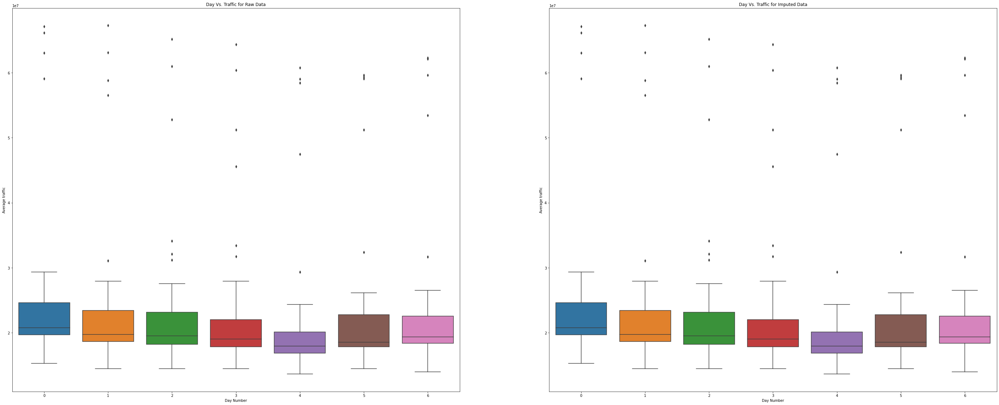

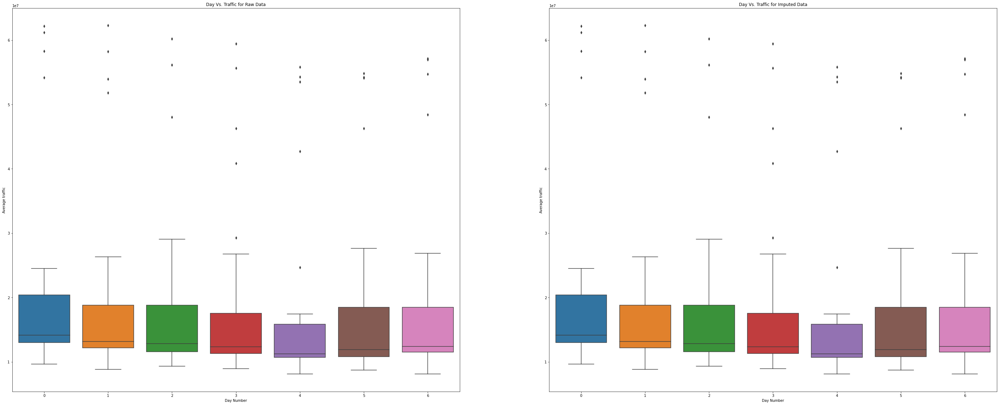

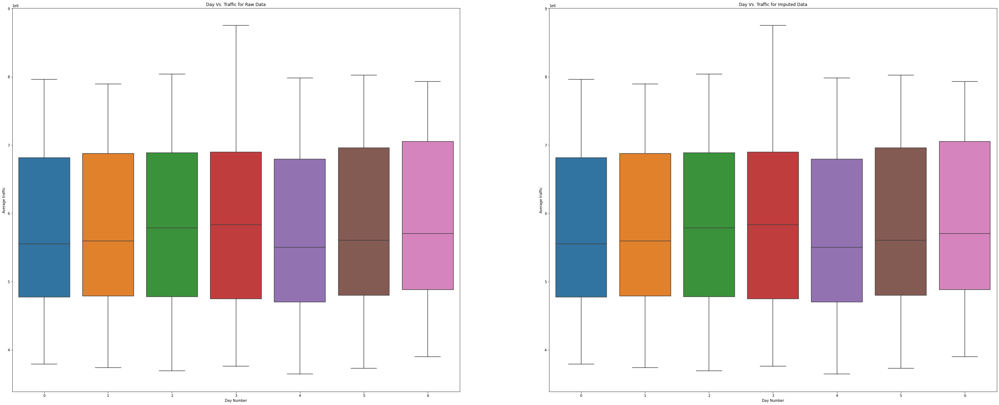

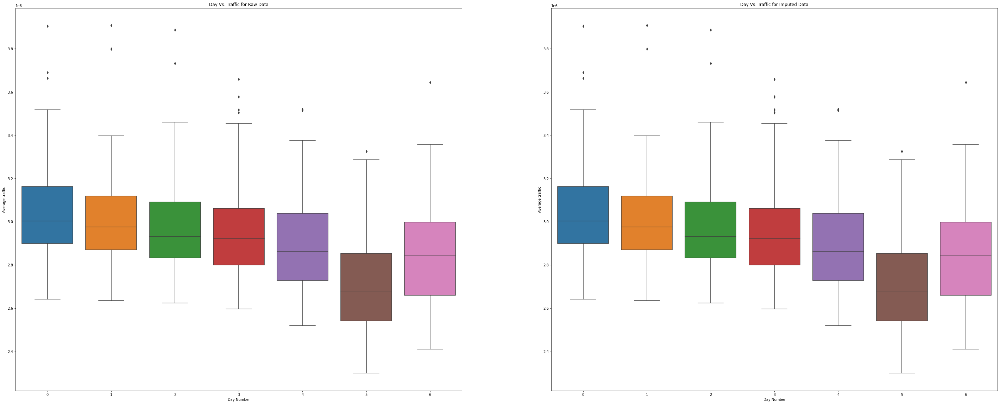

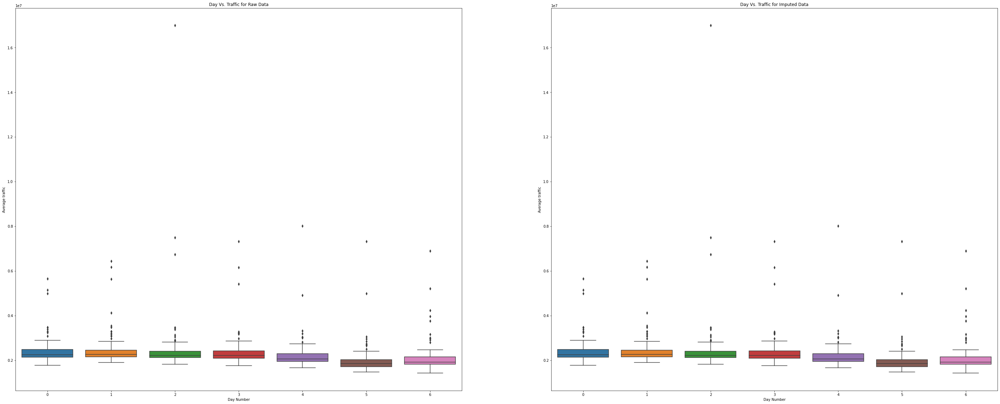

...

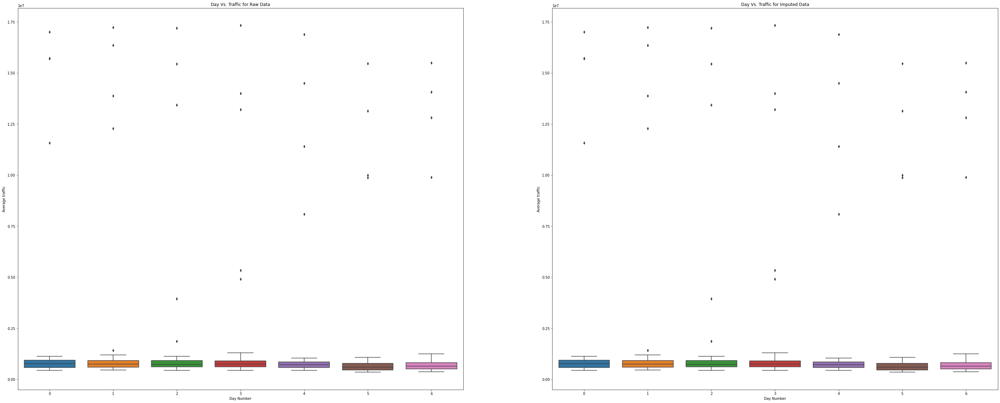

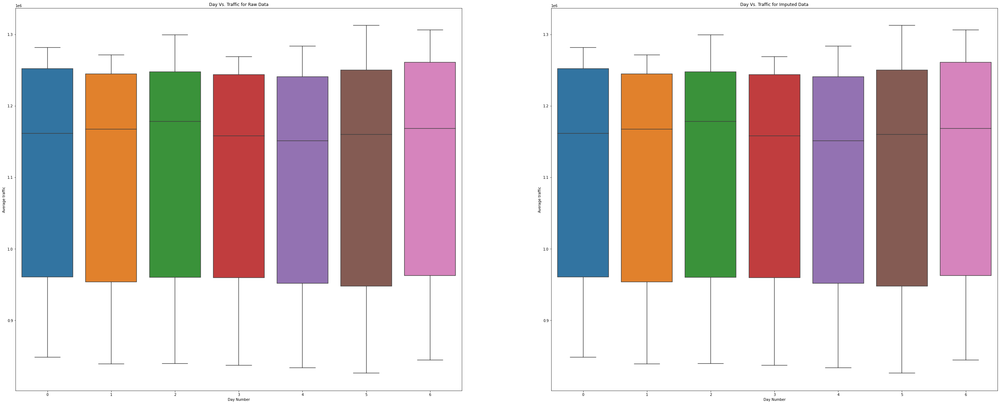

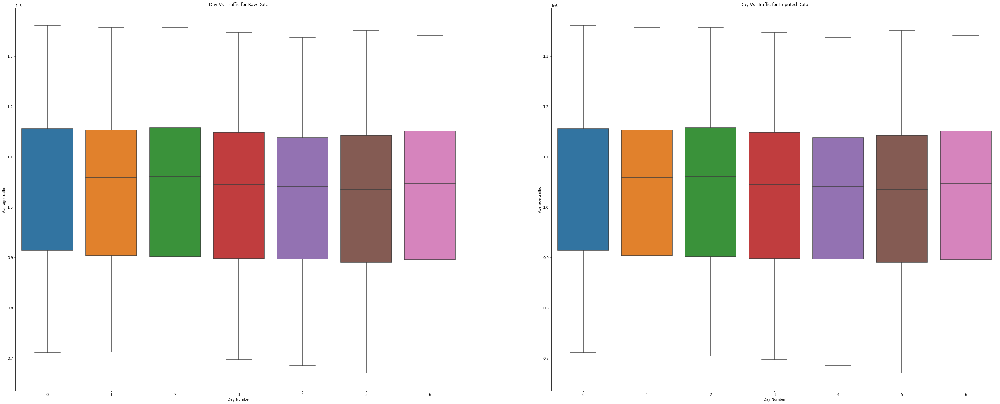

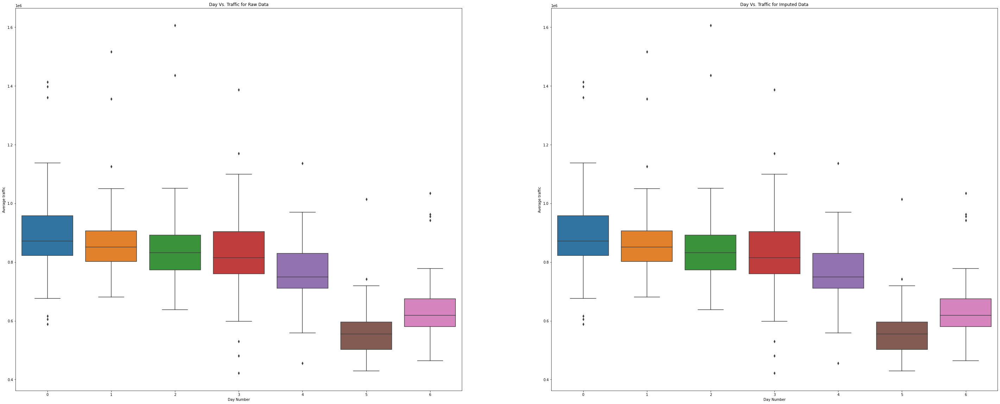

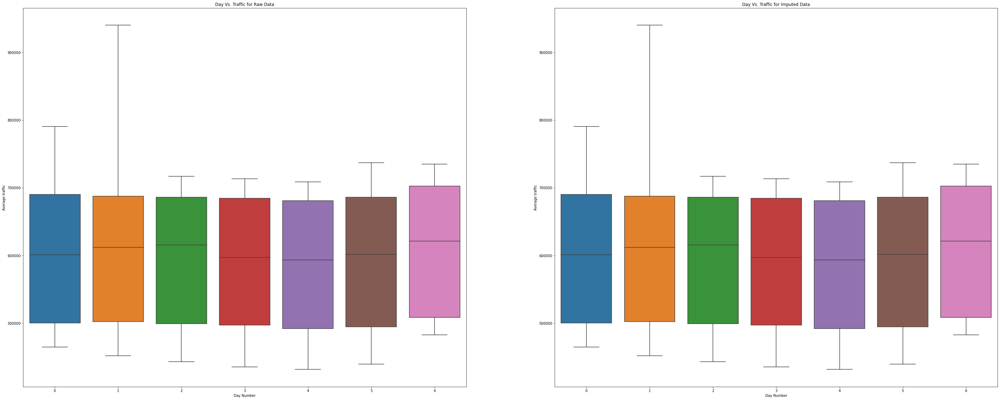

In [28]:
# Boxplots of weekdays vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=weekday,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=weekday,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


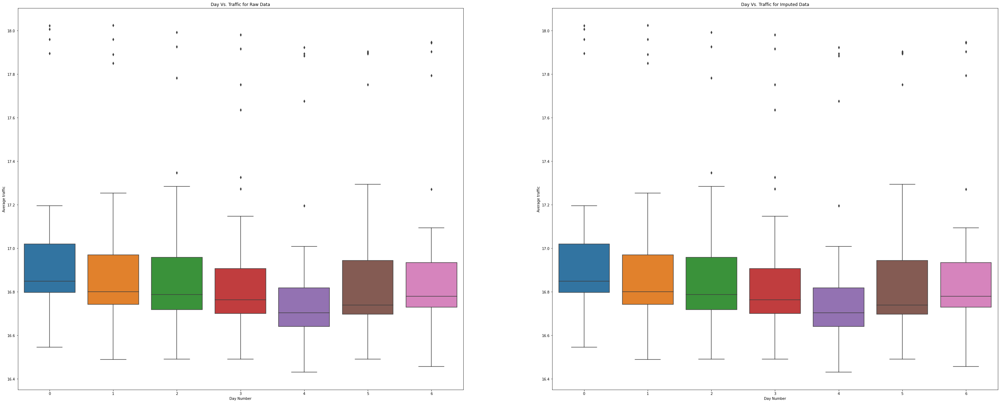

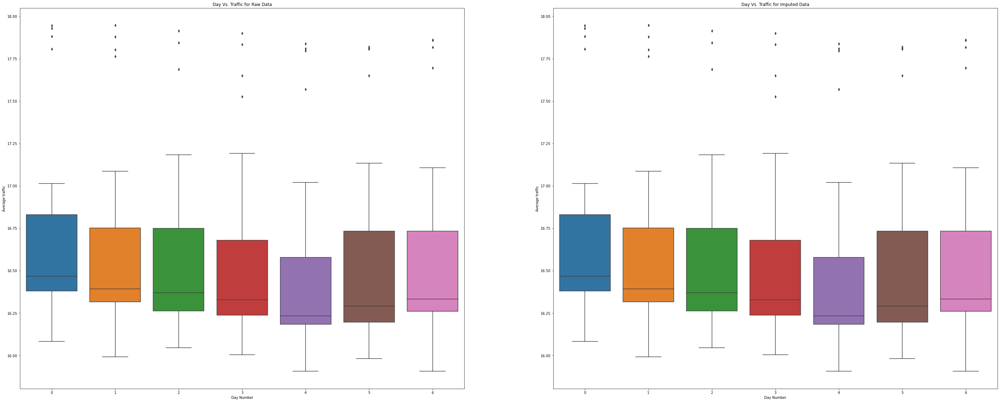

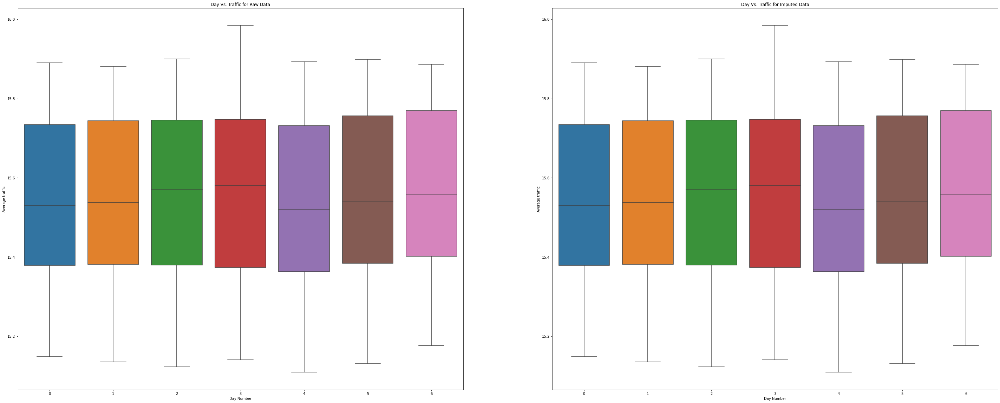

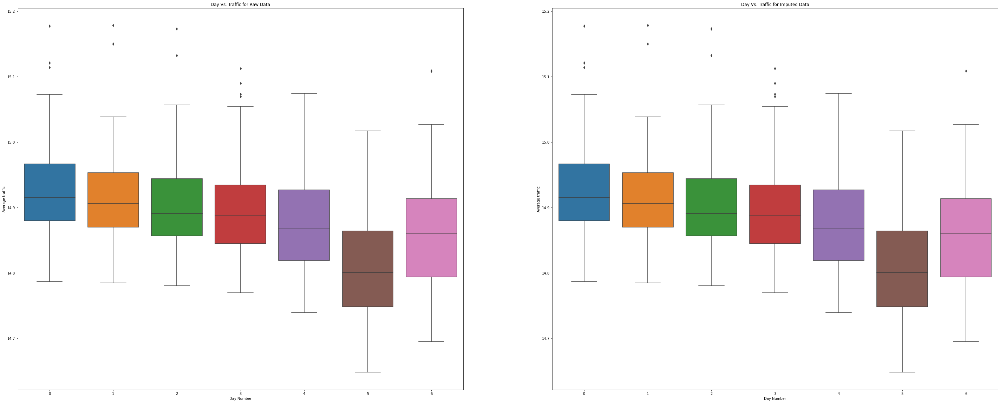

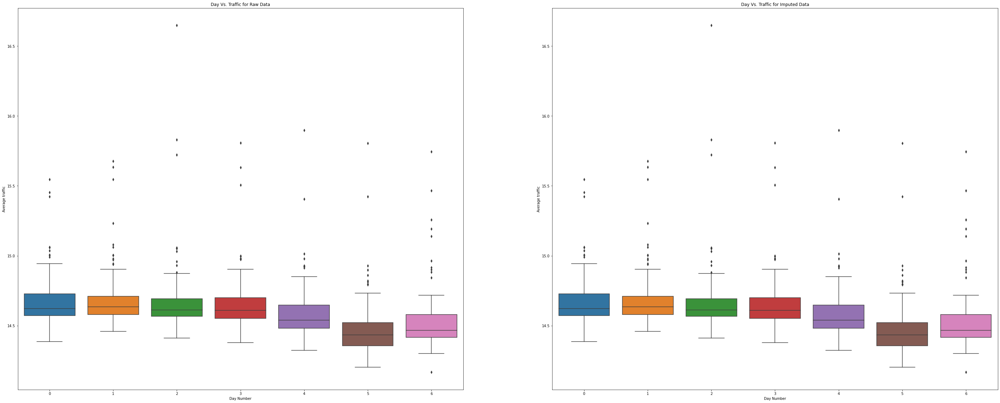

...

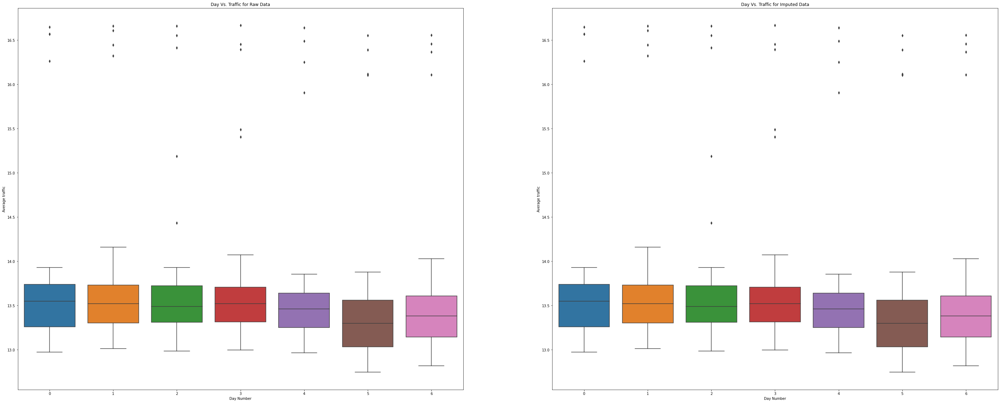

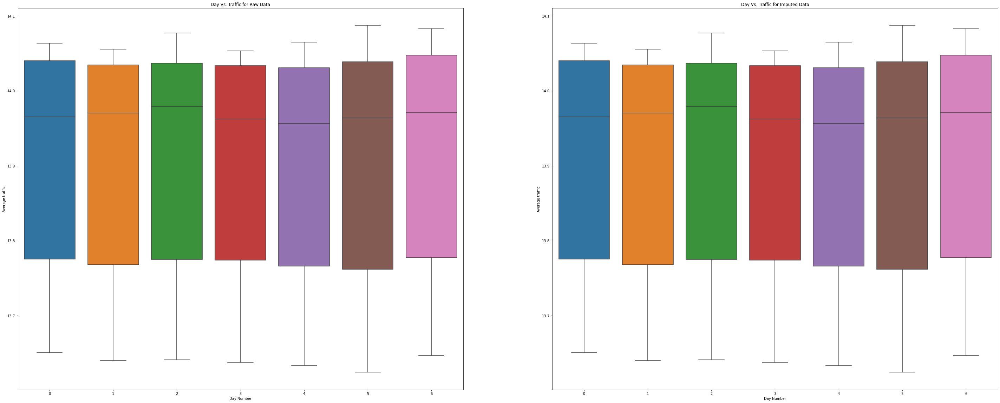

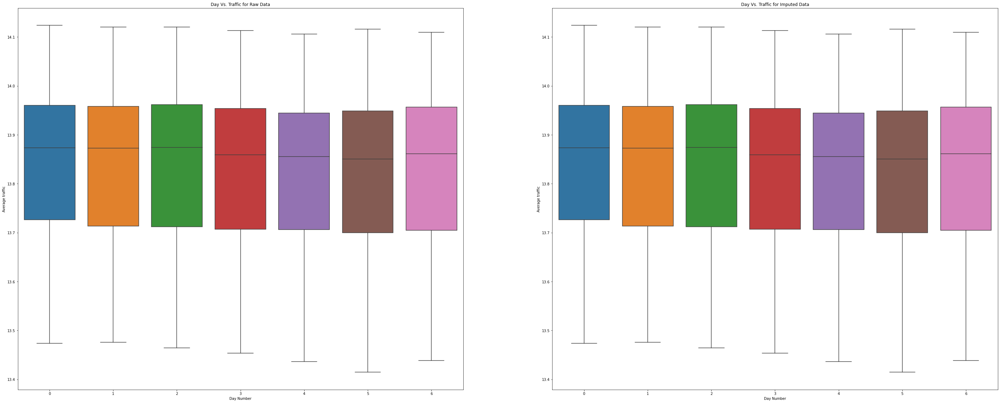

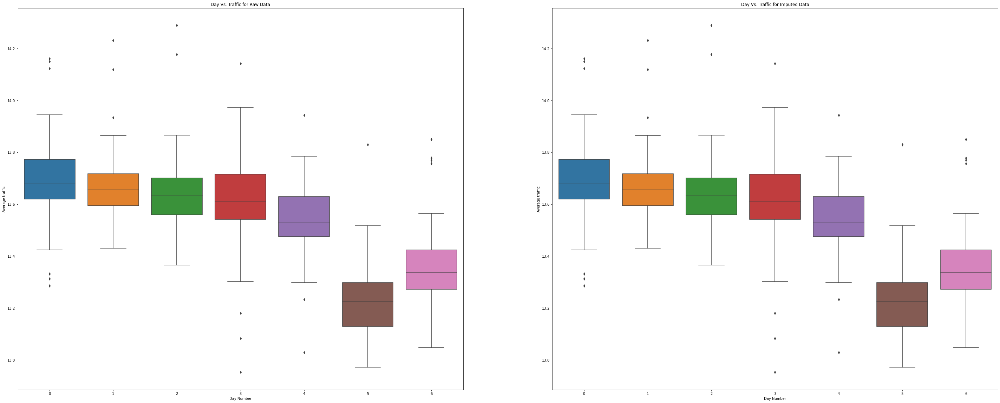

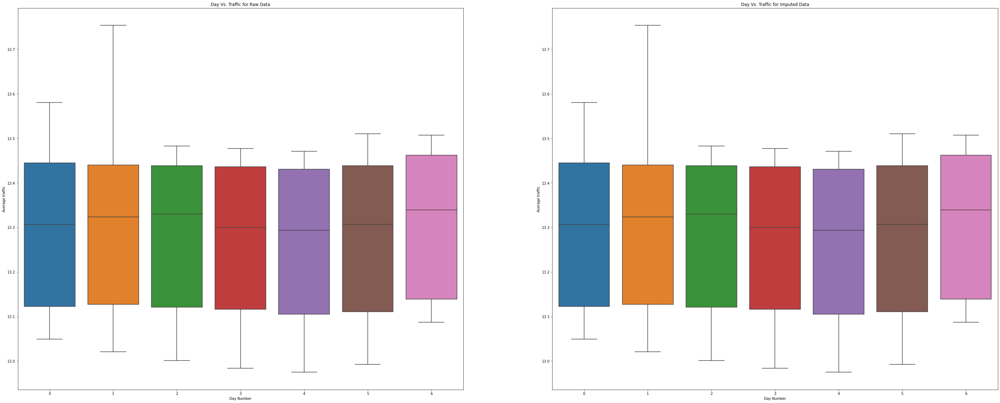

In [29]:
# Boxplots of weekdays vs. average pagehits for log transformed data.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_log_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_log_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=weekday,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=weekday,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


This plot shows that on  Sunday or Monday , the average pageviews increase. Also there are differences between each weekday. In most cases there is a gradual drop in the pagehit values from Monday to Saturday and then there is an increase on Sunday which continues to Monday. So I will be including this weekday as a feature and also another feature as is_sunday_or_monday as their mean seem to be higher than the other days.

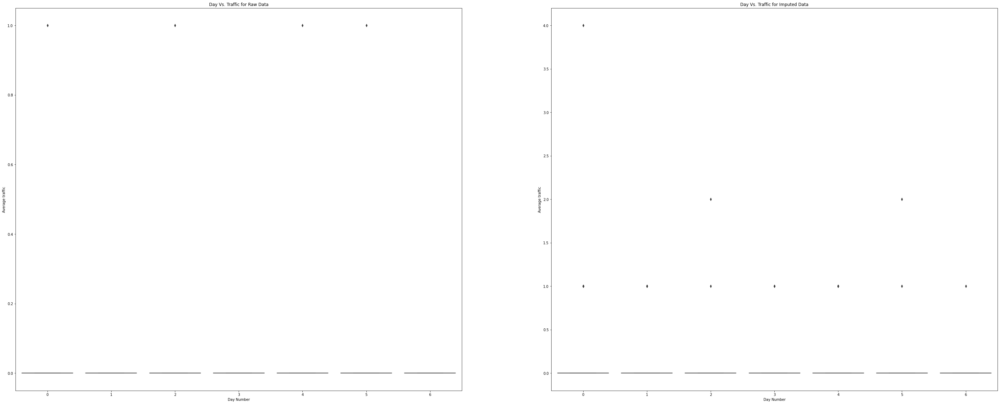

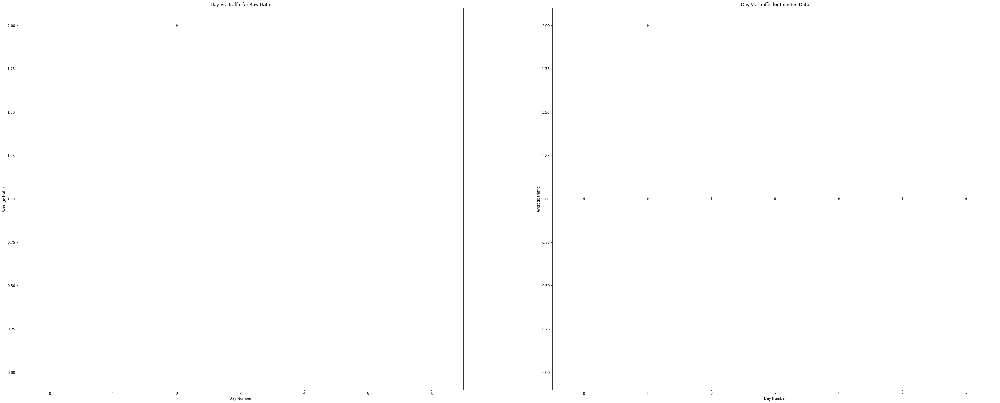

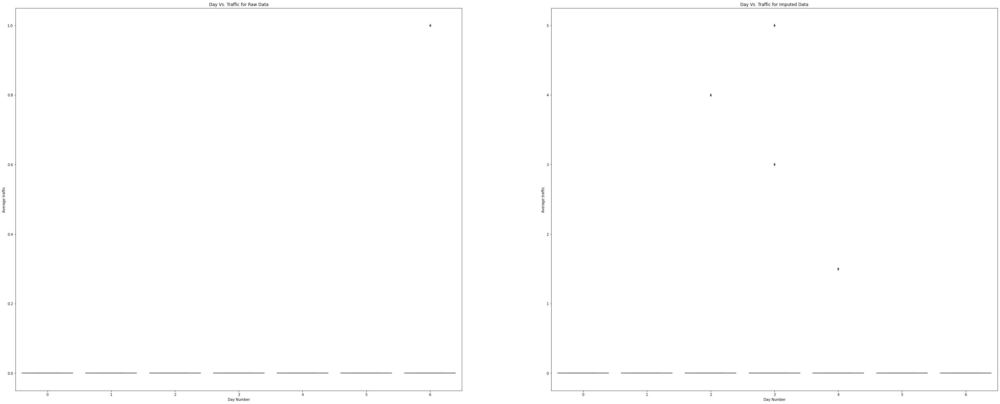

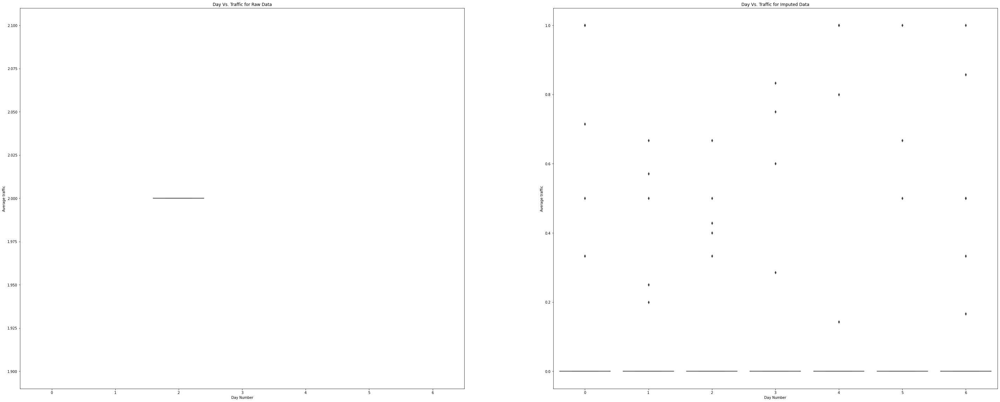

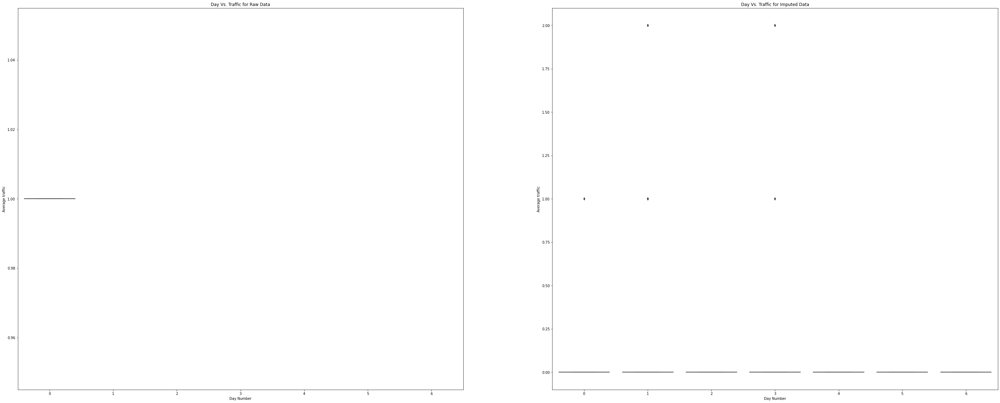

...

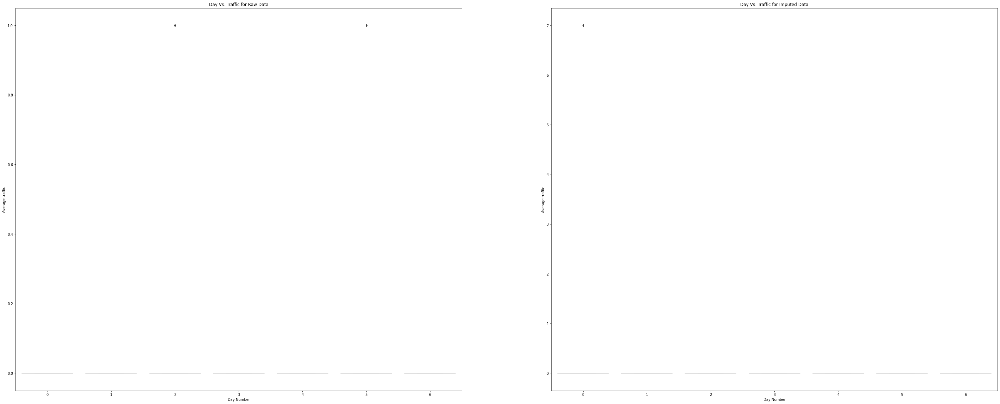

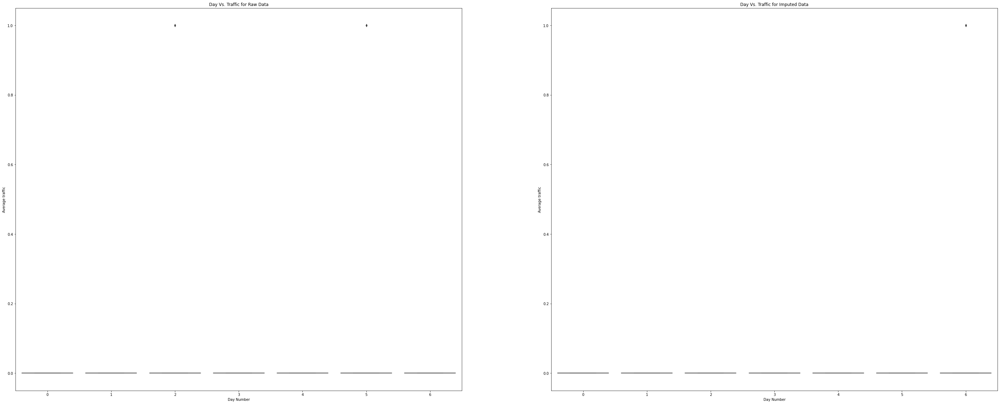

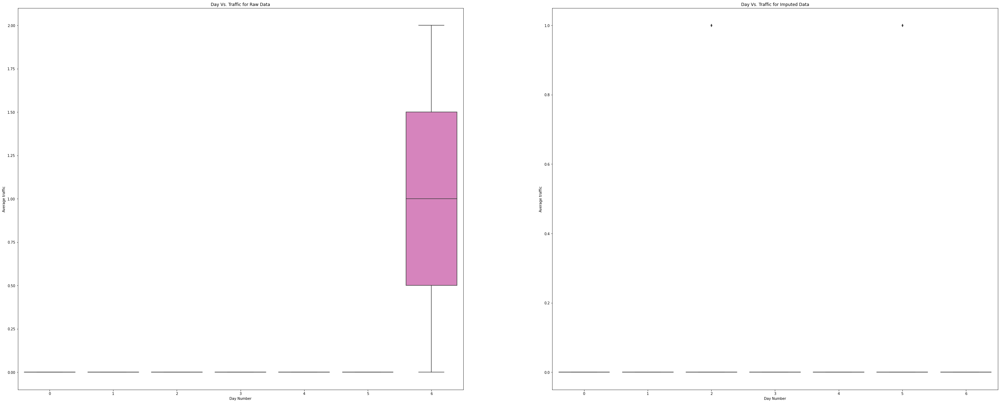

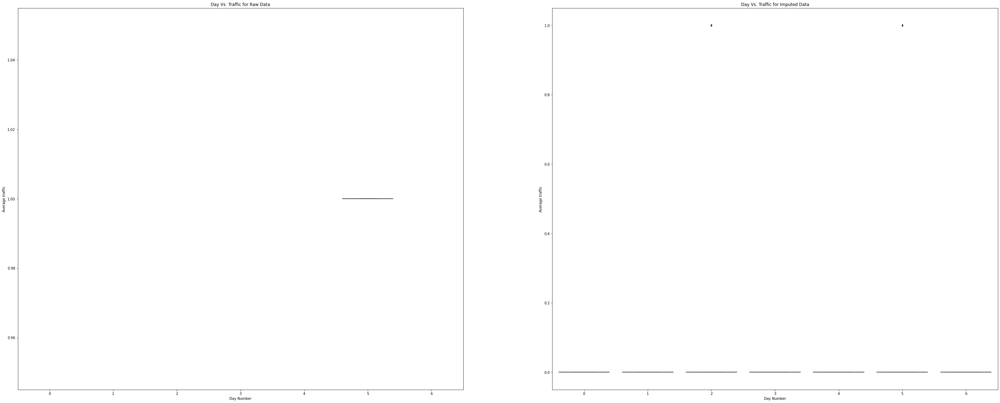

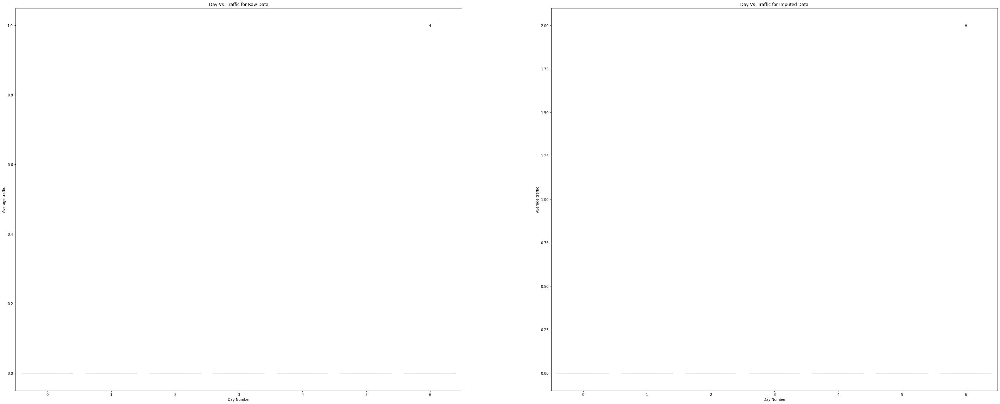

In [30]:
# Boxplots of weekdays vs. average pagehits for last 15 pages.
import seaborn as sns
for i in range(0,15):
    rawhits=last_15_raw.iloc[i,1:train.shape[1]].values
    imphits=last_15_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=weekday,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=weekday,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


I could not derive anything meaningful from these plots as the view percentage is too less

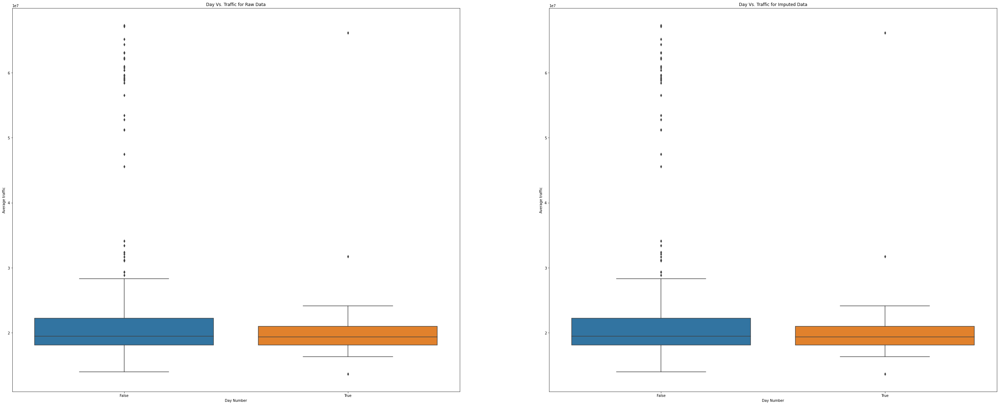

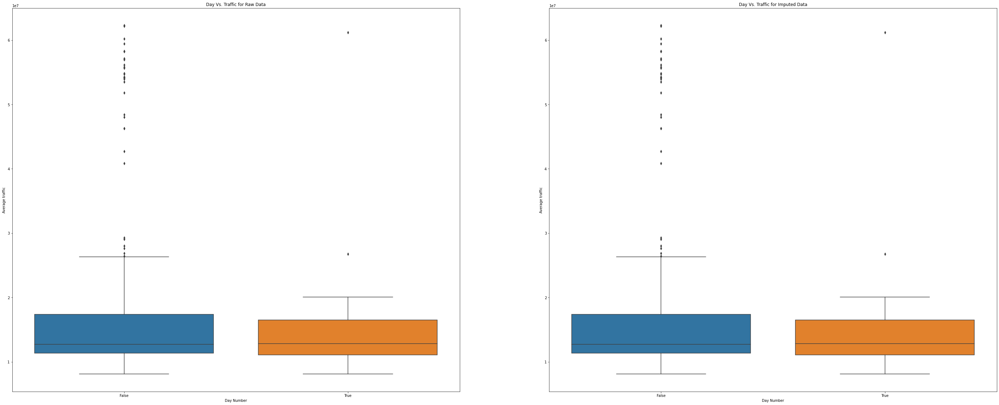

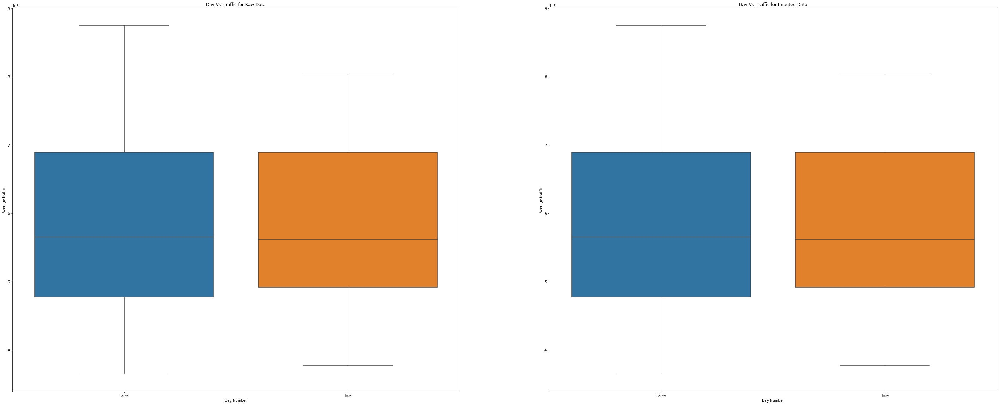

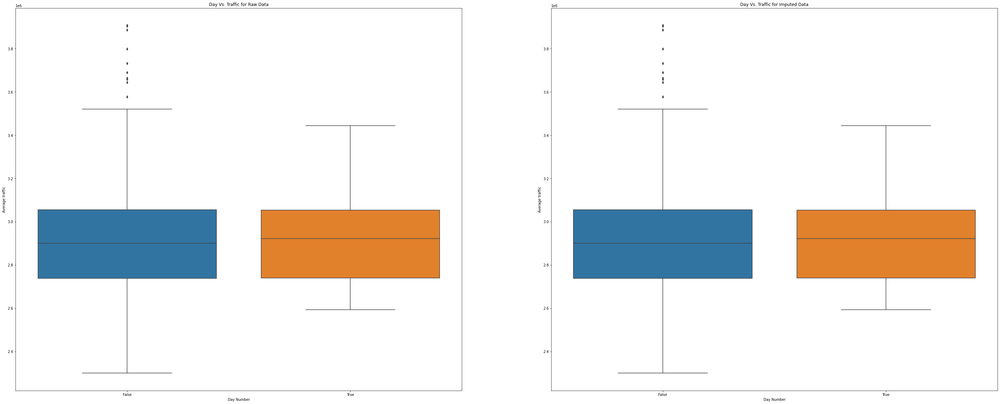

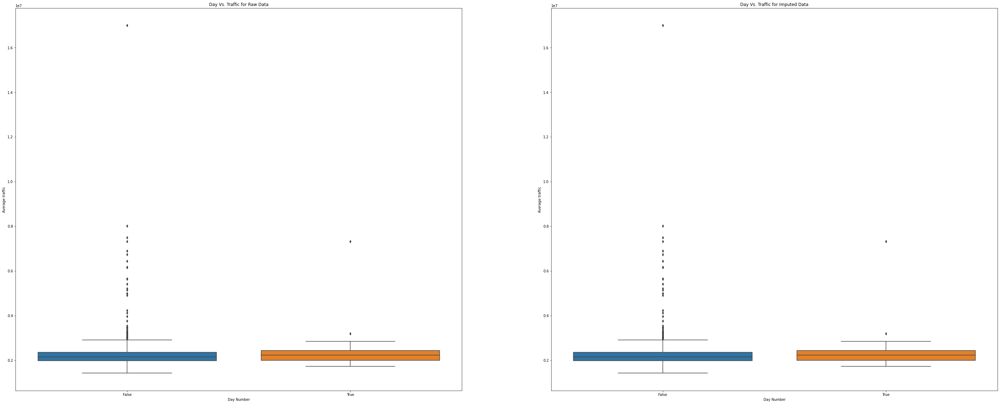

...

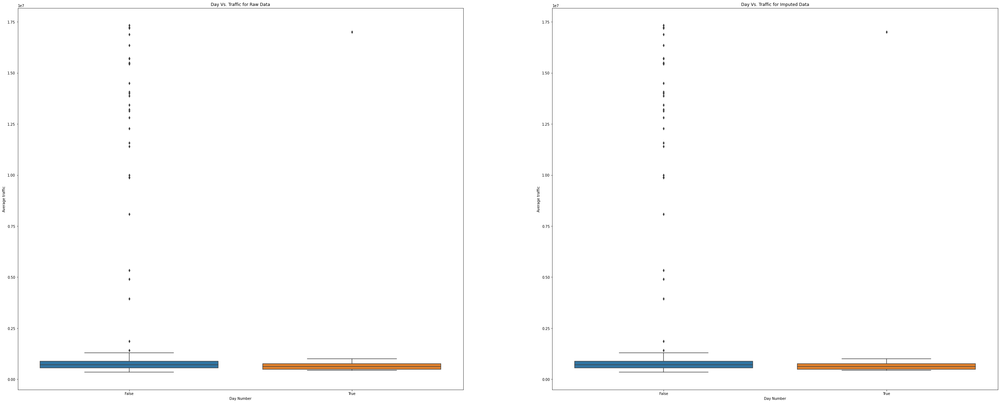

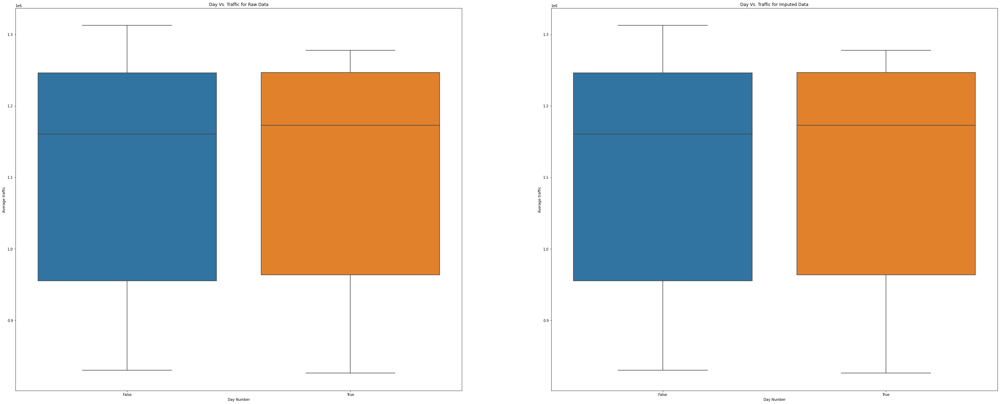

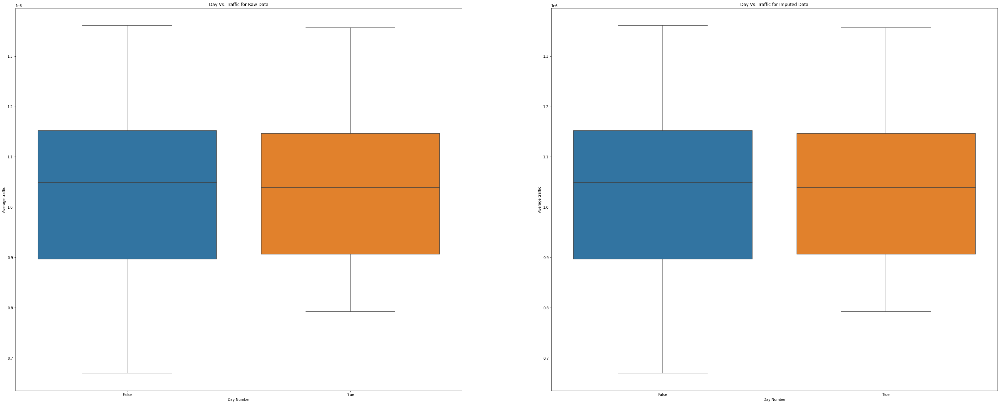

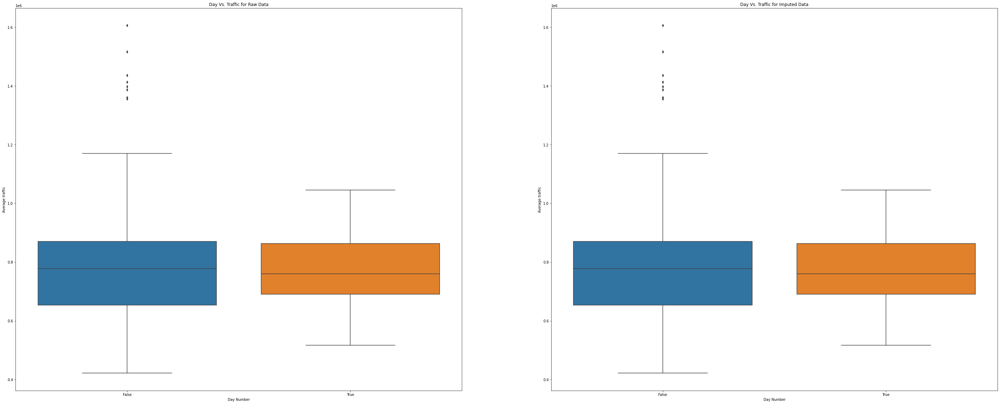

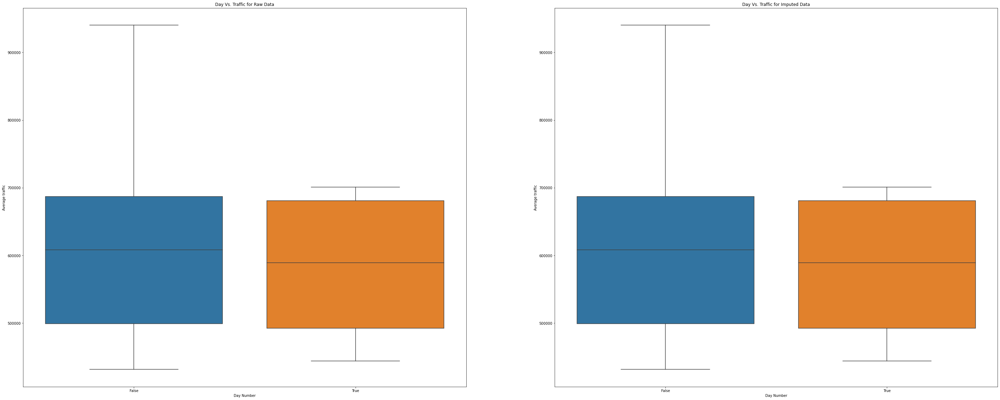

In [31]:
# Boxplots of month_start vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=month_start,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=month_start,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


There are very few days that fall on the first day of the month , but we see that the boxplot mean and  IQR is aprroximately same for both the month starting days and other ones.This suggests that the traffic on month start is quite high as compared to other days . So it is important to include this as a feature .

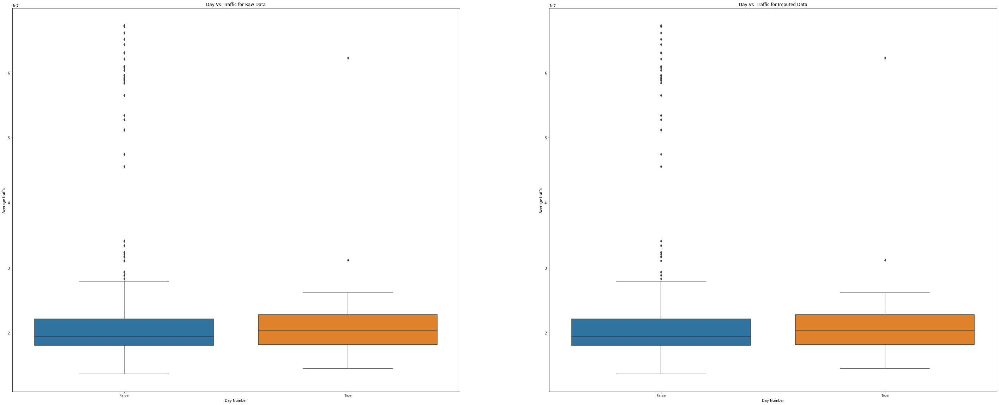

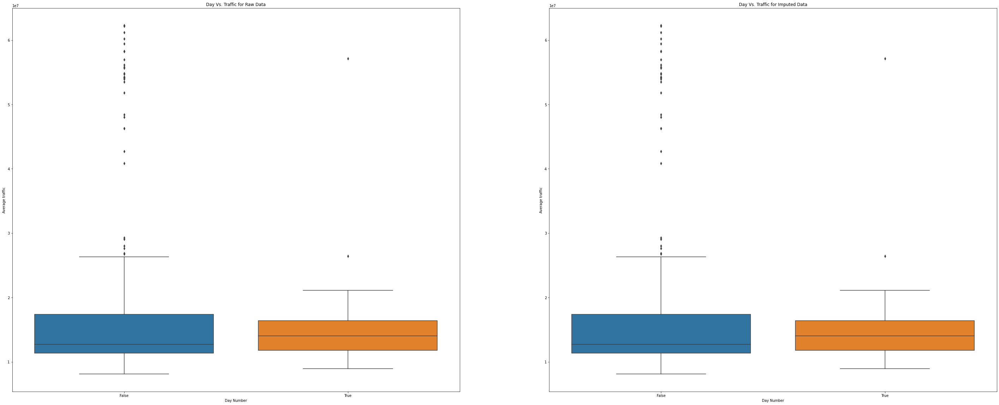

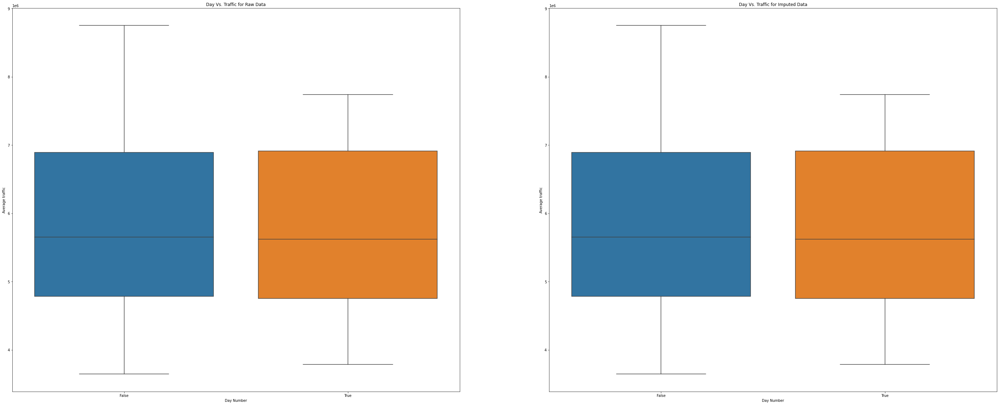

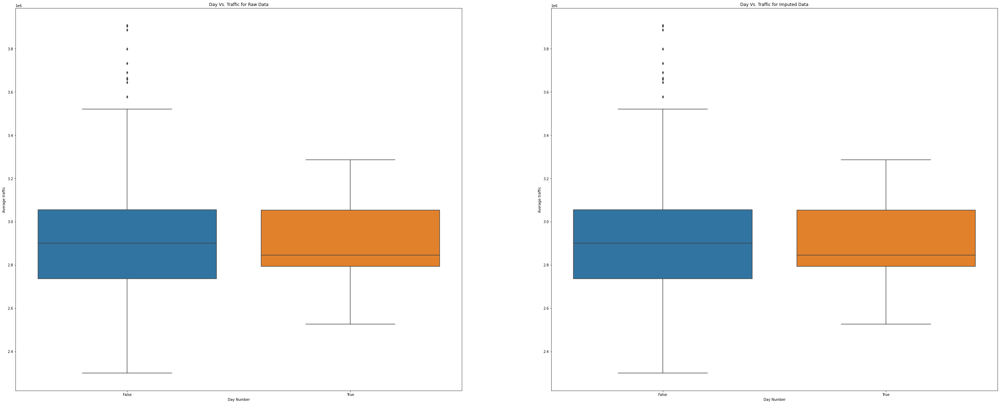

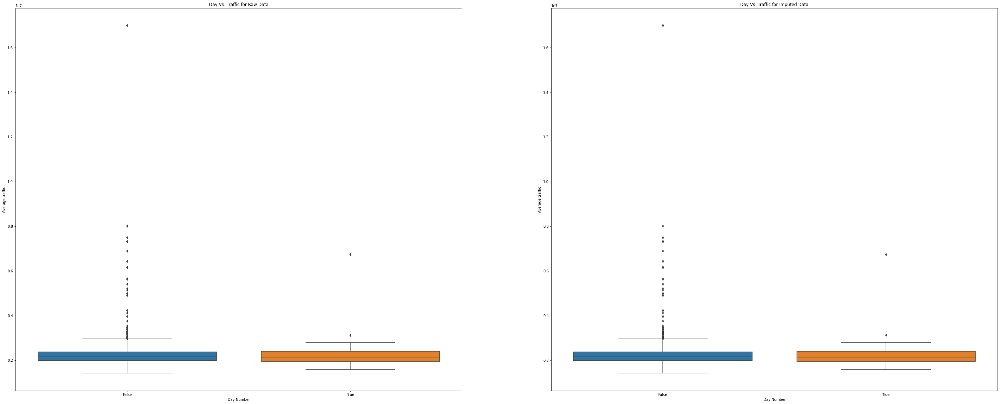

...

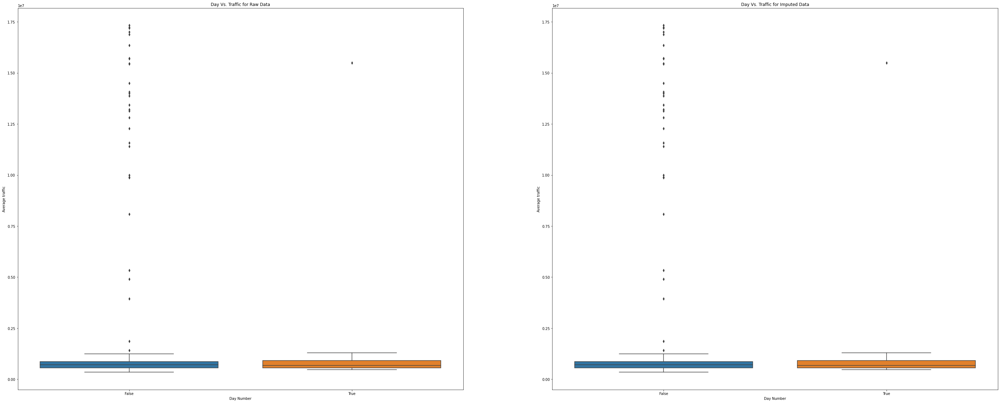

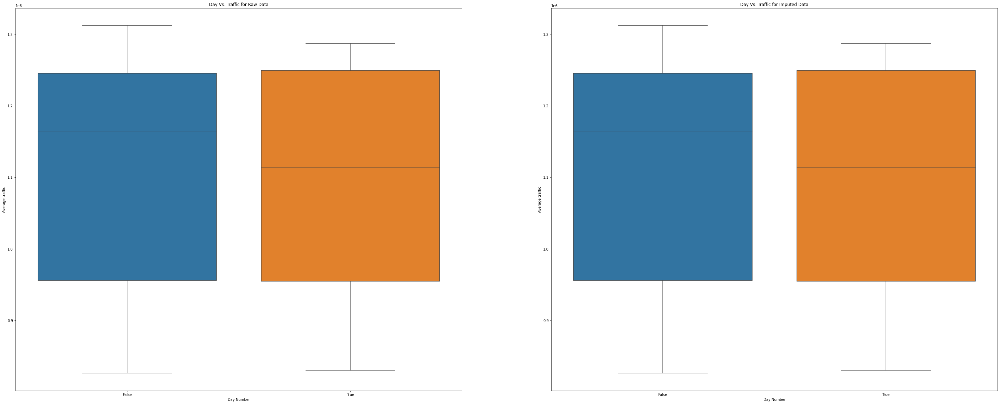

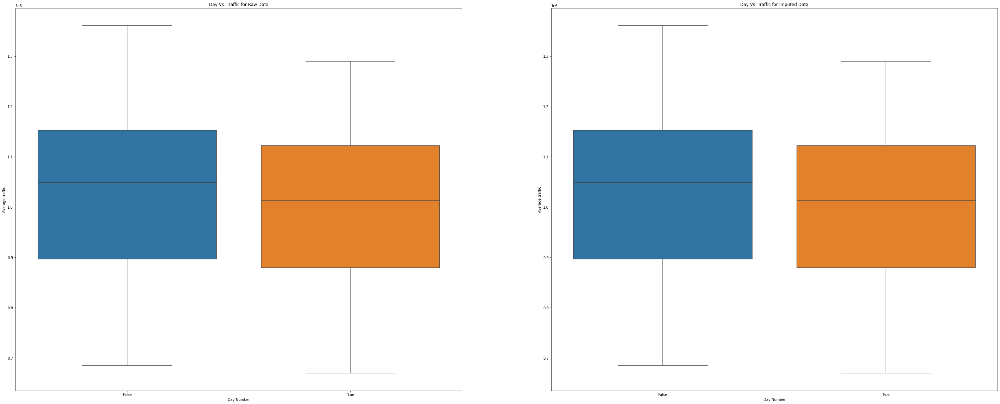

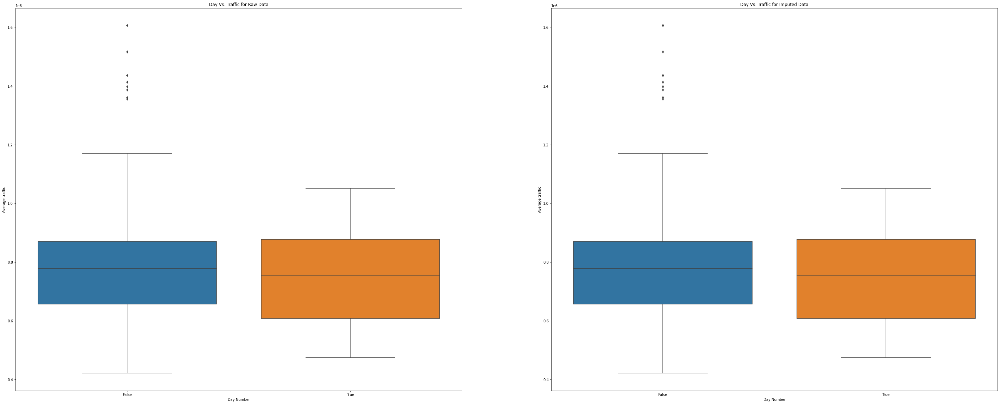

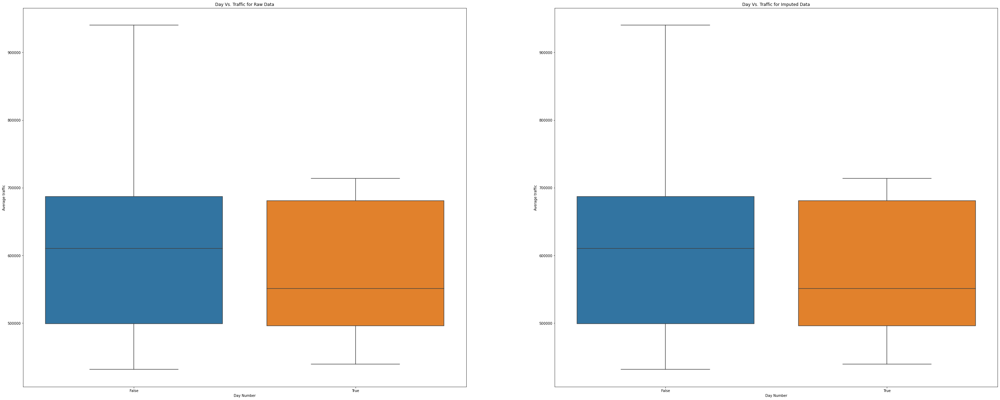

In [32]:
# Boxplots of month_end vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=month_end,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=month_end,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


- I see a similar trend as the month_start feature 
- The boxplot for month_end days is in fact has higher IQR and similar median value as other days
- This tells us that the days conecting the months have significantly higher traffic as compared to other days.

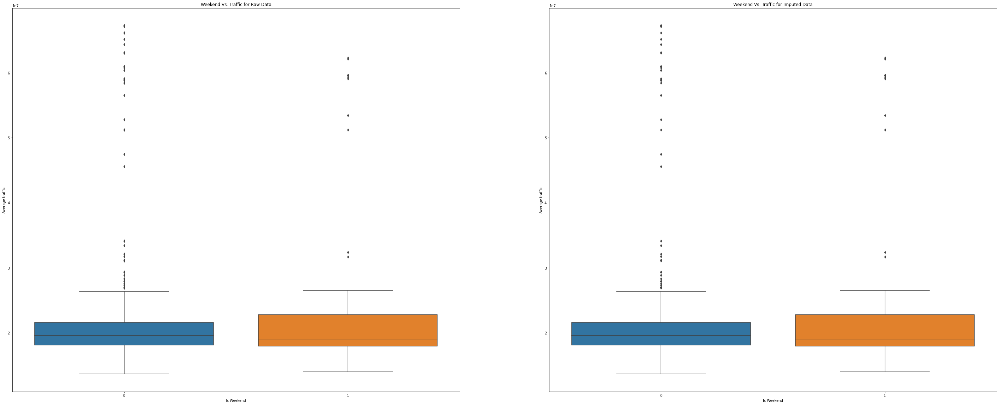

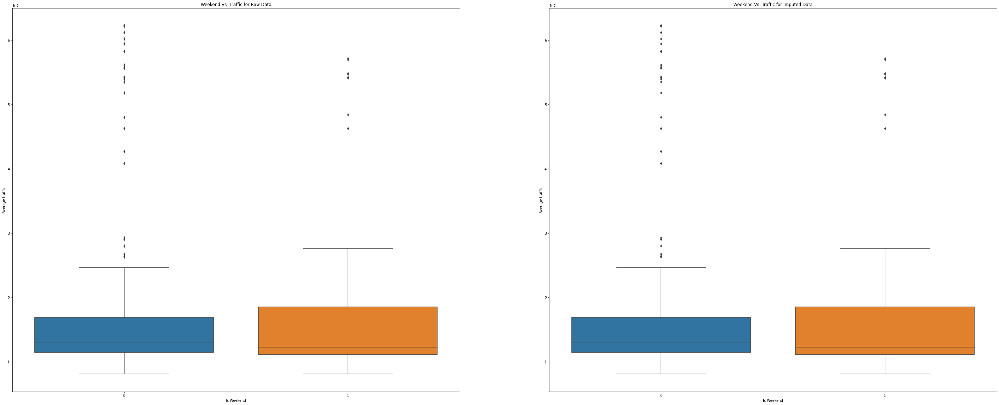

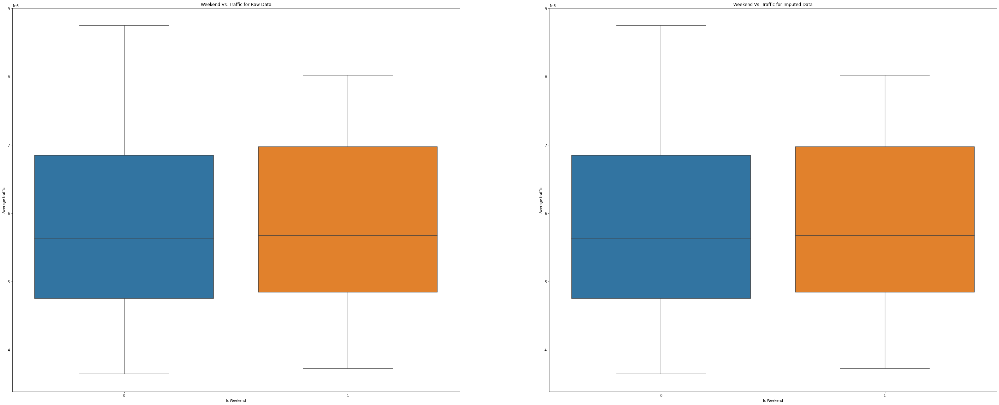

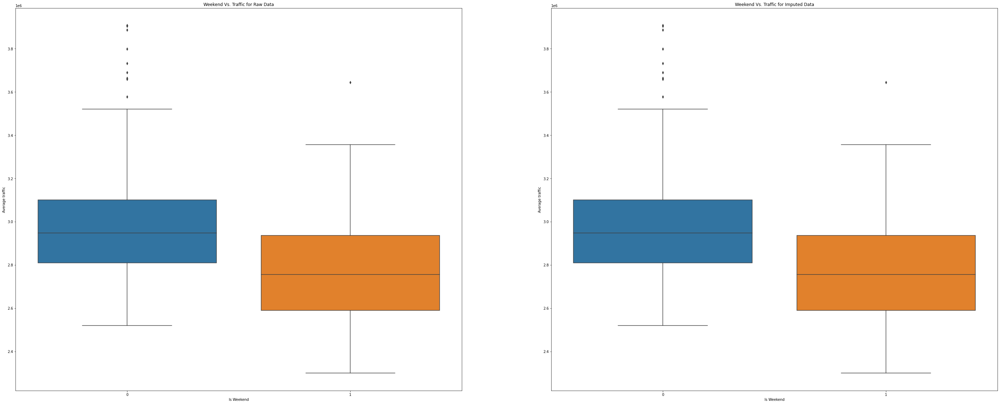

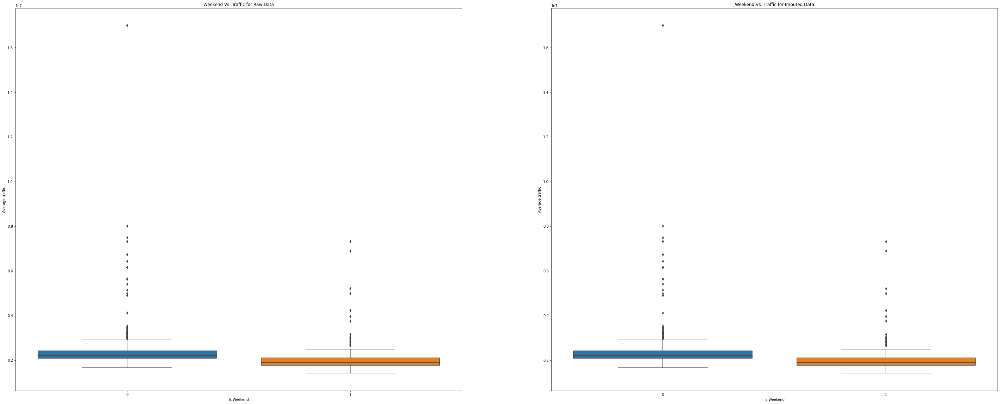

...

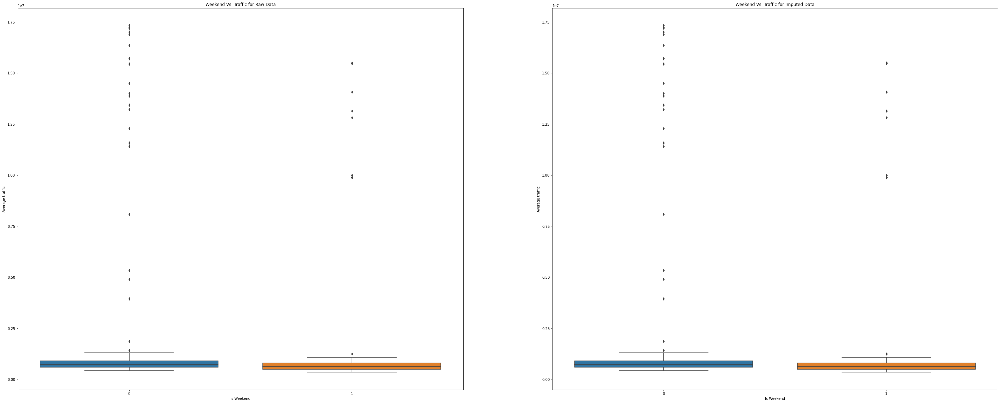

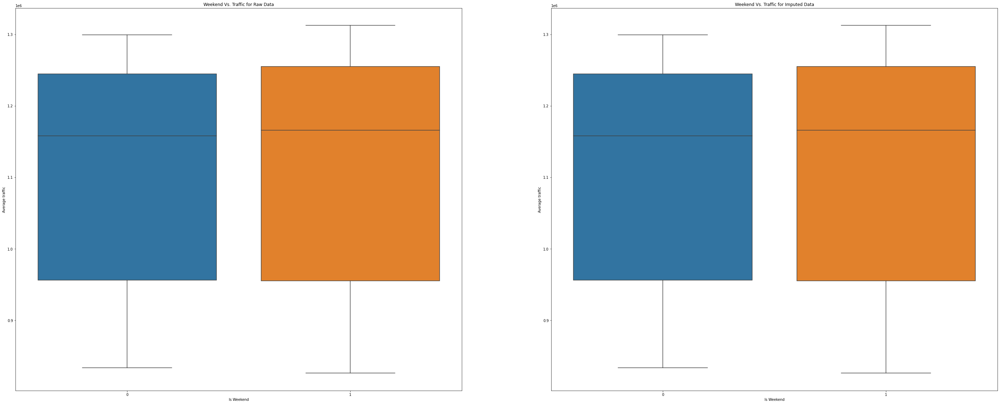

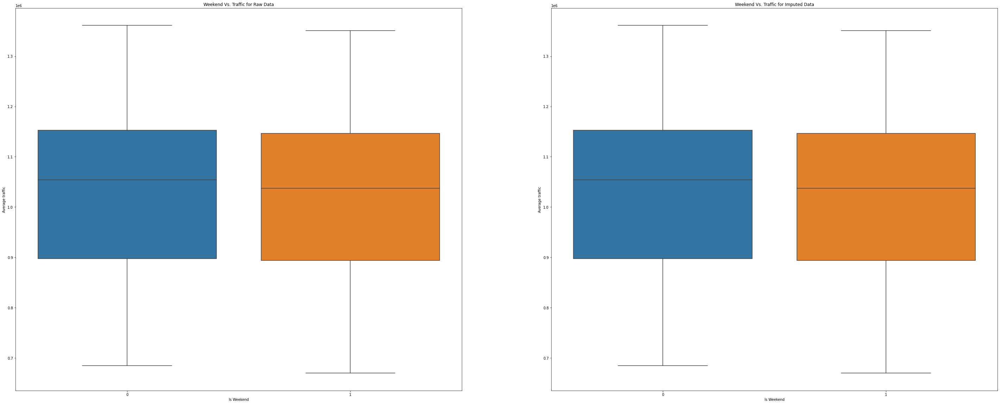

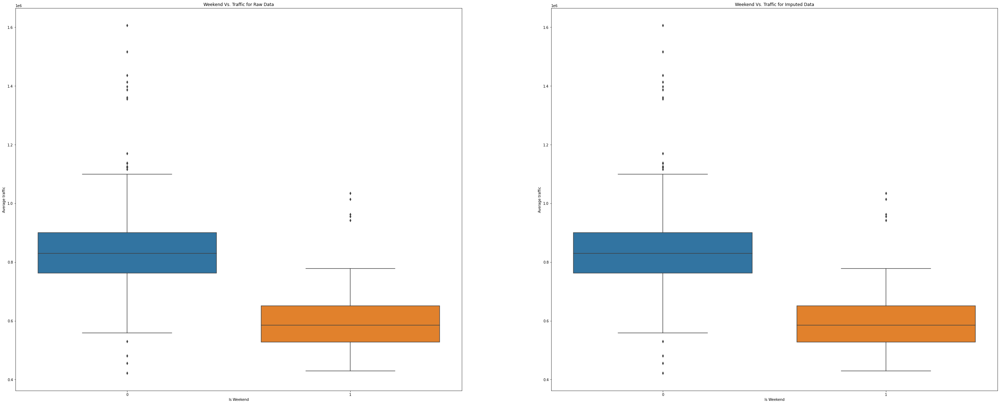

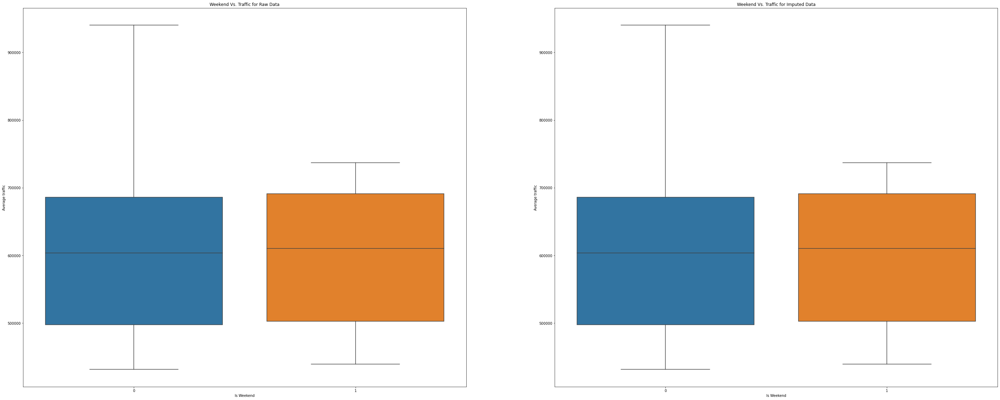

In [33]:
# Boxplots of is_weekend vs. average pagehits.

import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=weekend,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Is Weekend')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Weekend Vs. Traffic for Raw Data')
    sns.boxplot(x=weekend,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Is Weekend')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Weekend Vs. Traffic for Imputed Data')
    
    plt.show()


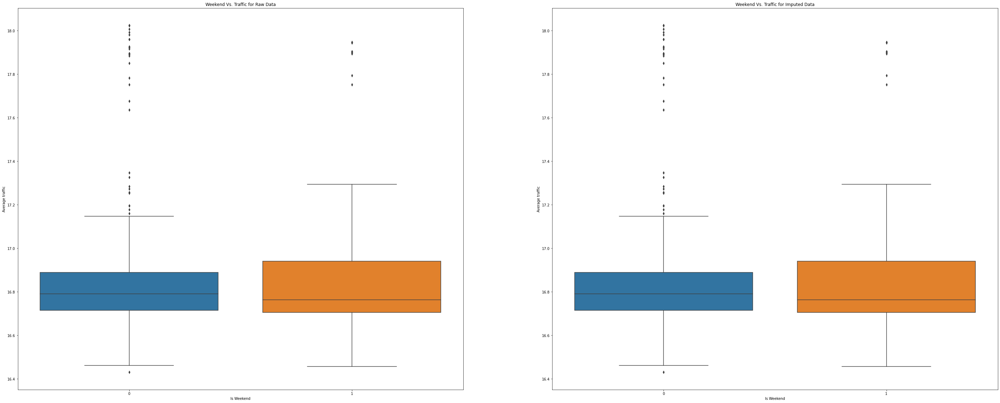

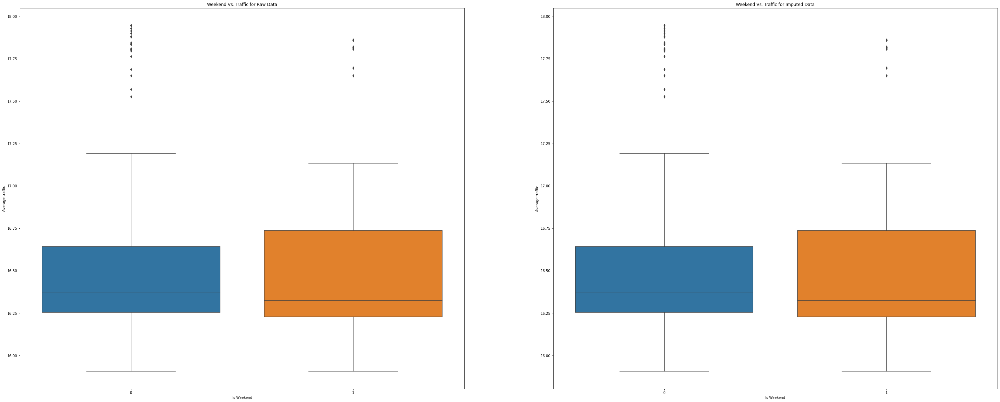

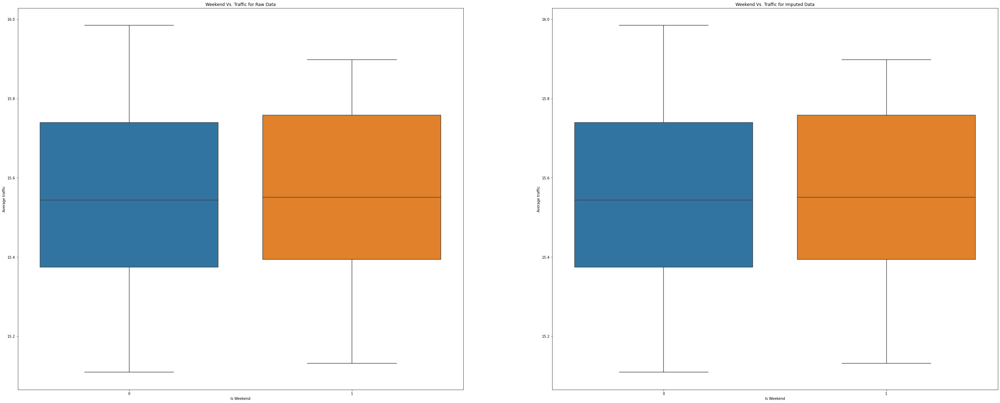

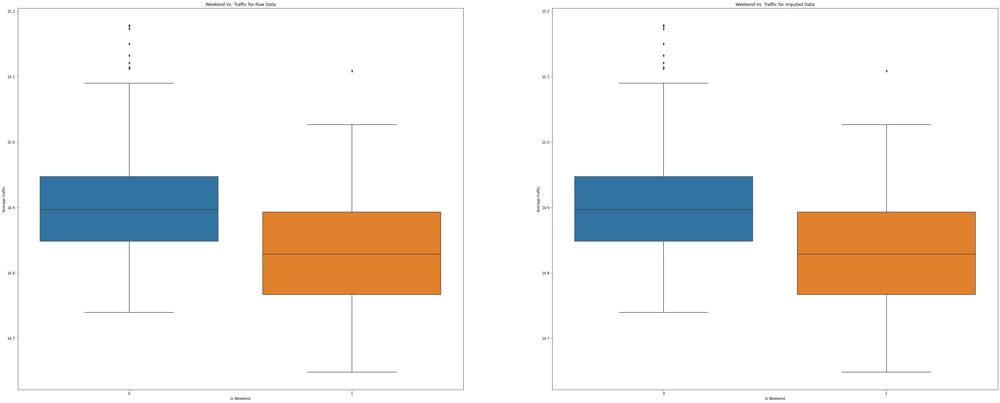

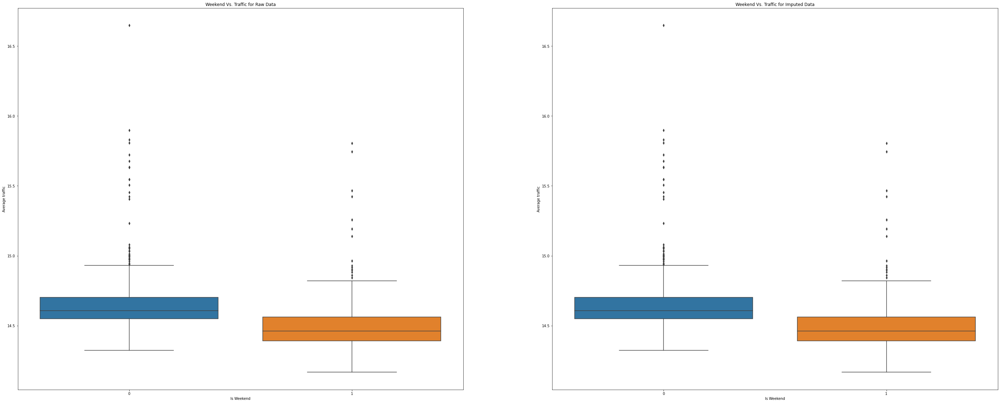

...

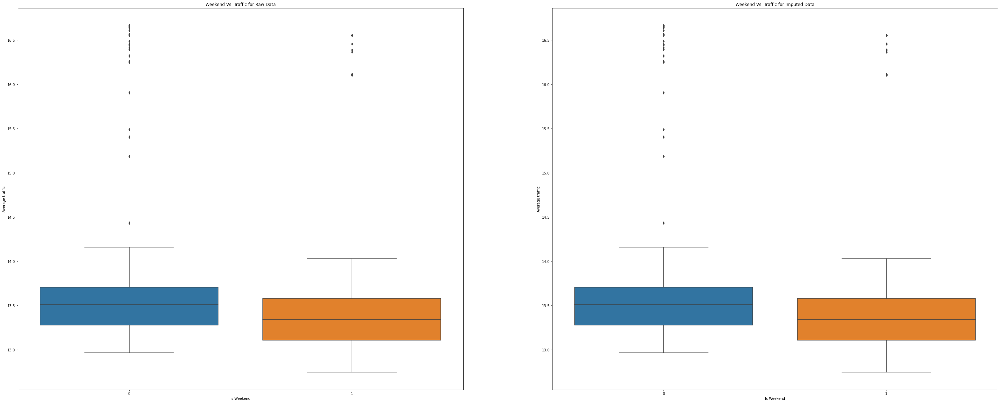

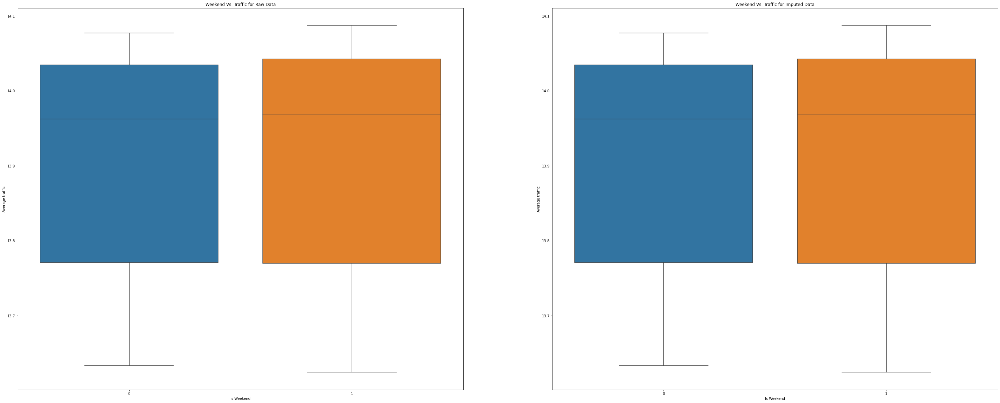

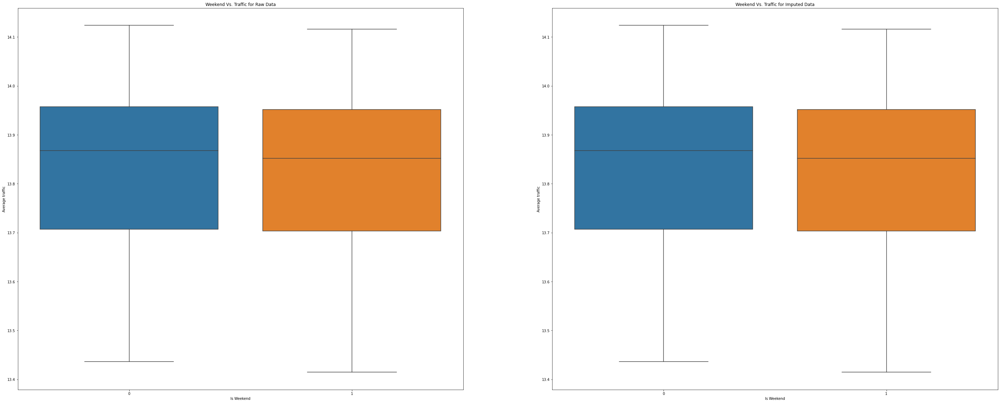

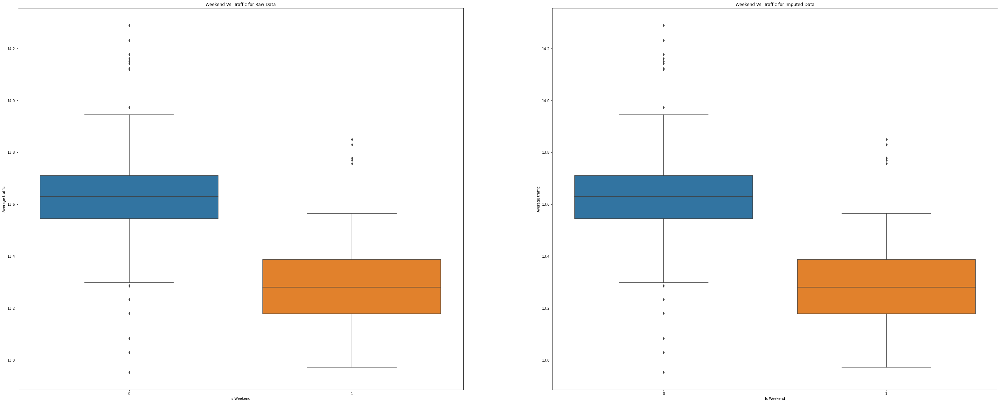

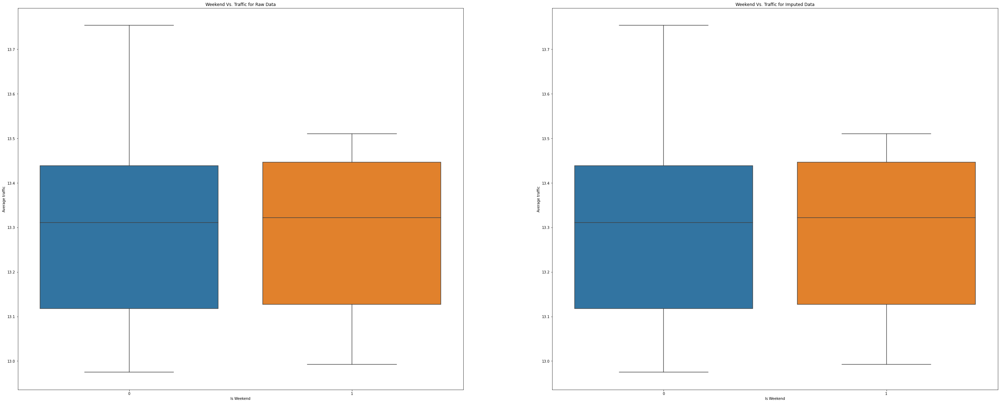

In [34]:
# Boxplots of is_weekend vs. average pagehits  for transformed data

import seaborn as sns
for i in range(0,15):
    rawhits=eda_log_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_log_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=weekend,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Is Weekend')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Weekend Vs. Traffic for Raw Data')
    sns.boxplot(x=weekend,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Is Weekend')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Weekend Vs. Traffic for Imputed Data')
    
    plt.show()


- There is not much difference in boxplots of weekdays and weekends .
- IQR is approximately same and the median is higher for weekends in some cases.
- But there are less number of days in weekends so the IQR and median should have been less than weekdays.
- This suggests that the traffic is higher on weekends as compared to weekdays.

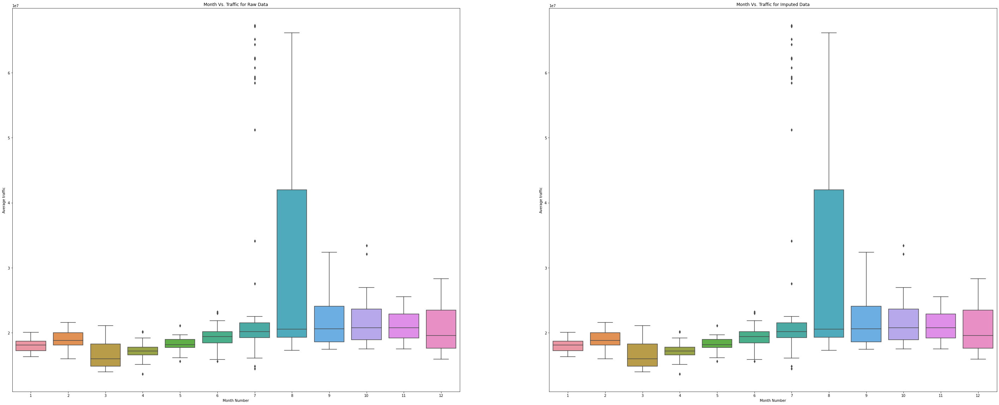

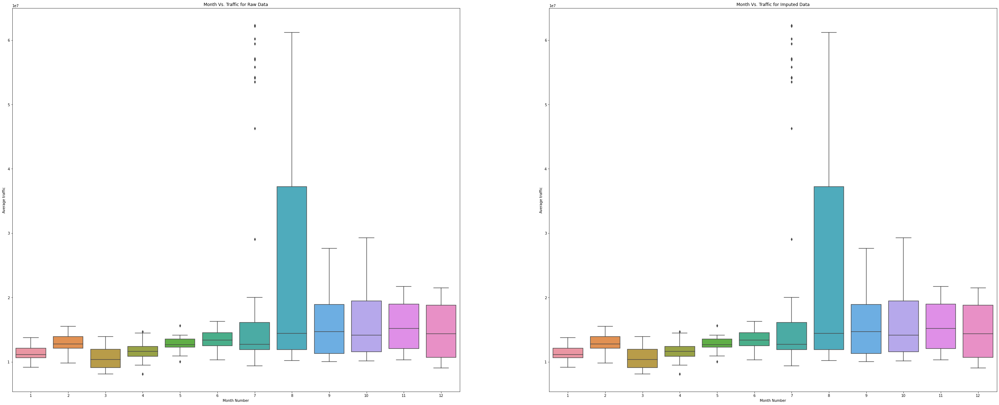

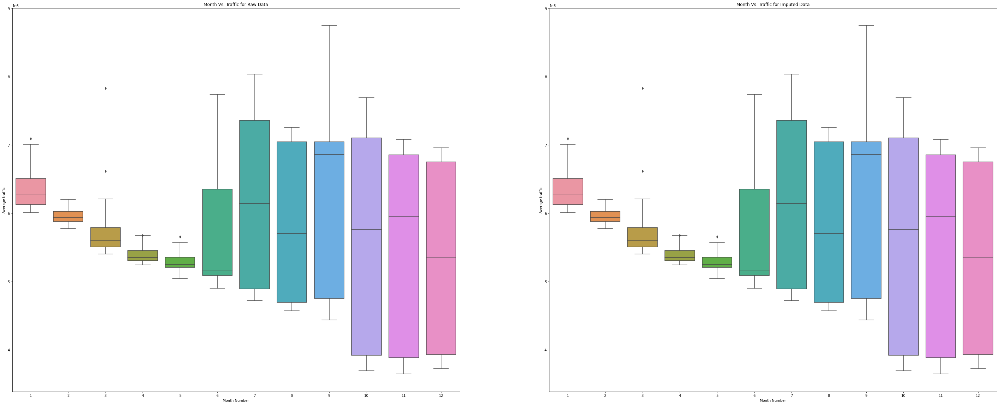

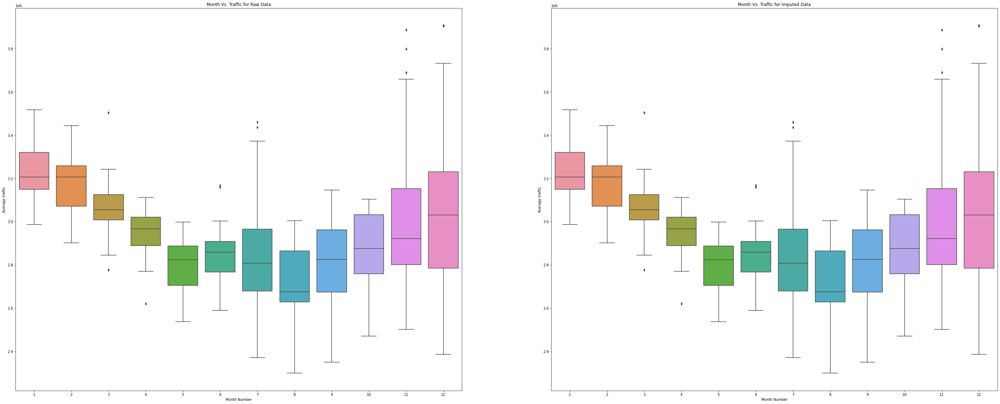

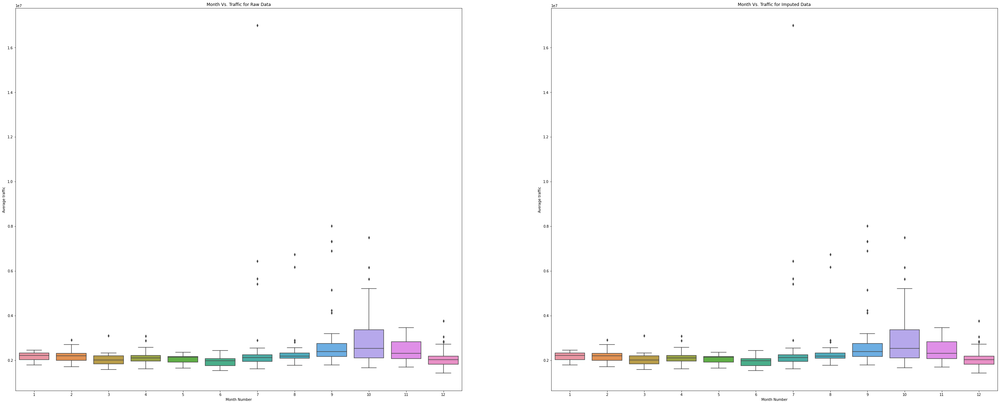

...

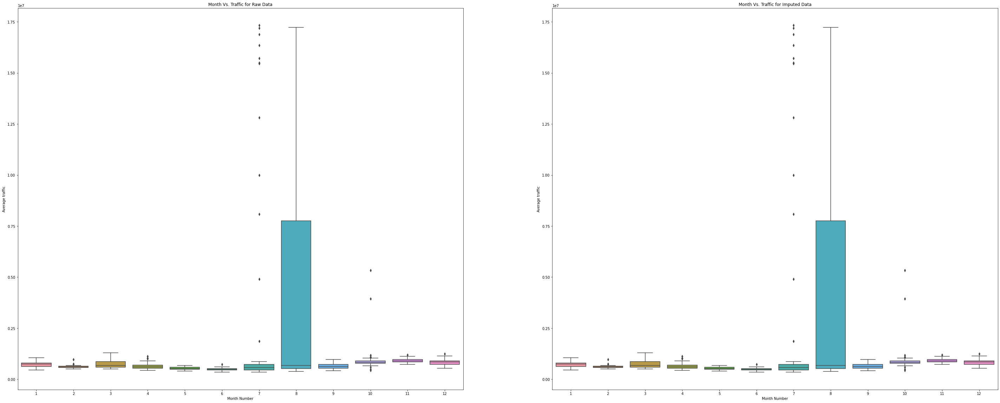

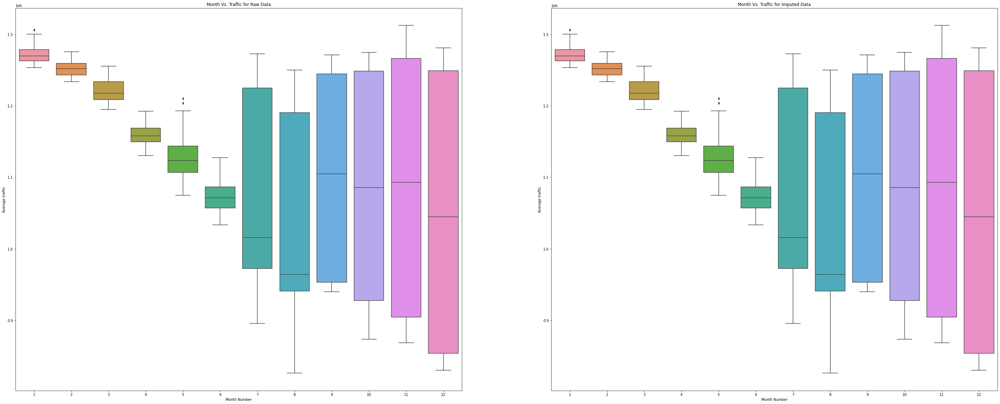

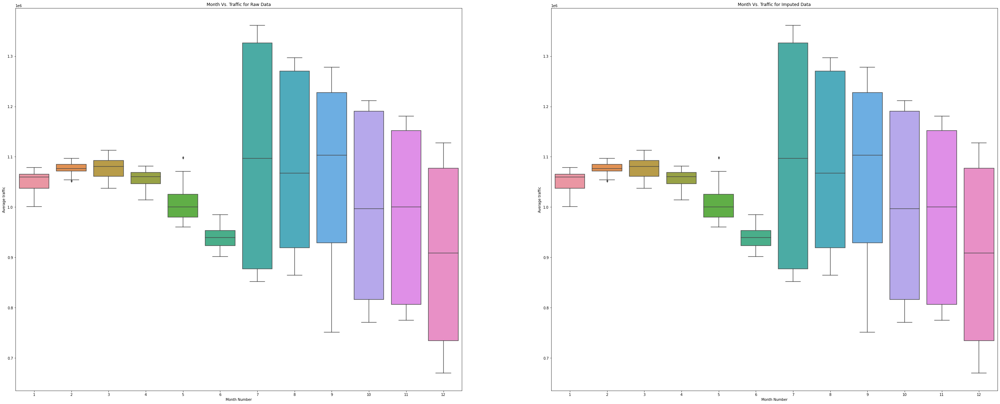

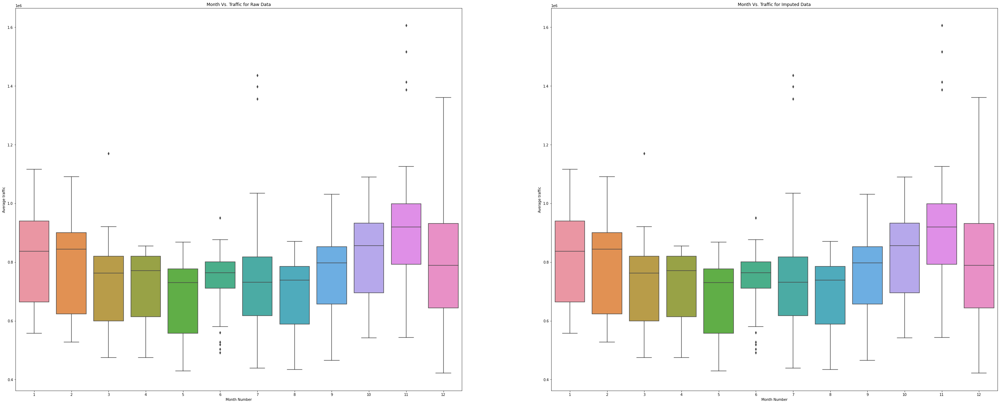

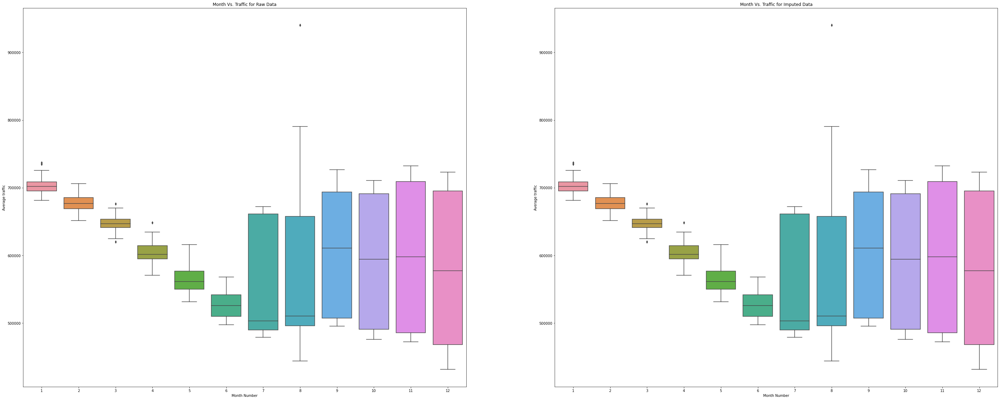

In [35]:
# Boxplots of month vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=month,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Month Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Month Vs. Traffic for Raw Data')
    sns.boxplot(x=month,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Month Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Month Vs. Traffic for Imputed Data')
    
    plt.show()


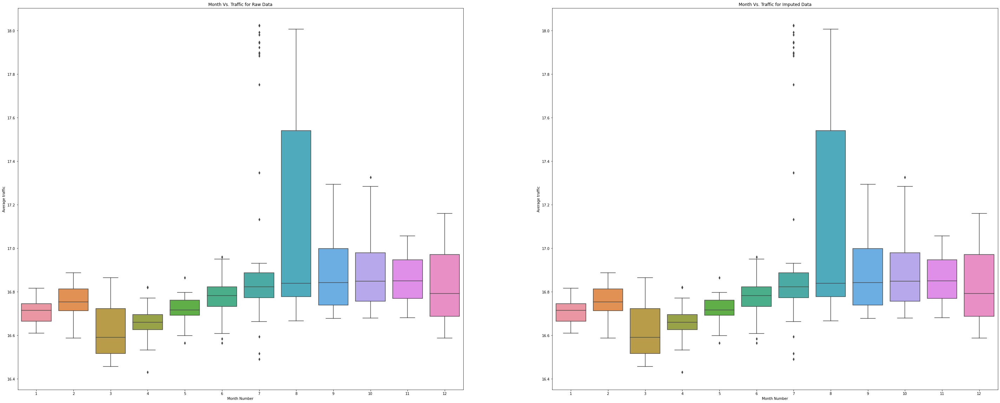

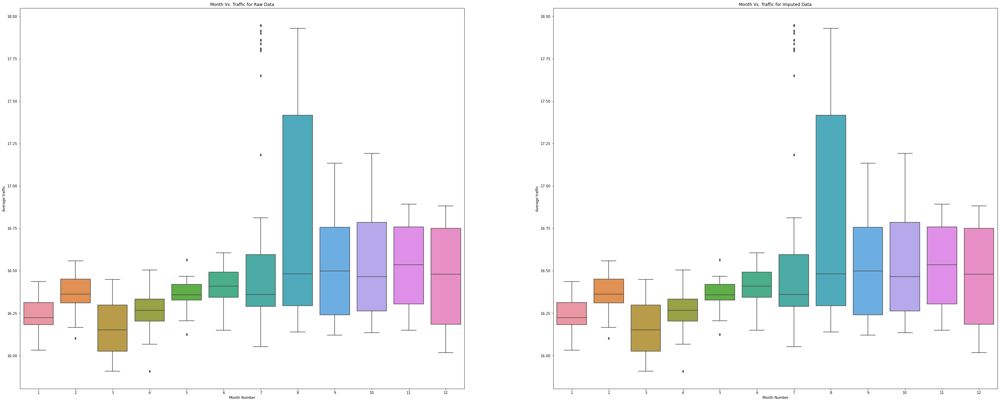

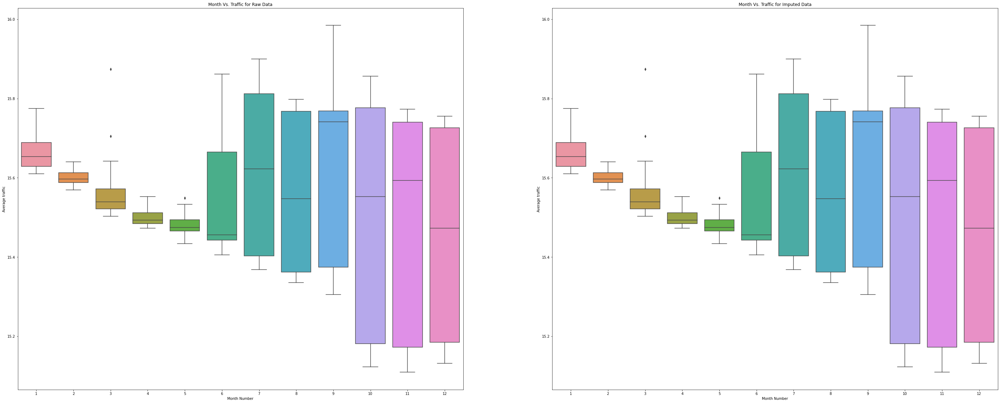

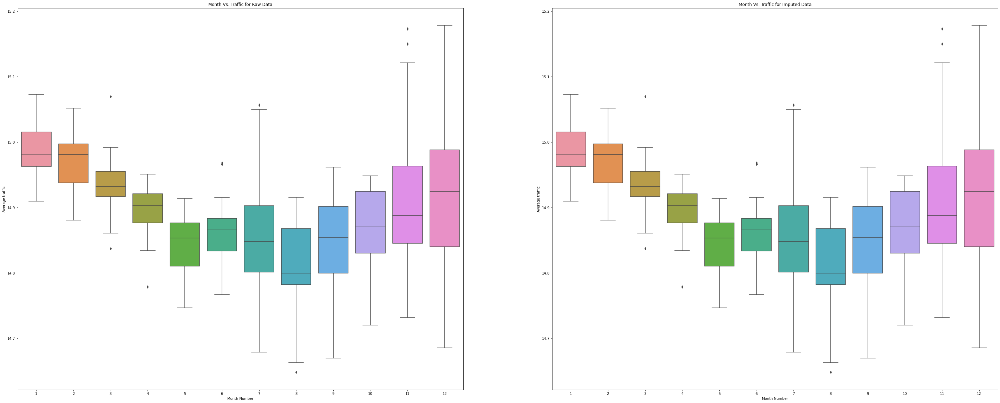

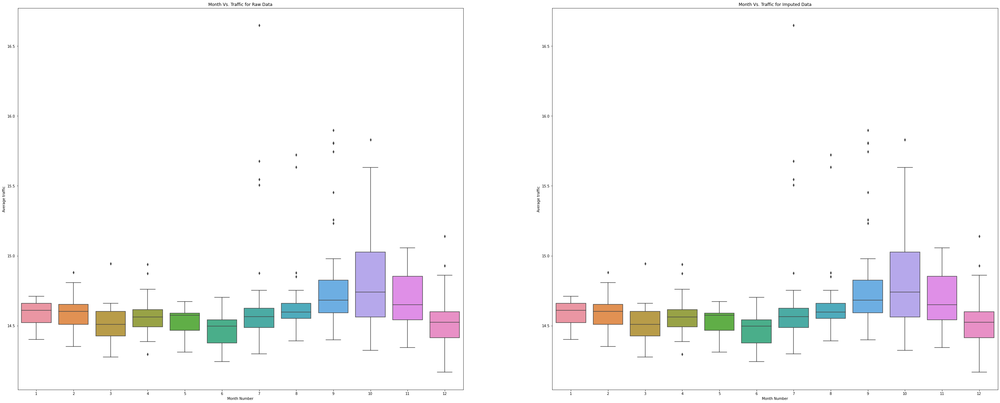

...

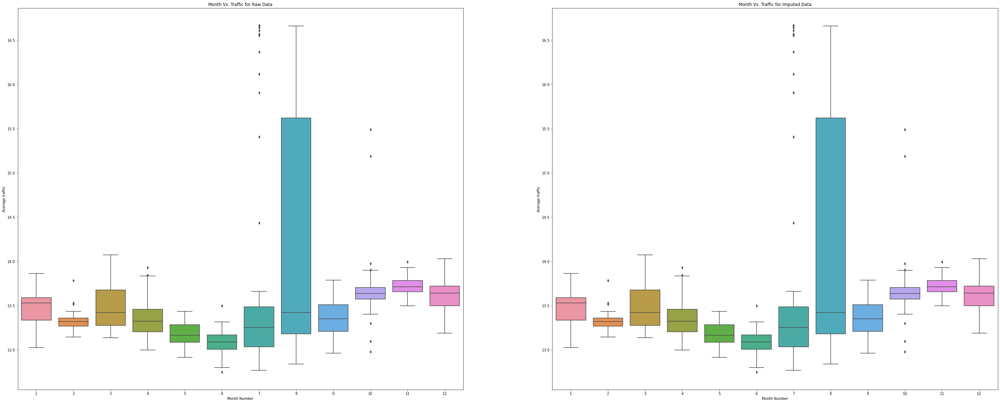

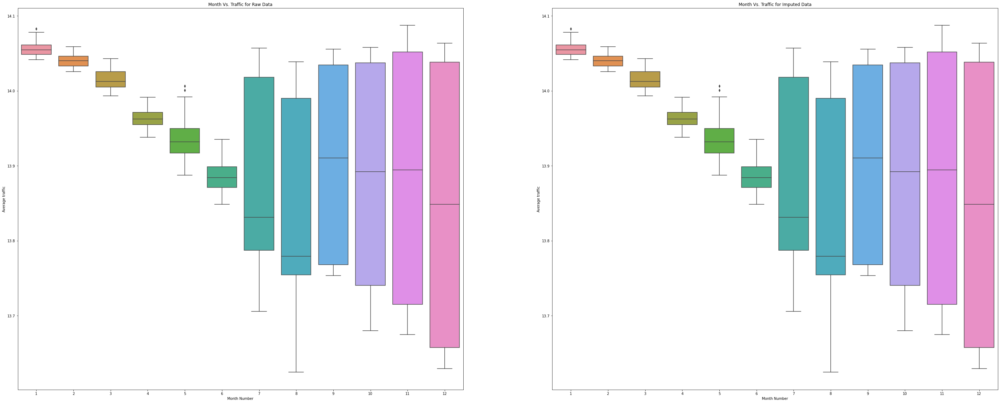

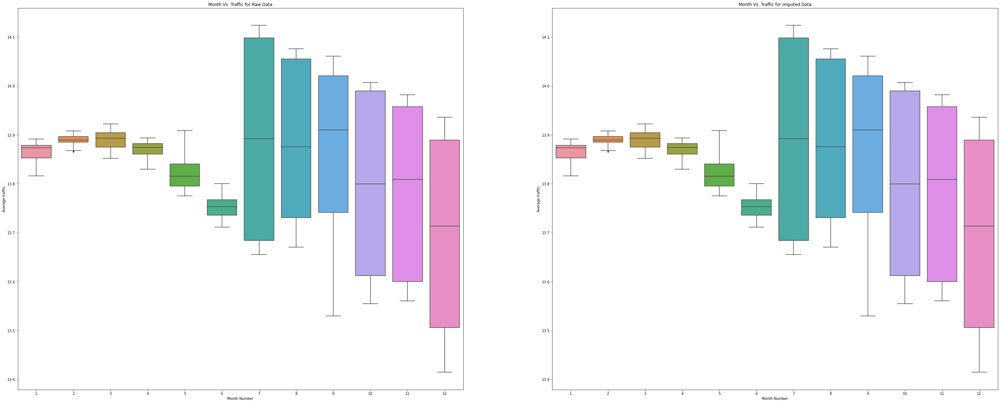

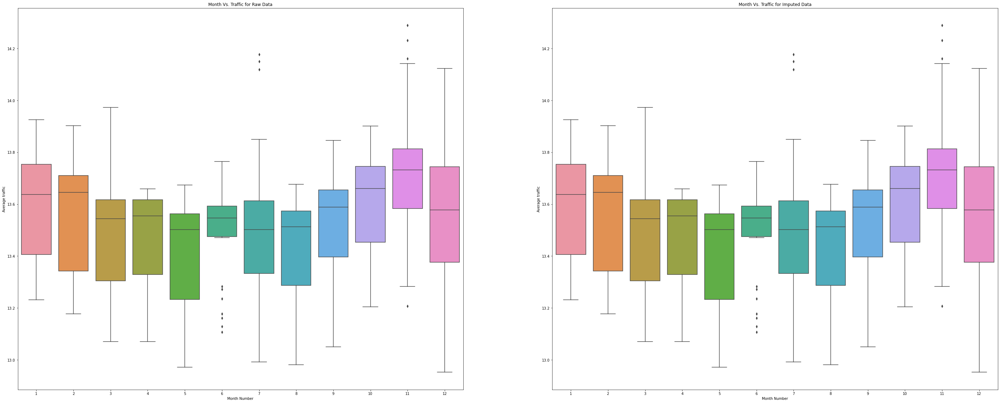

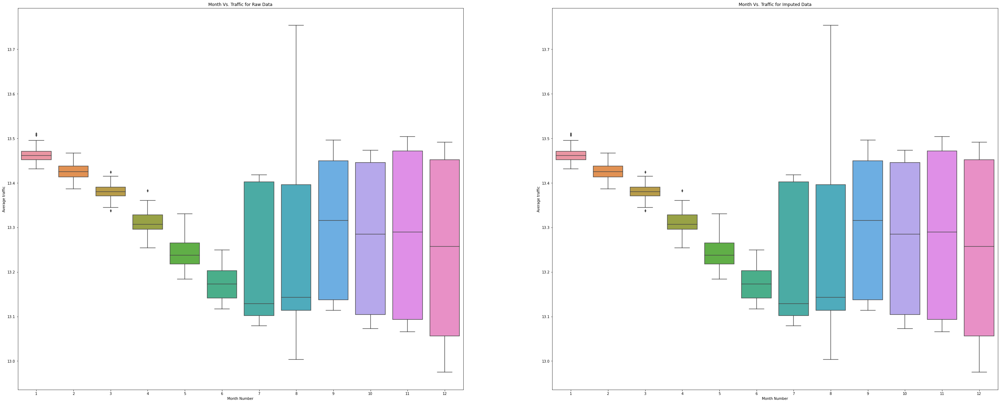

In [36]:
# Boxplots of month vs. average pagehits for transformed data
import seaborn as sns
for i in range(0,15):
    rawhits=eda_log_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_log_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=month,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Month Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Month Vs. Traffic for Raw Data')
    sns.boxplot(x=month,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Month Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Month Vs. Traffic for Imputed Data')
    
    plt.show()


- The boxplots of each month are somewhat different from one another. 
- The IQR is much smaller for much smaller for months in first half of the year and quite high in the second half. 
- In some cases the IQR for August is much high 
- So month number and year half can be used as a feature . 

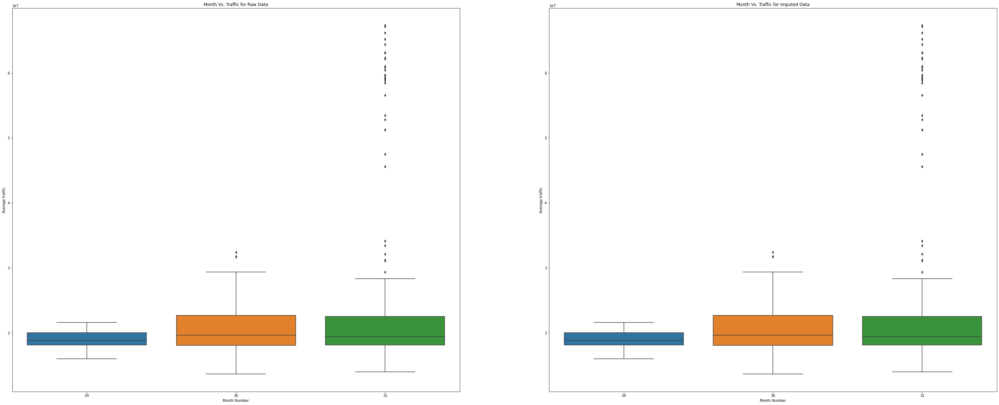

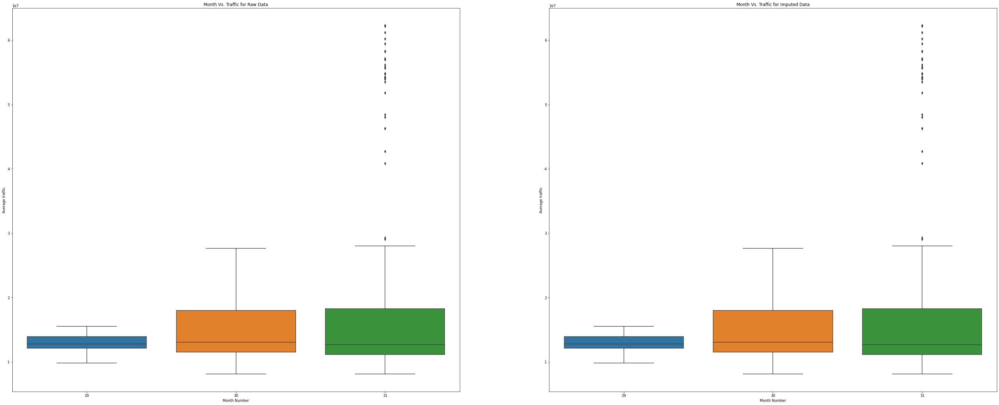

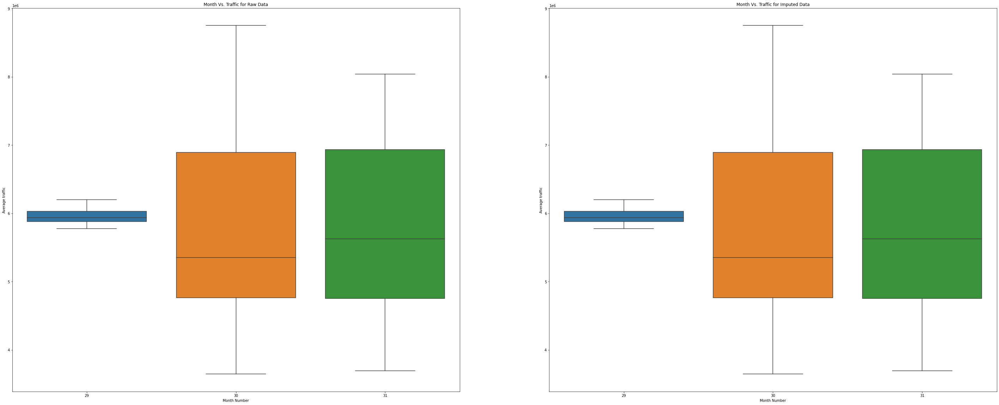

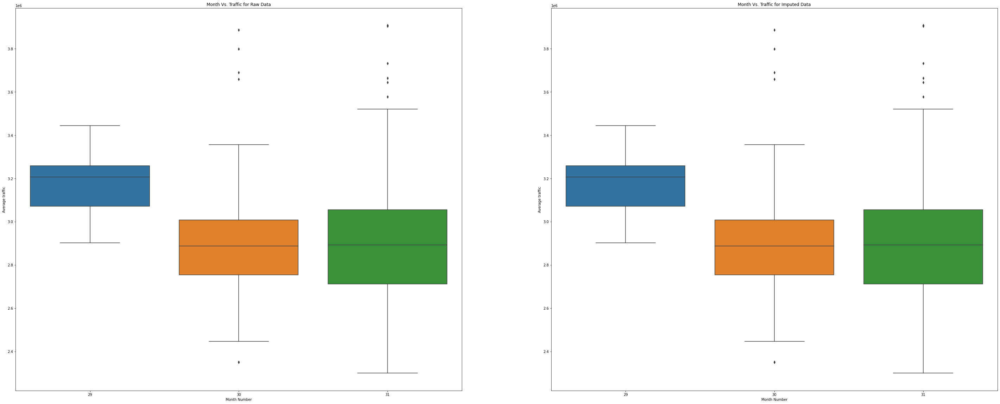

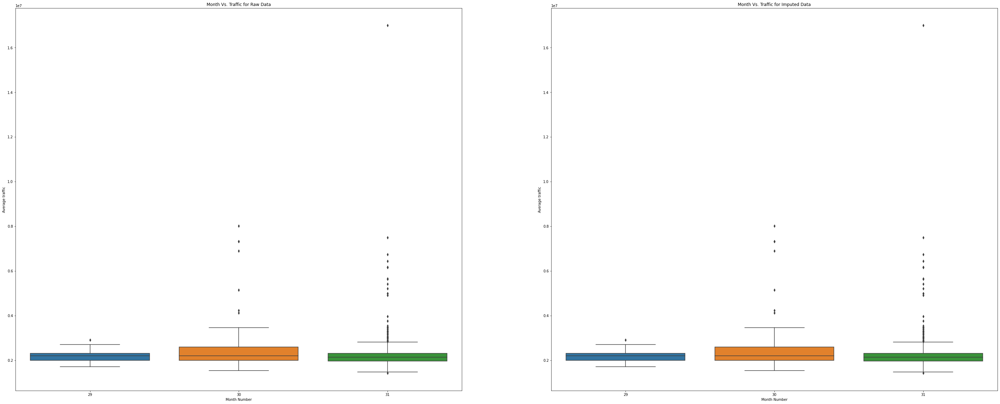

...

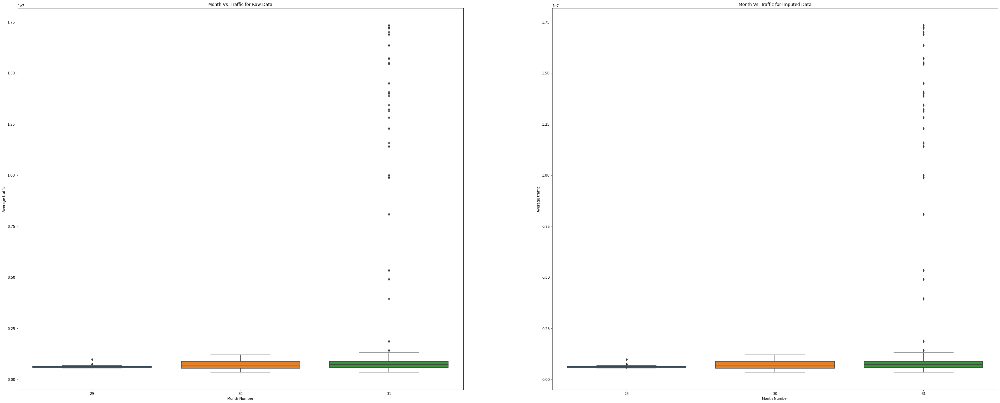

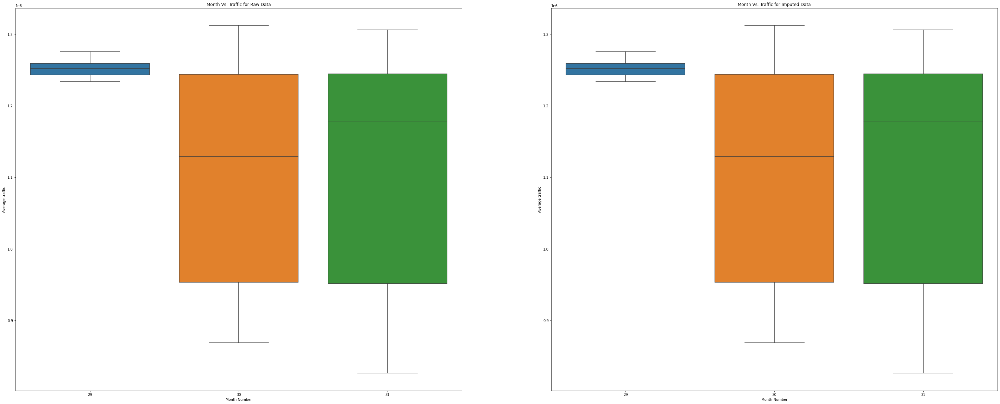

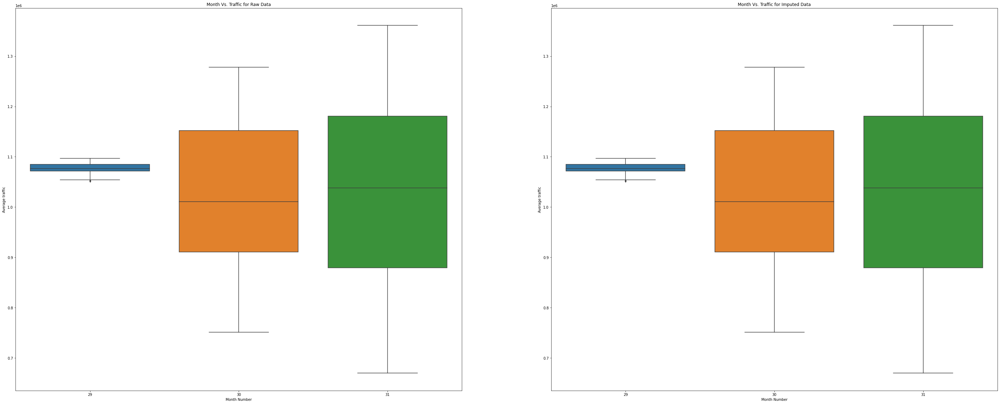

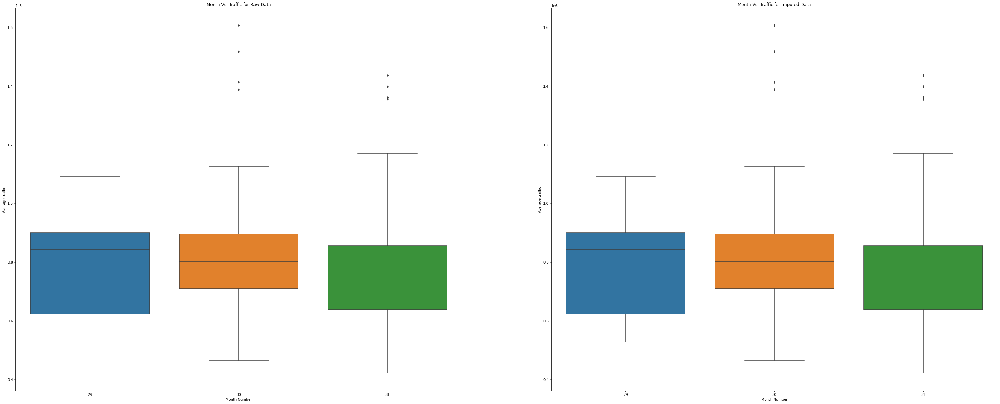

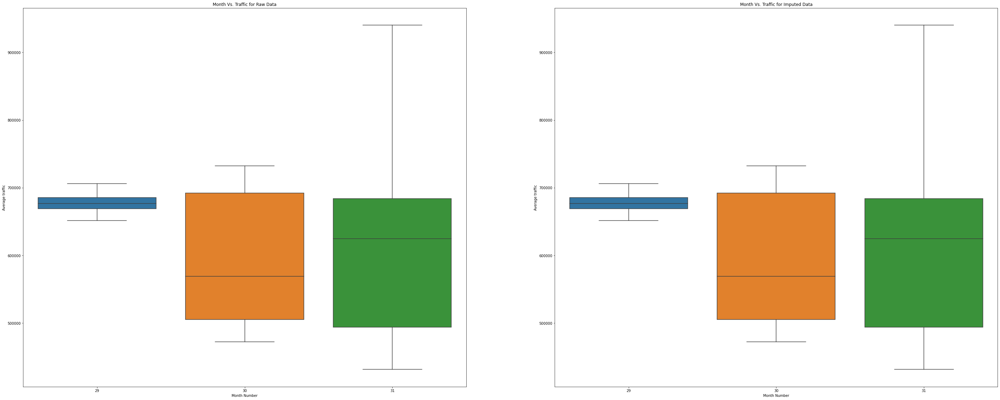

In [37]:
# Boxplots of number of days in a month vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=days_in_month,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Month Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Month Vs. Traffic for Raw Data')
    sns.boxplot(x=days_in_month,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Month Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Month Vs. Traffic for Imputed Data')
    
    plt.show()


- In some cases February is having much higher pagehit values as compared to other months.

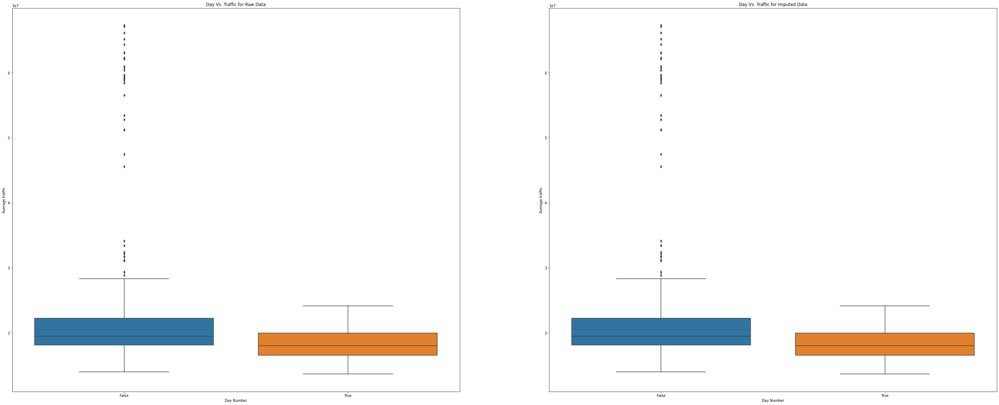

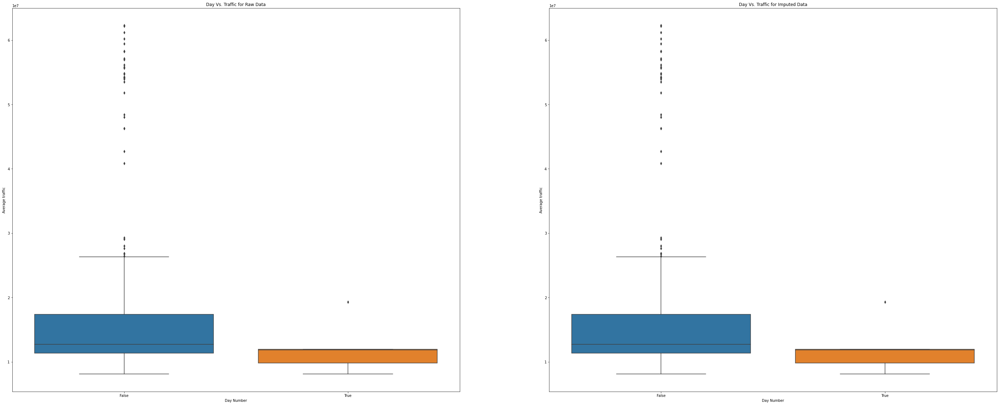

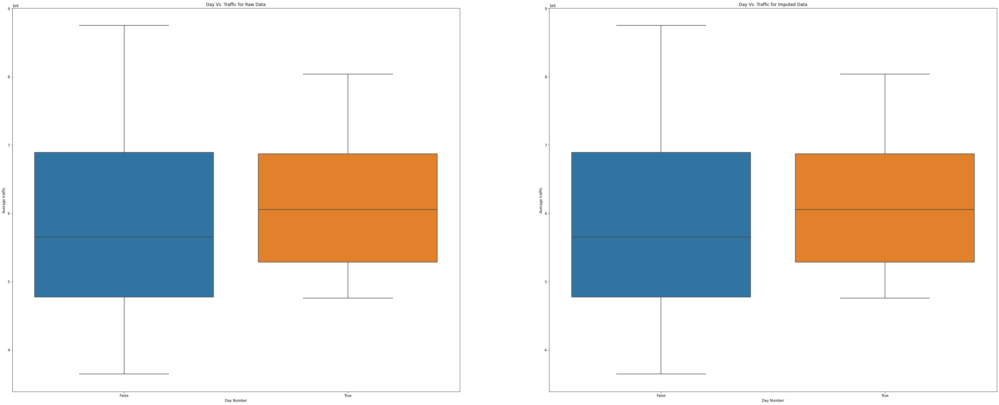

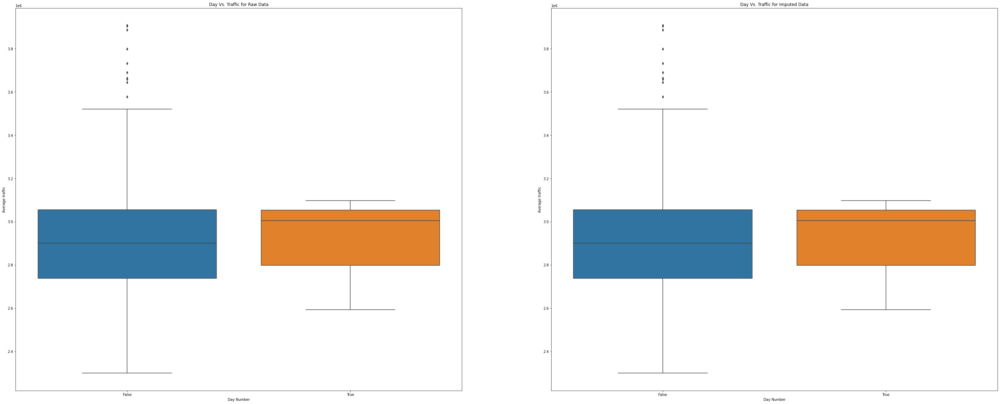

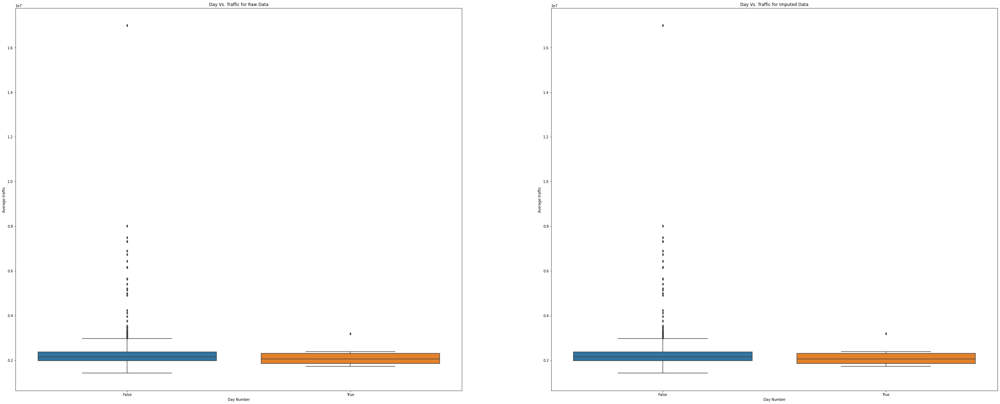

...

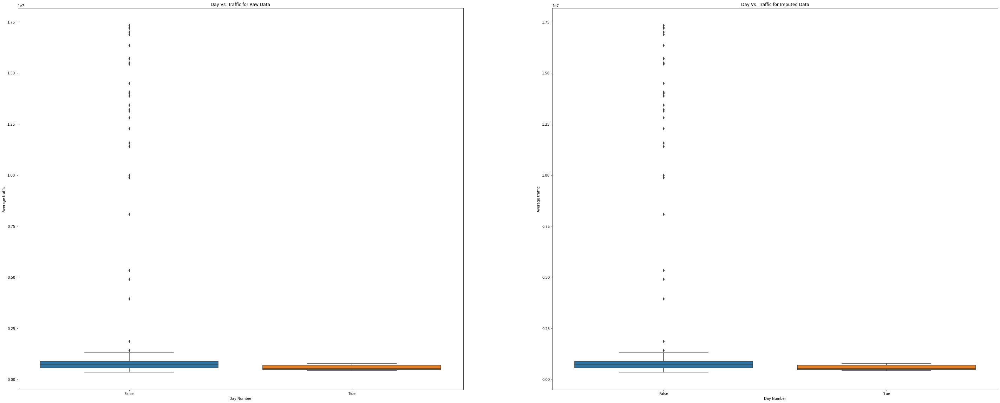

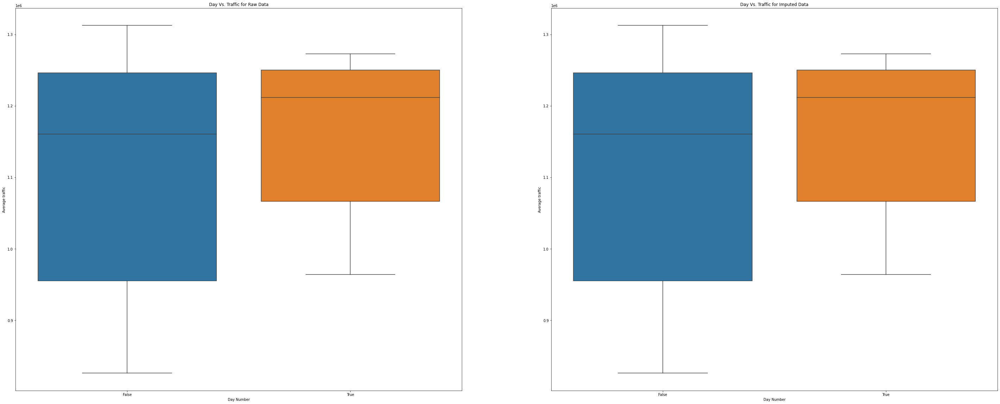

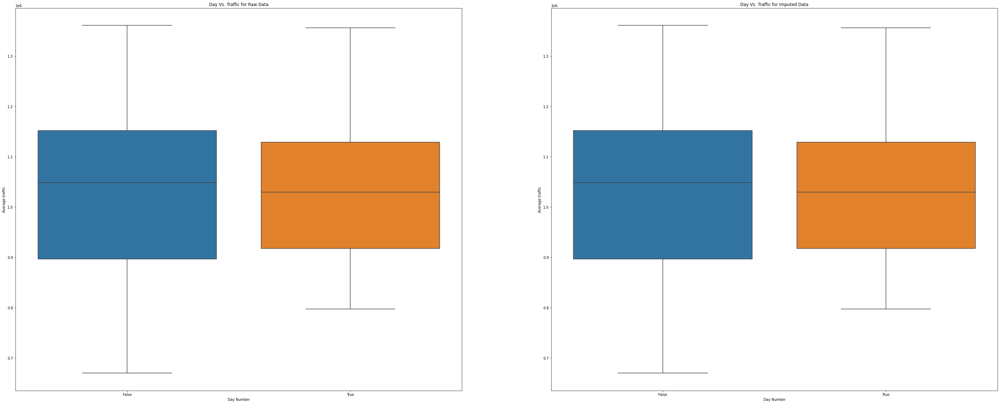

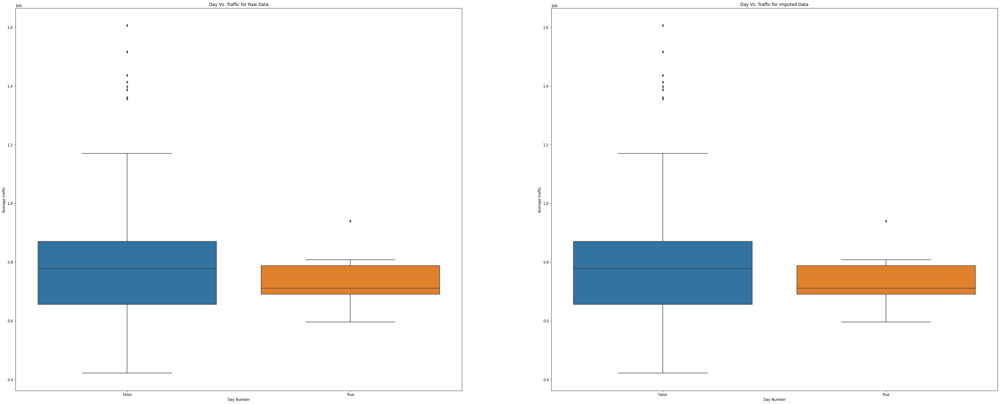

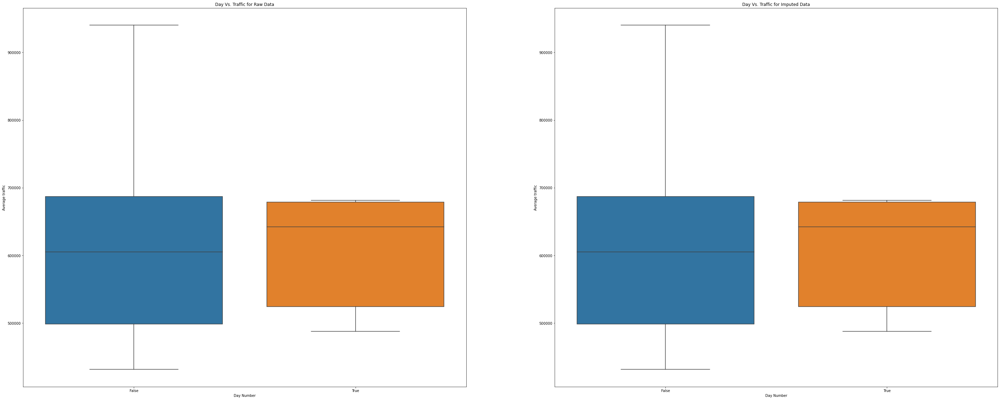

In [38]:
# Boxplots of month_start vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=quarter_start,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=quarter_start,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


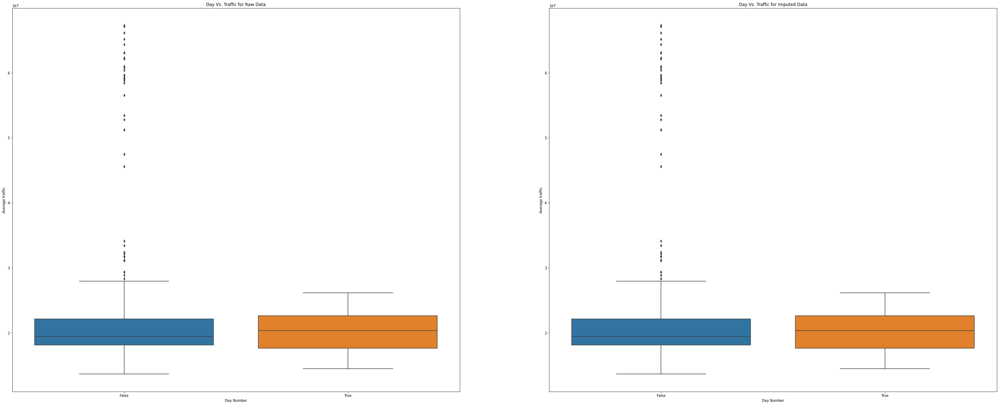

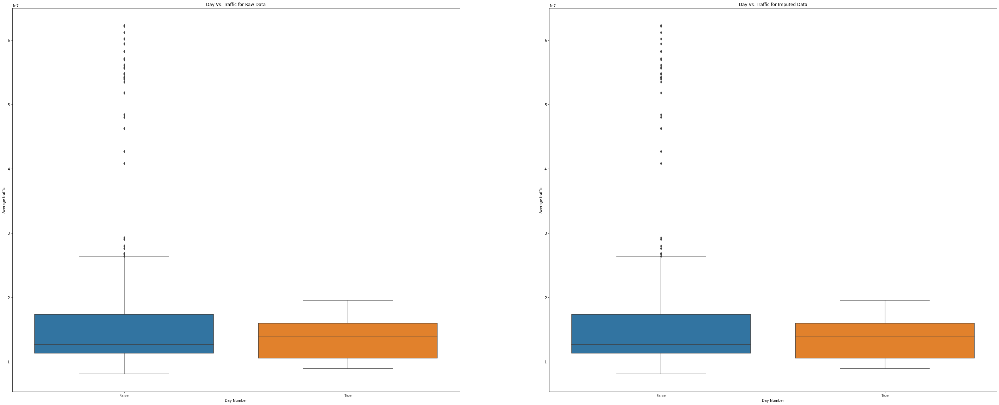

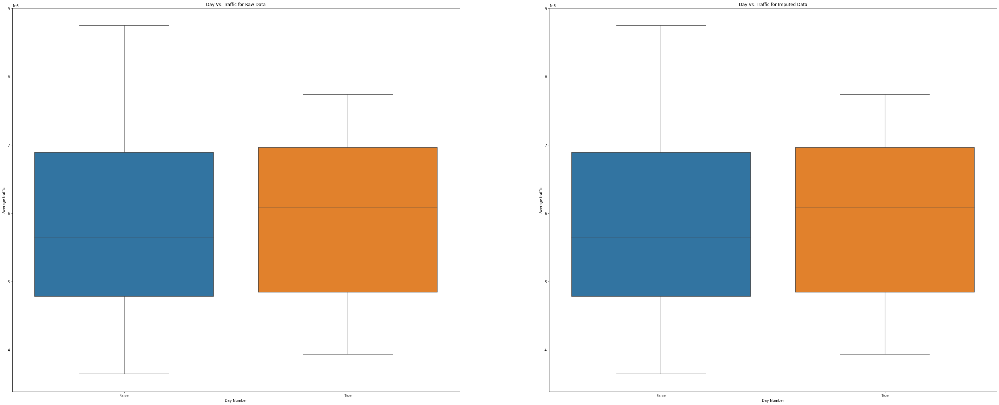

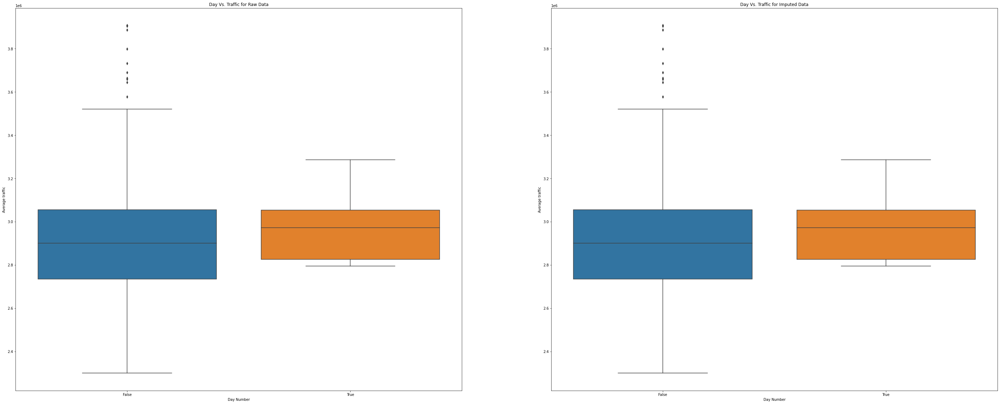

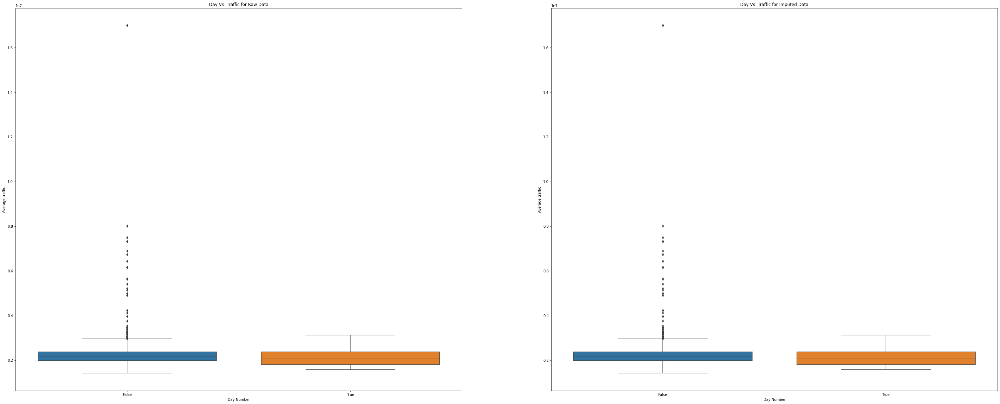

...

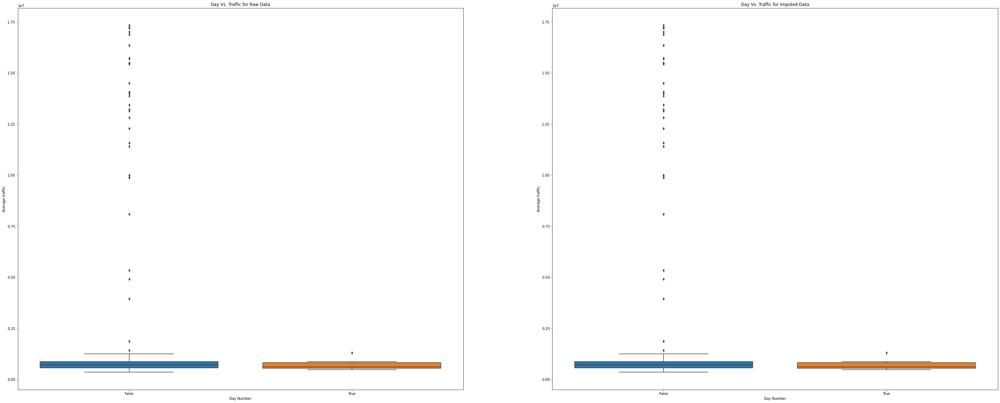

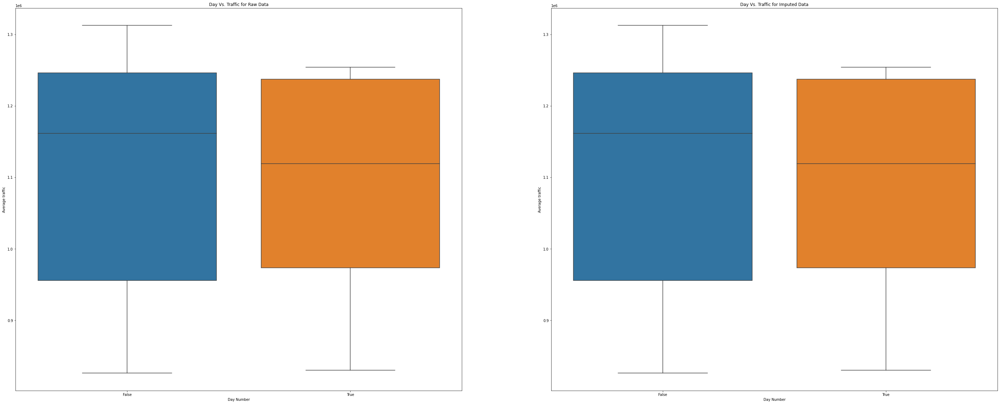

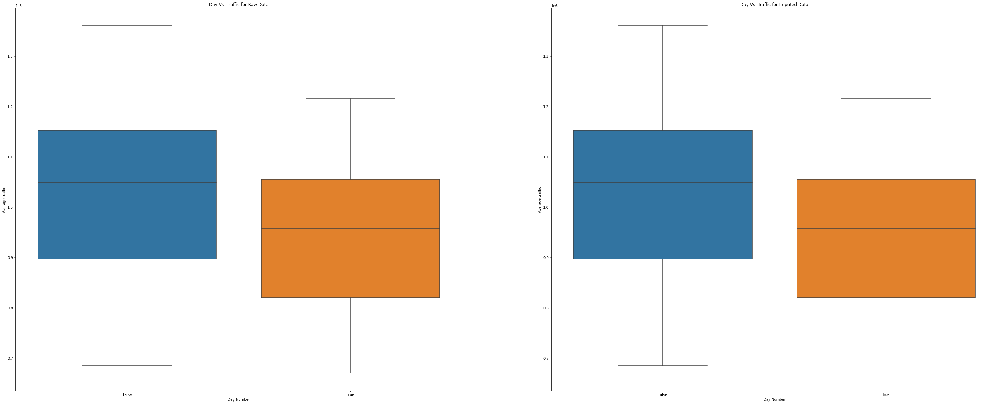

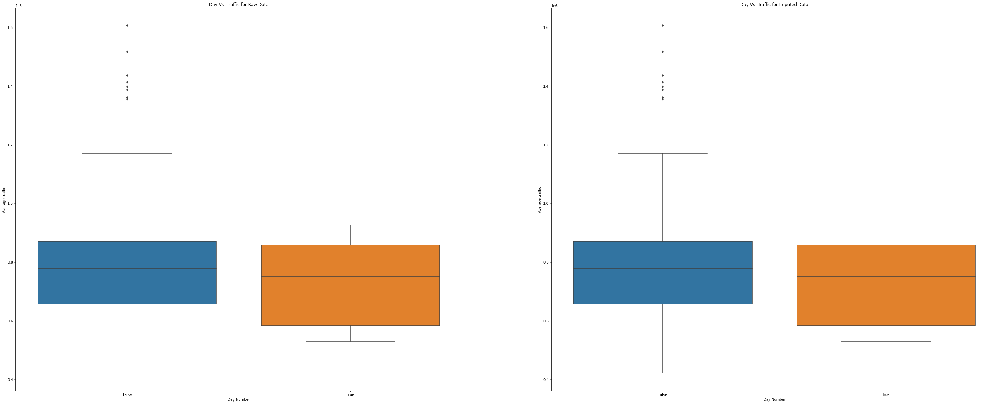

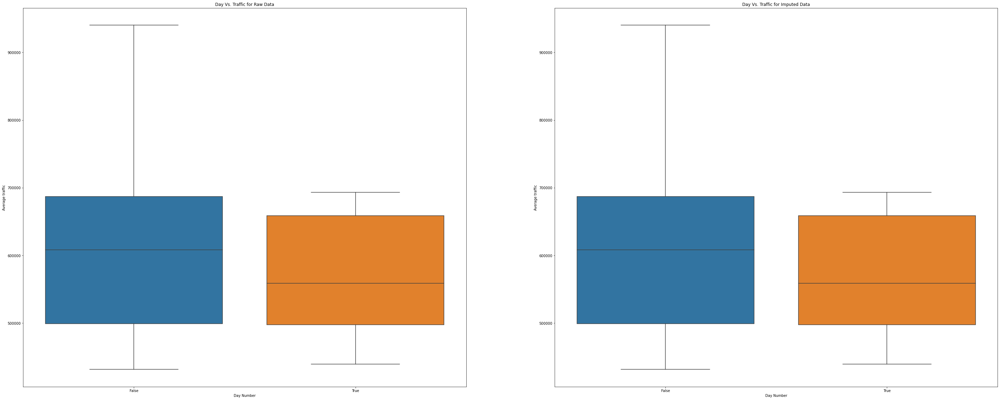

In [39]:
# Boxplots of quarter_end vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=quarter_end,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=quarter_end,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


- As Quarter_start and  quarter_end are parts of month_start and month_end there are similarities in the boxplots.

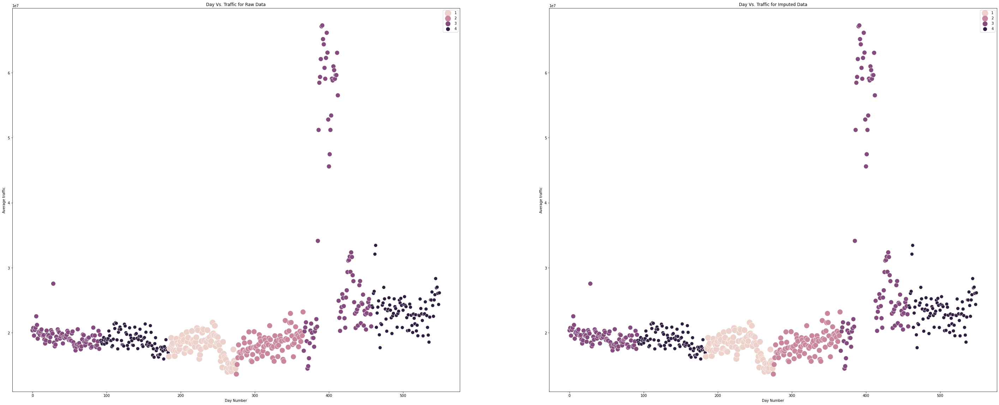

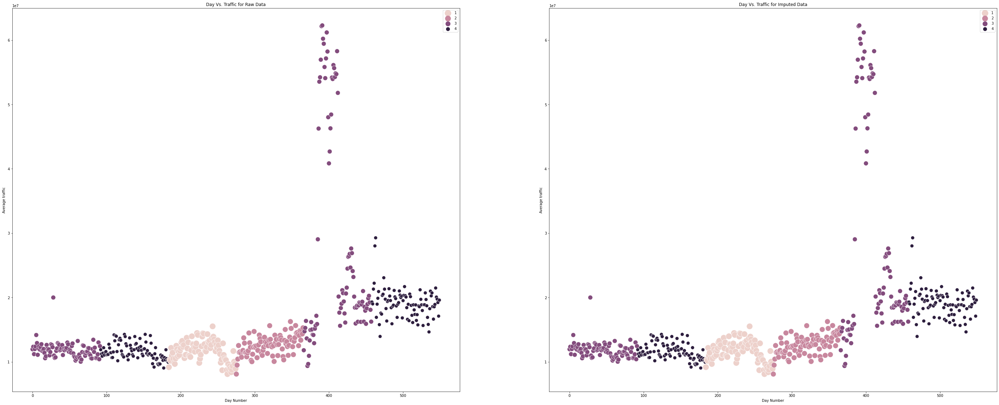

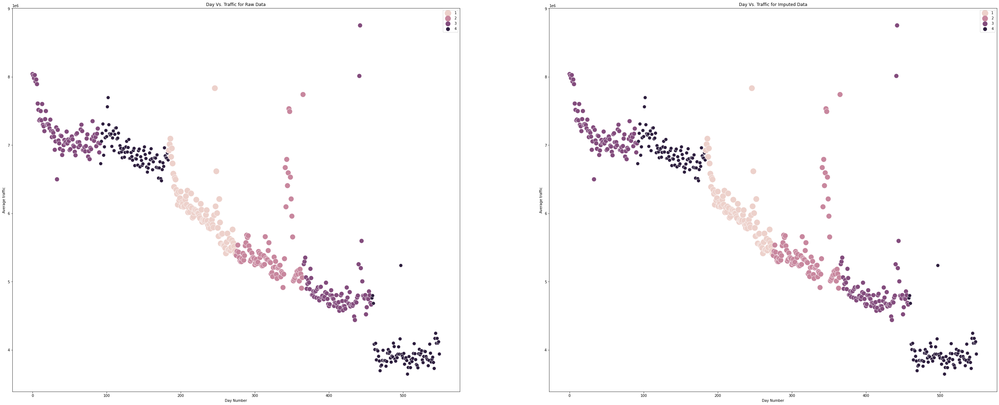

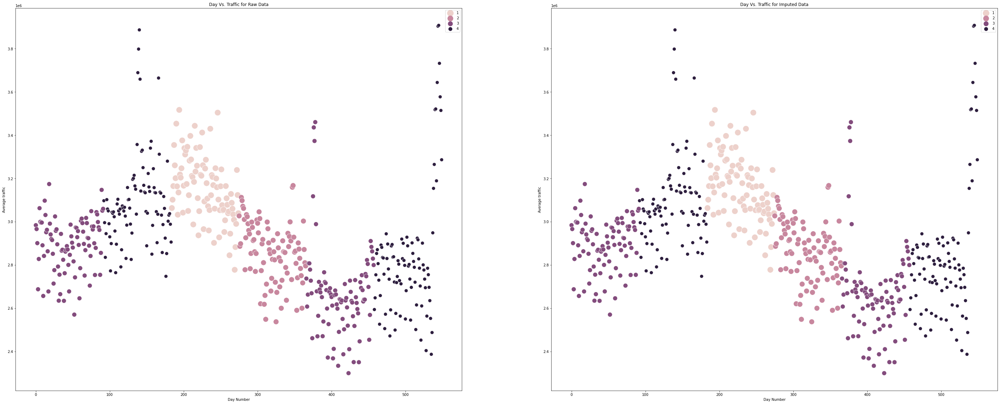

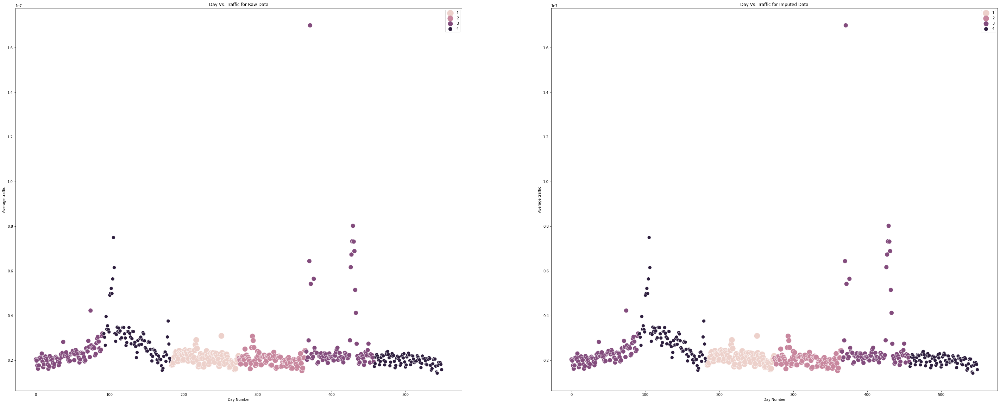

...

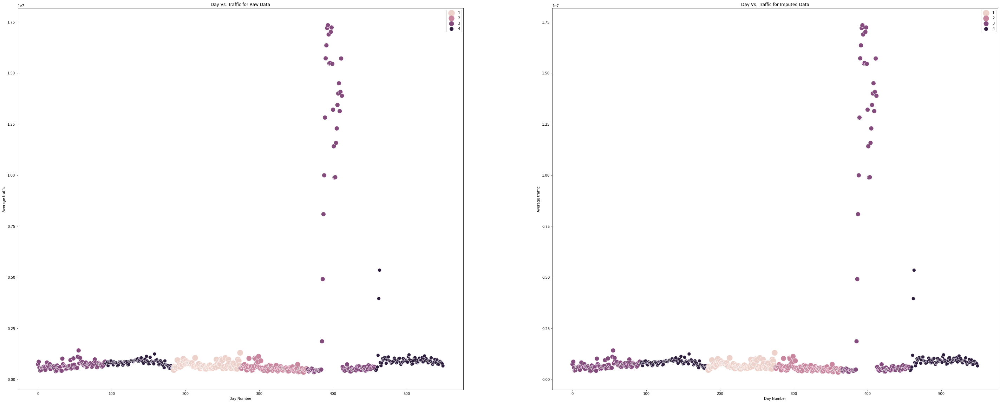

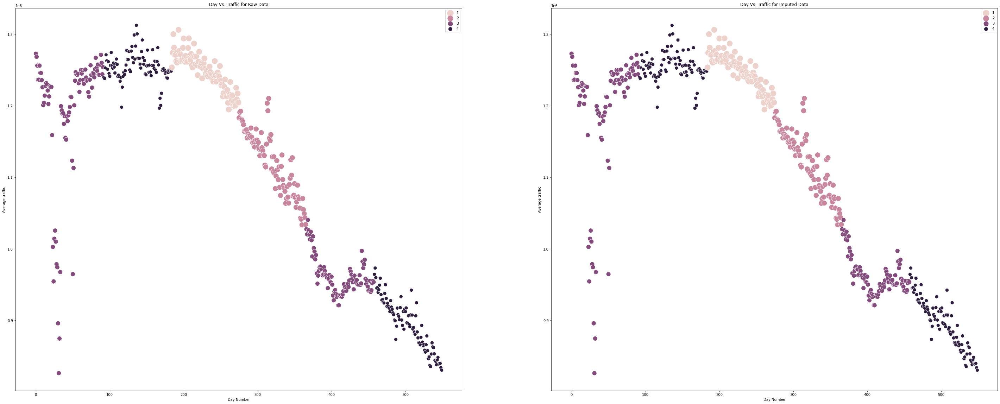

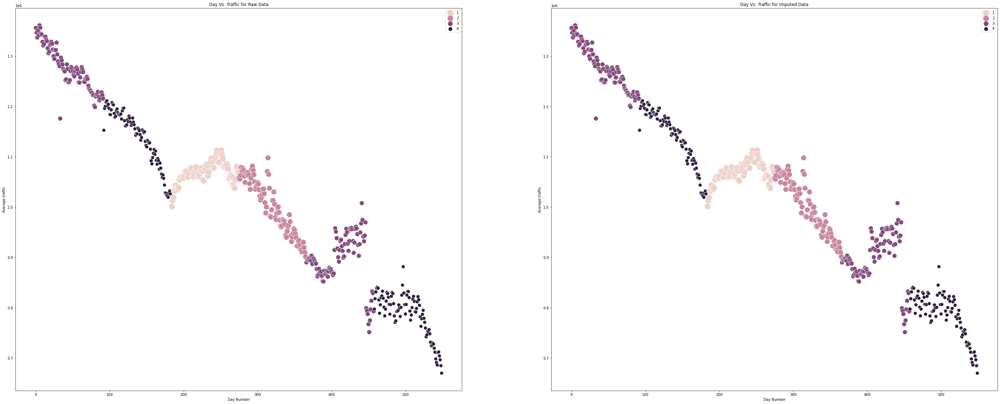

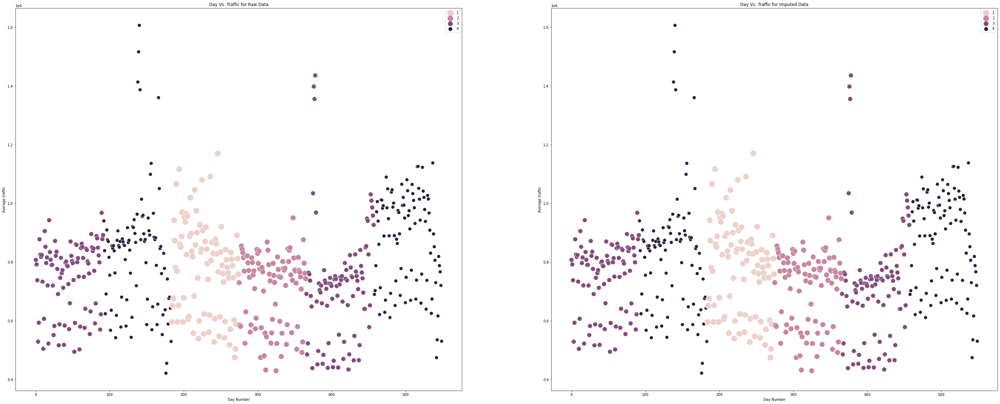

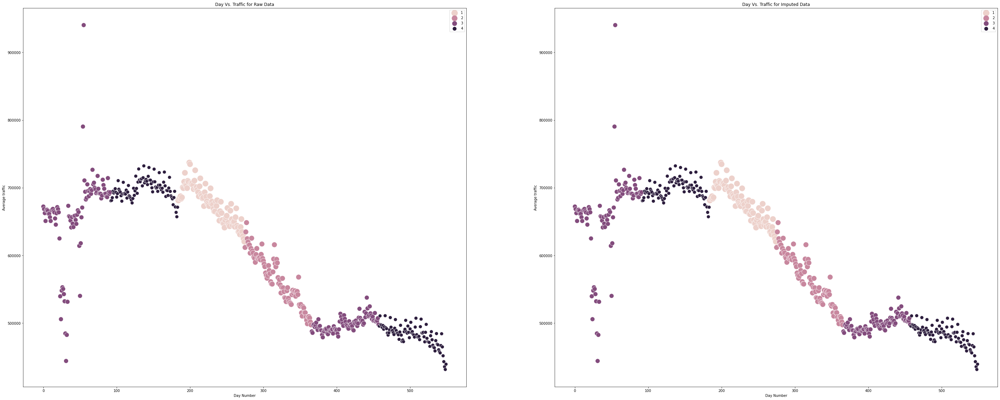

In [40]:
# Boxplots of quarter vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.scatterplot(x=range(550),y=rawhits,hue=quarter,ax=axes[0],sizes=(300,100),size=quarter)
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.scatterplot(x=range(550),y=imphits,hue=quarter,ax=axes[1],sizes=(300,100), size=quarter)
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


- For different quarters the pagehit values are different.
- This along with quarter start and quarter end feature can give me accurate idea of traffic

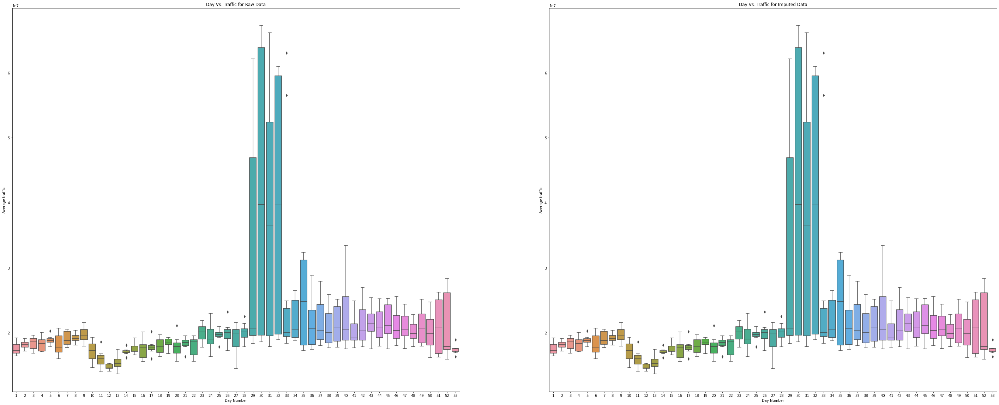

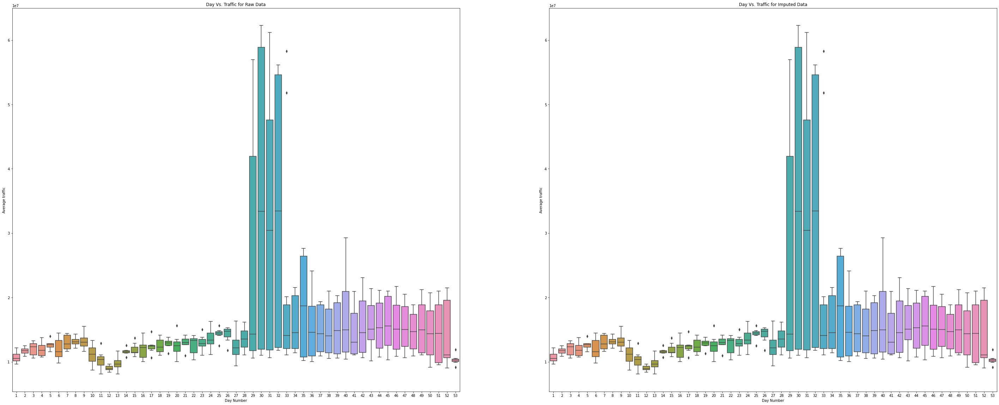

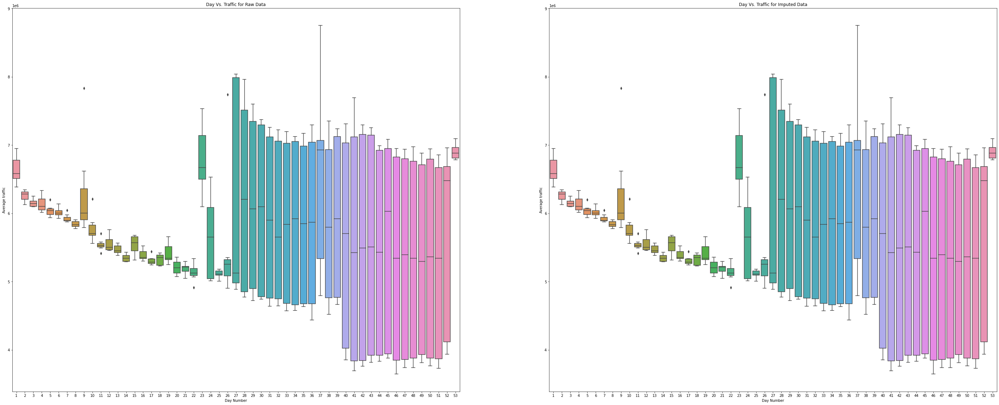

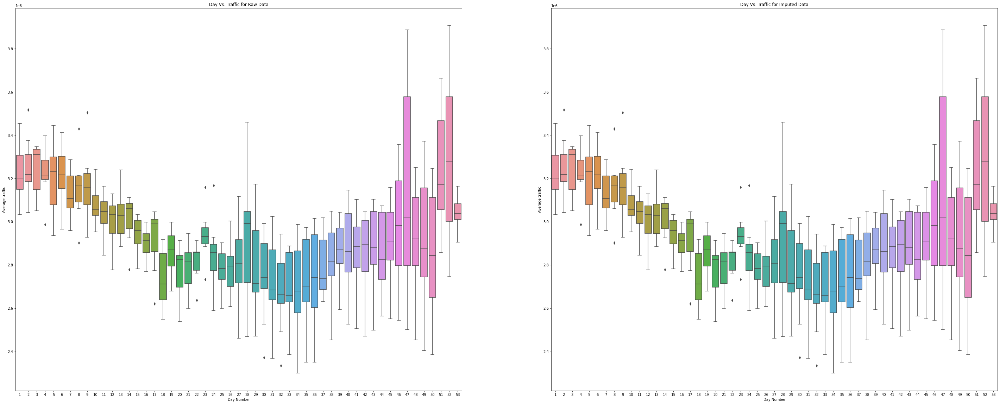

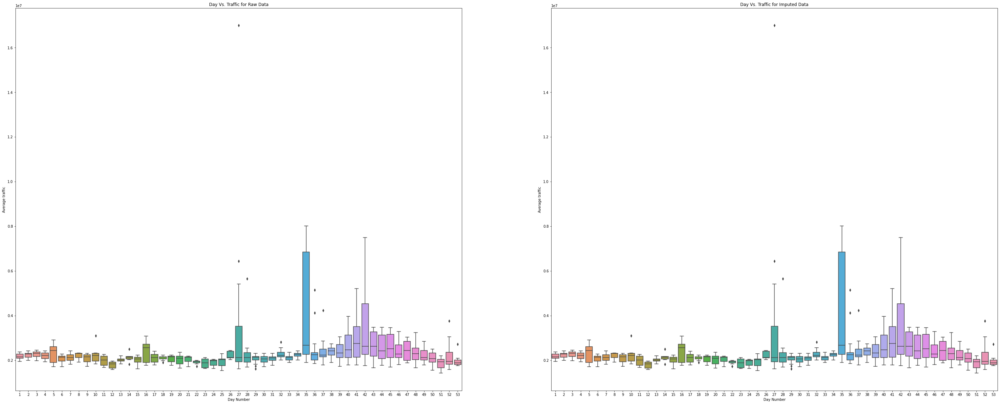

...

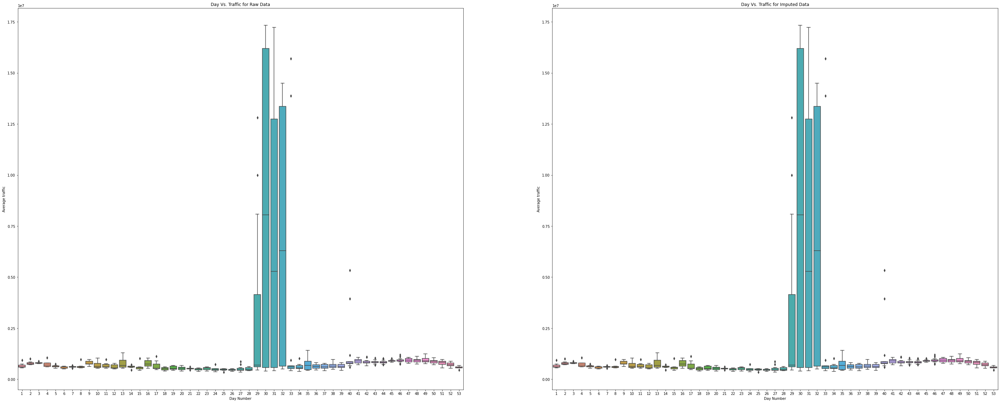

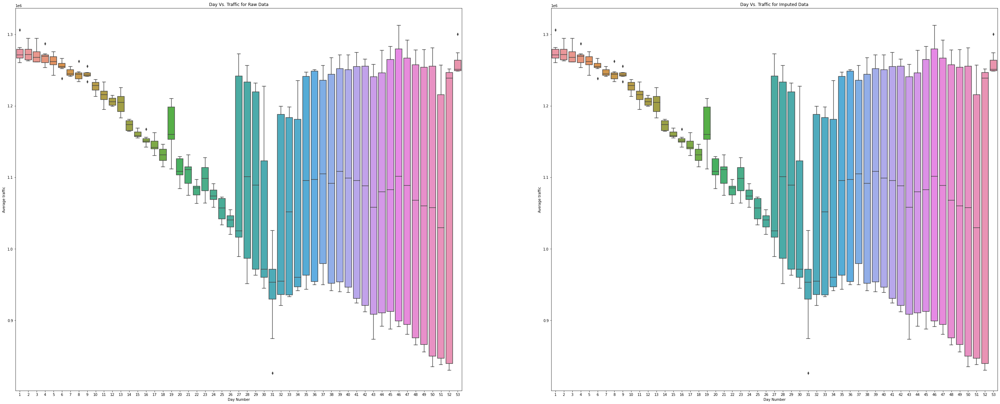

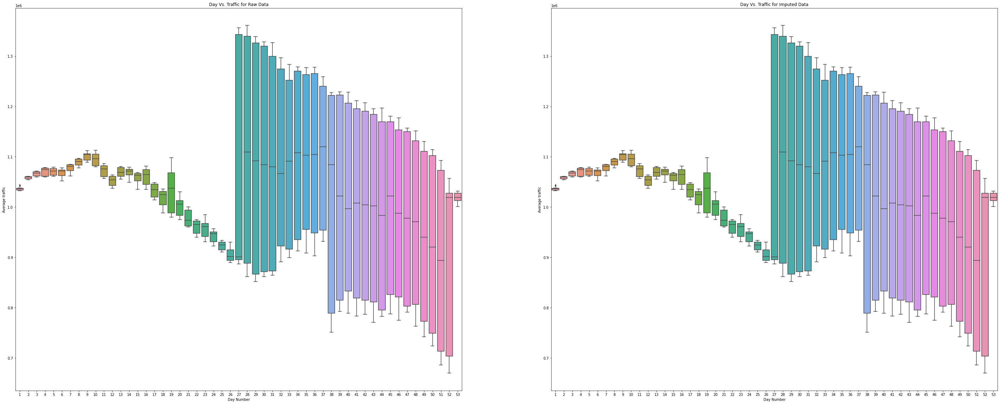

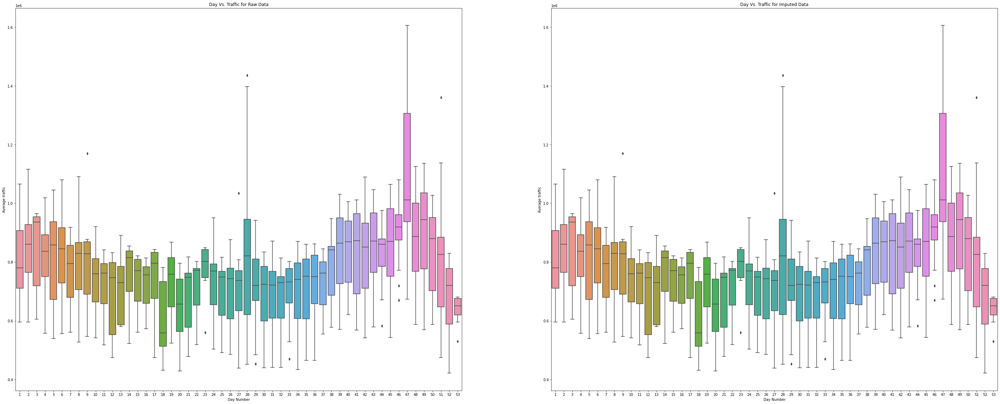

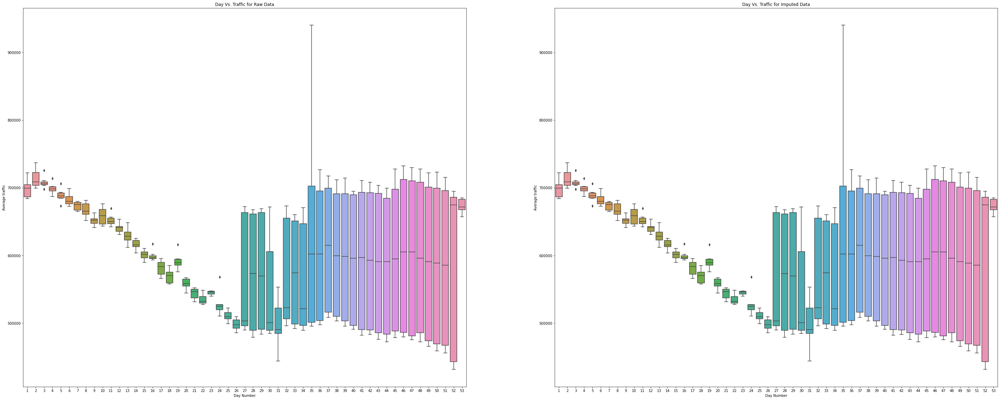

In [41]:
# Boxplots of week vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=week,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=week,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


- As seen earlier the second half of the year has higher pagehit values.
- Similarly here the weeks in the second half of the year shows the same pattern.

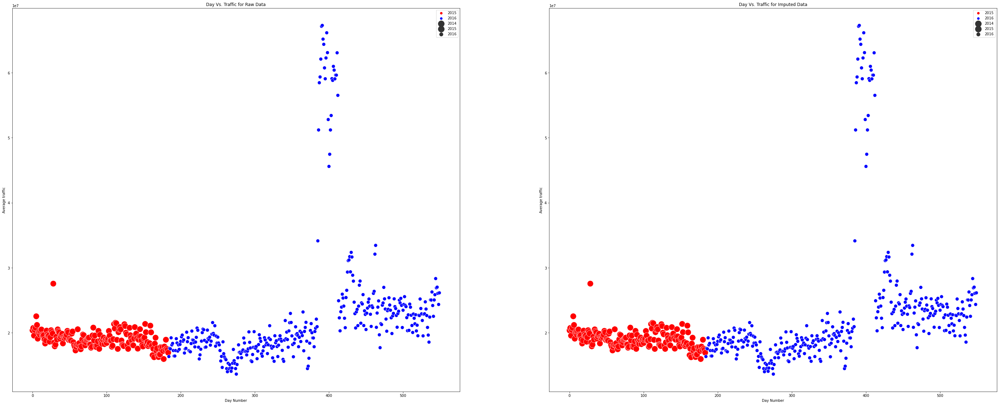

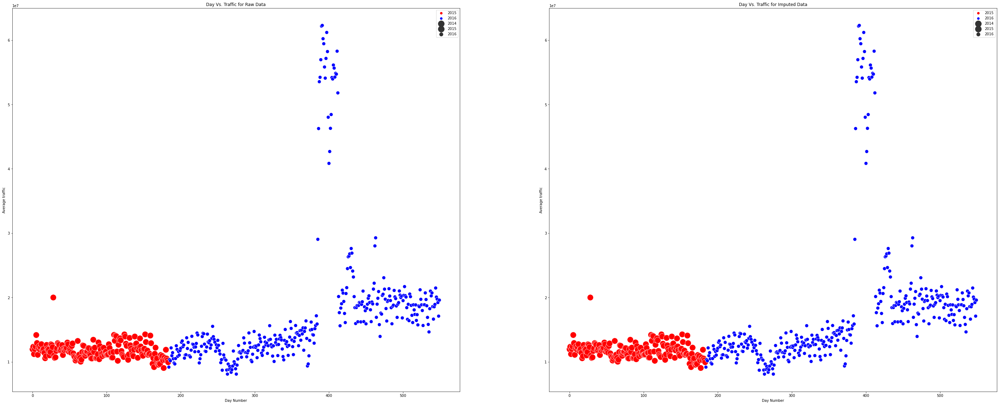

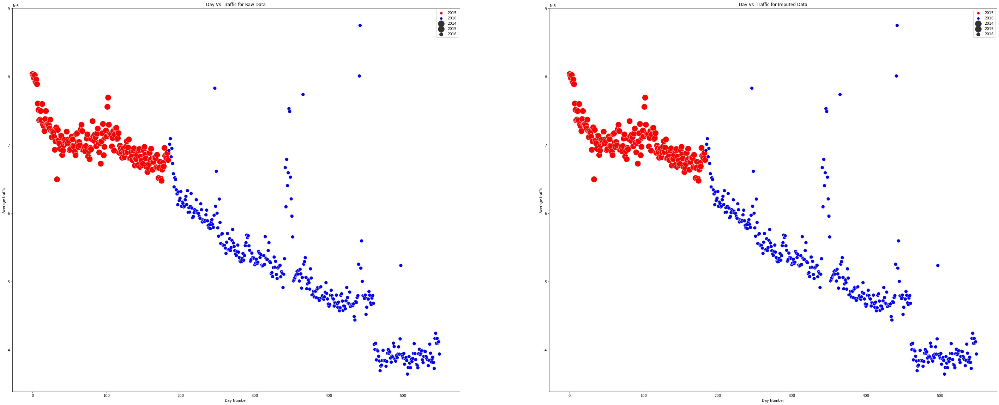

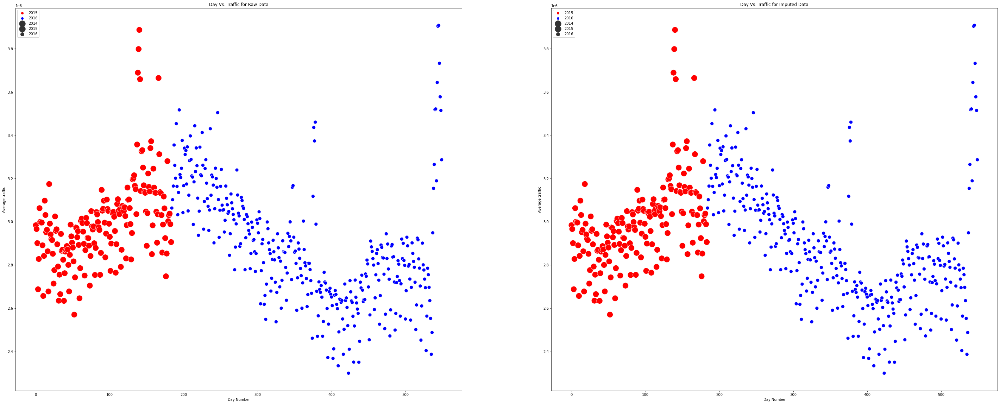

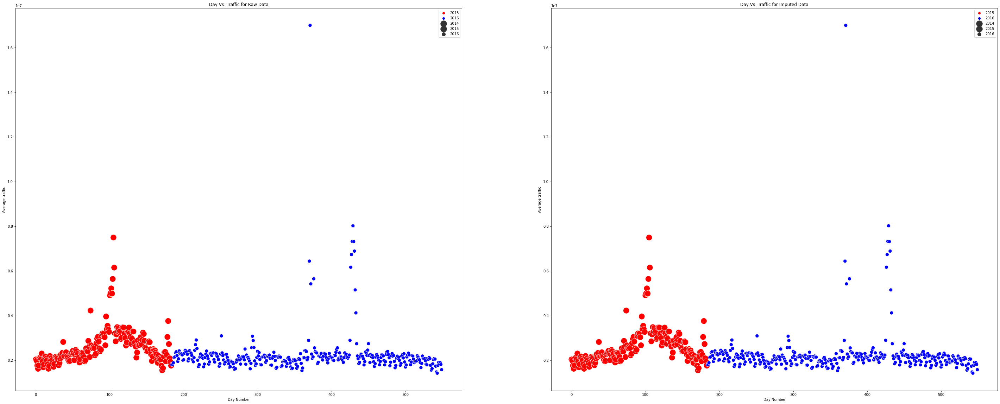

...

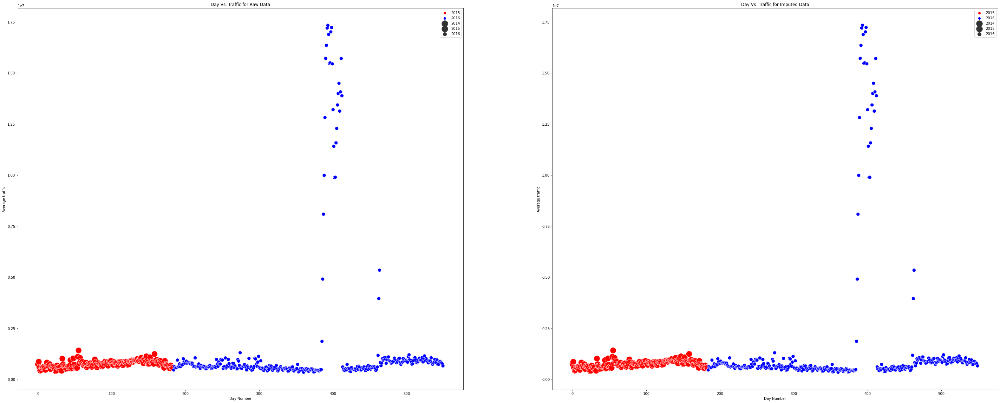

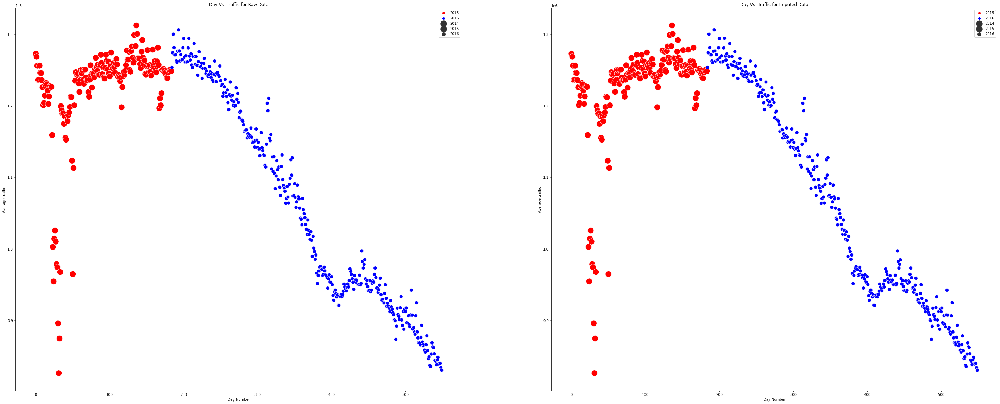

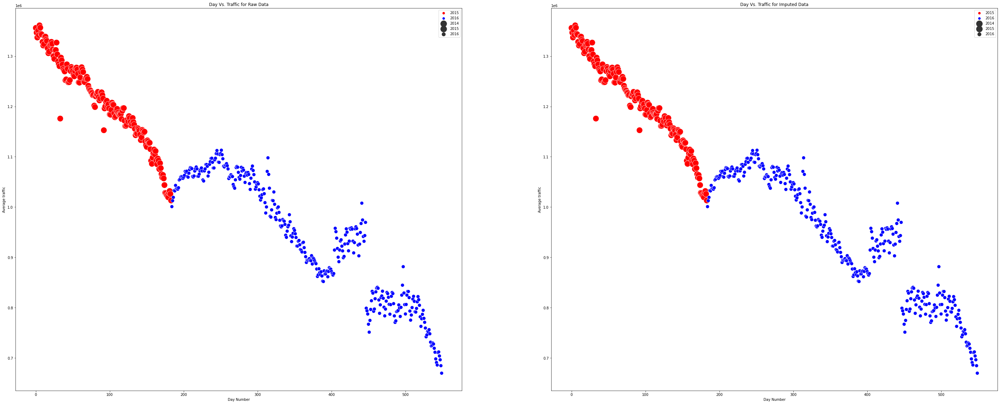

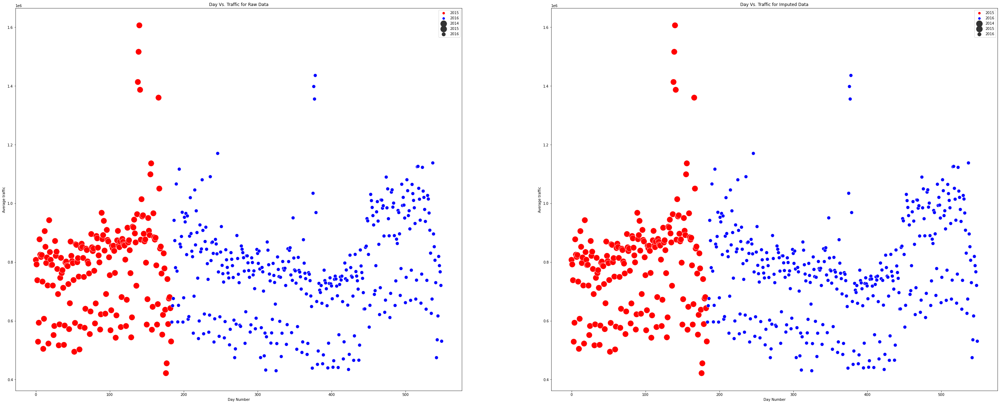

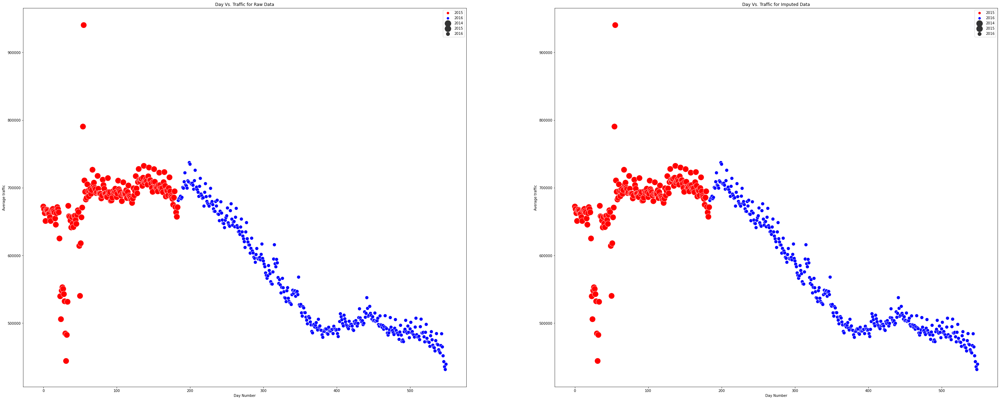

In [42]:
# Scatterplot of year vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.scatterplot(x=range(550),y=rawhits,hue=year,ax=axes[0],sizes=(300,100),size=year,palette=['red','blue'])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.scatterplot(x=range(550),y=imphits,hue=year,ax=axes[1],sizes=(300,100), size=year,palette=['red','blue'])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


- In most of the cases there is an increase in pagehit values in 2015 and decrease in 2016
- Again there is a downward trend from 2015 which continues to 2016

### Bivariate Analysis

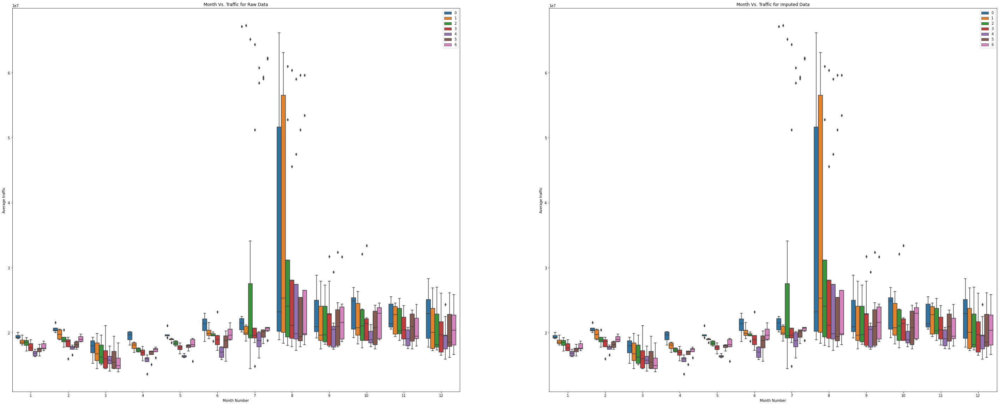

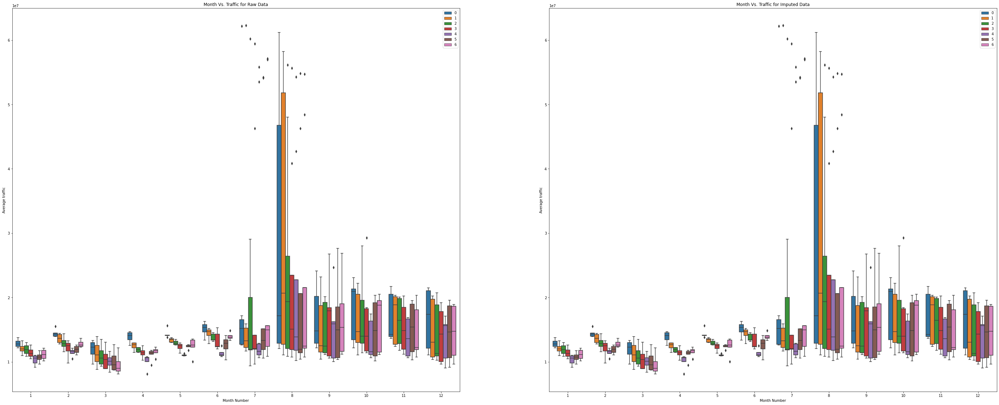

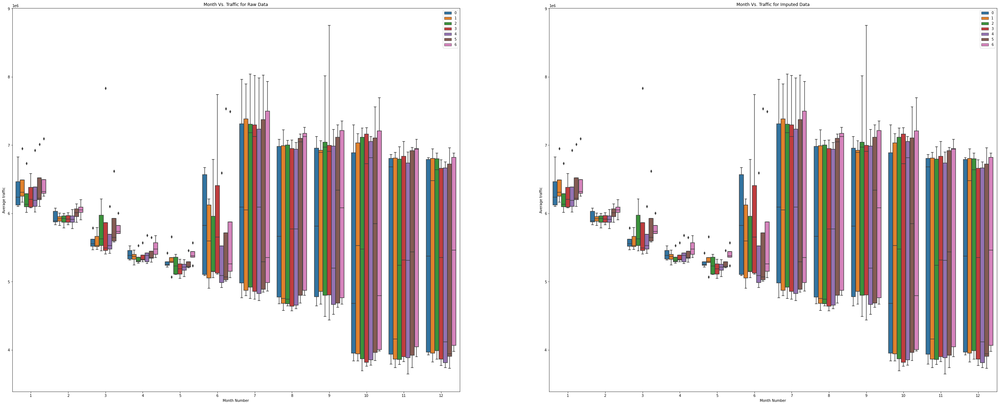

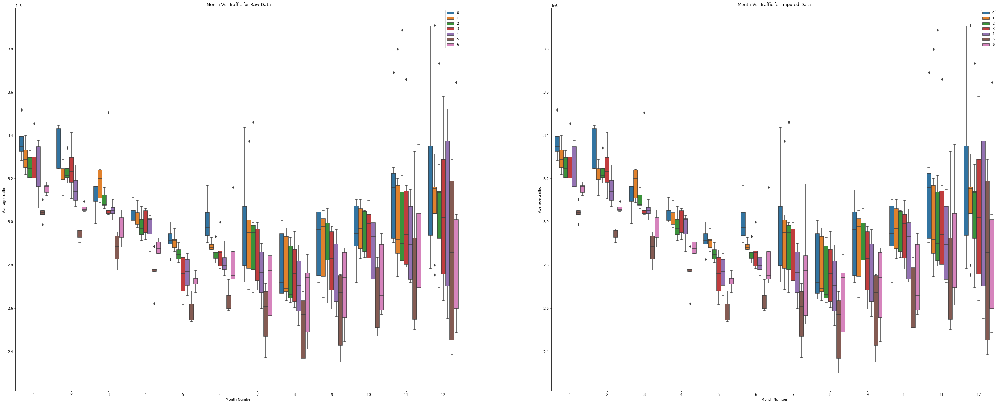

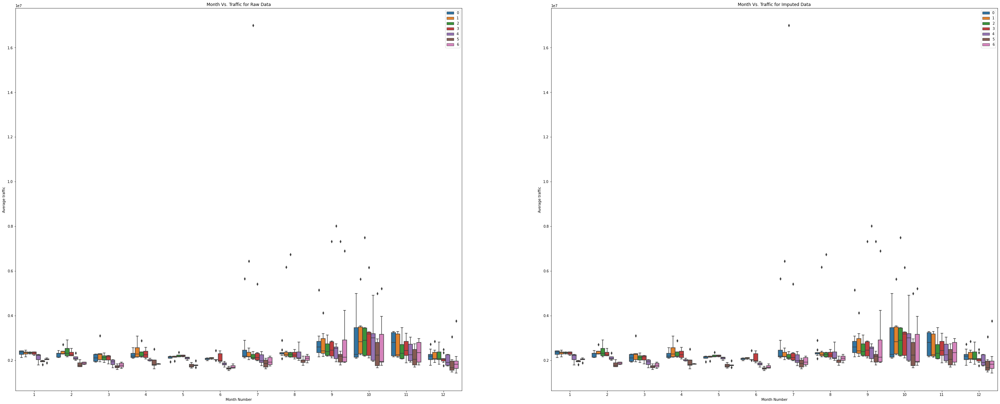

...

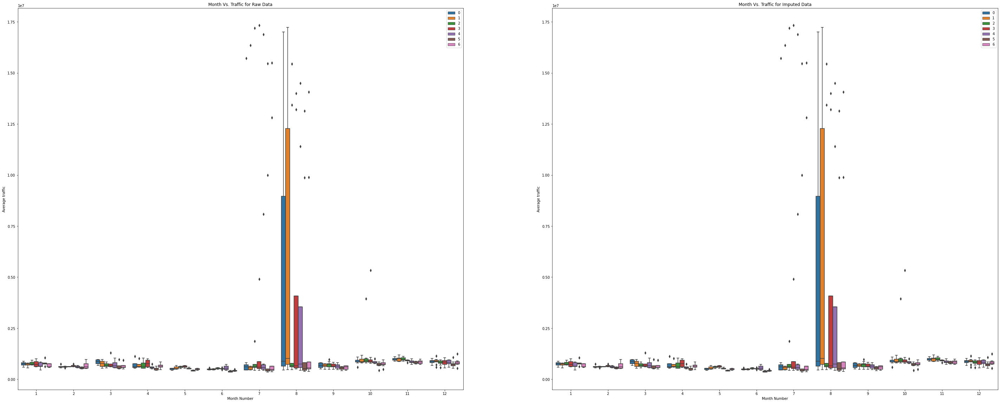

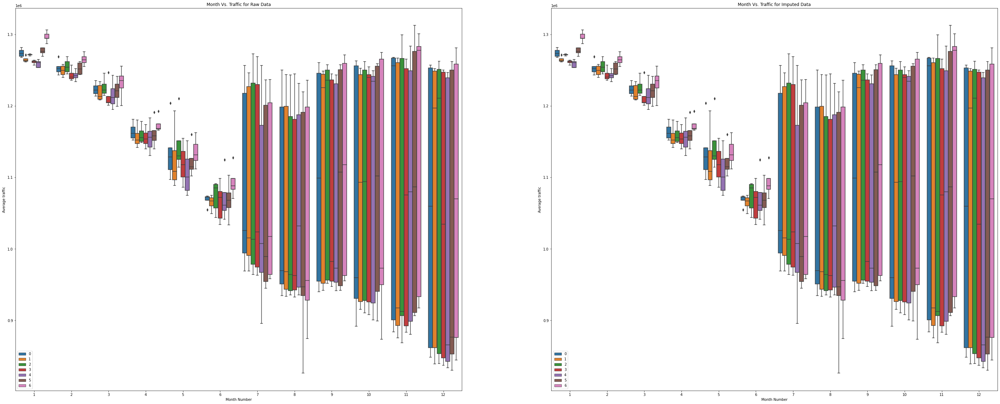

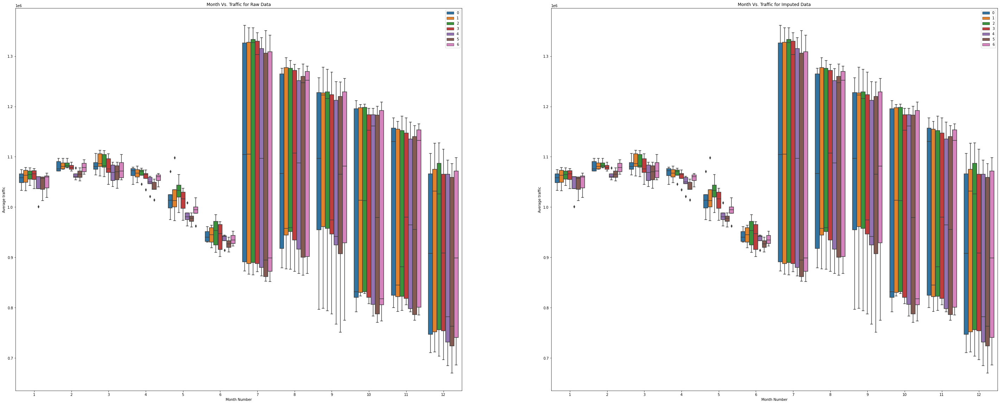

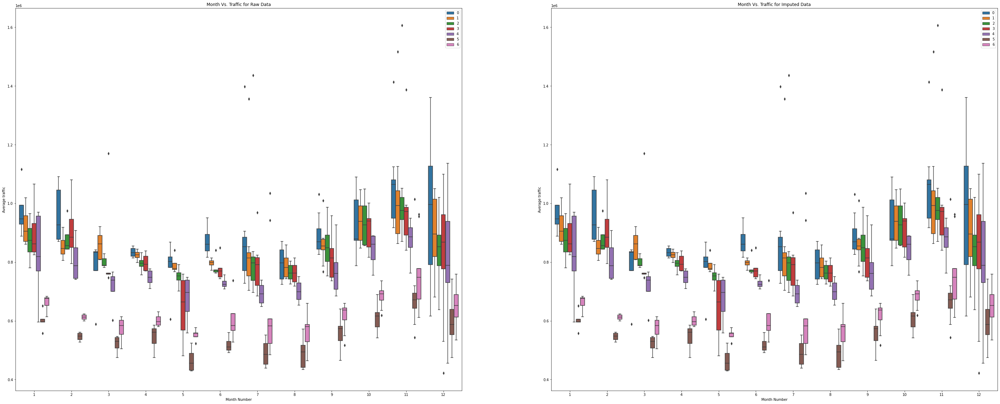

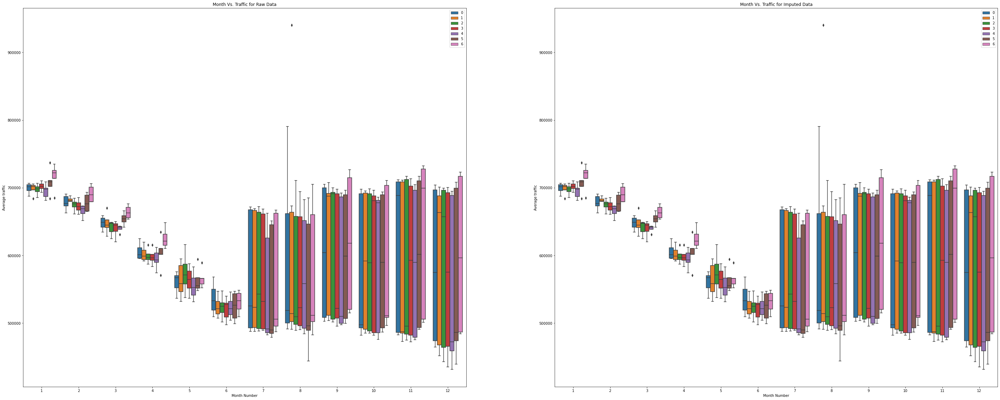

In [43]:
 # Boxplots of weekdays vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=month,y=rawhits,ax=axes[0],hue=weekday)
    axes[0].set_xlabel('Month Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Month Vs. Traffic for Raw Data')
    sns.boxplot(x=month,y=imphits,ax=axes[1],hue=weekday)
    axes[1].set_xlabel('Month Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Month Vs. Traffic for Imputed Data')
    
    plt.show()


This plot shows how the traffic changes on days of each month. From this I understand the span of traffic values is less in 1st half of the year than in the second half . So I can create a feature as year_half with values as 1 or 2 for 1st and 2nd half respectively. Also I will create another feature is_august because for the IQR for August is high for most pages. 

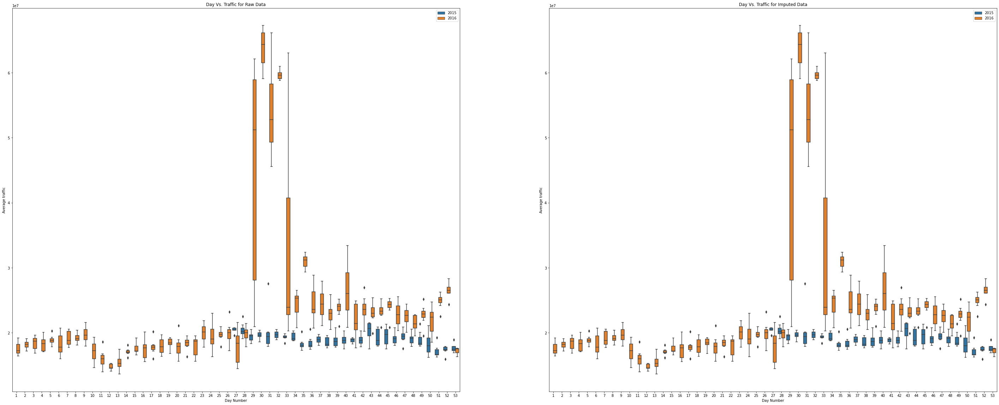

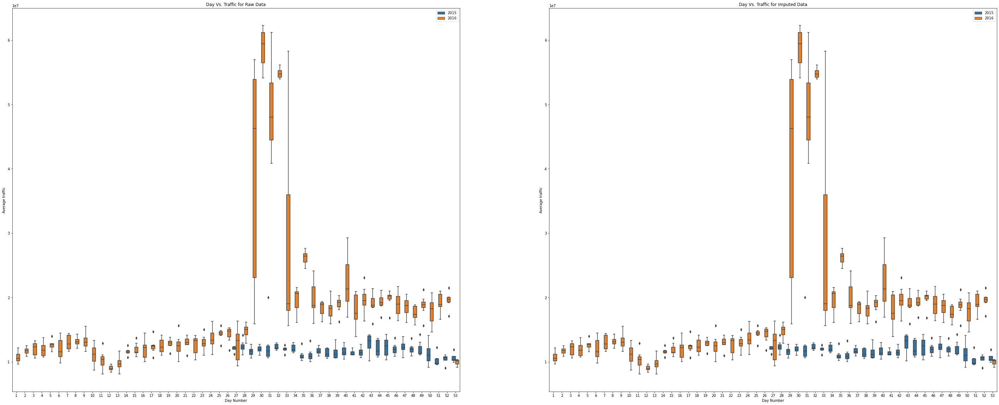

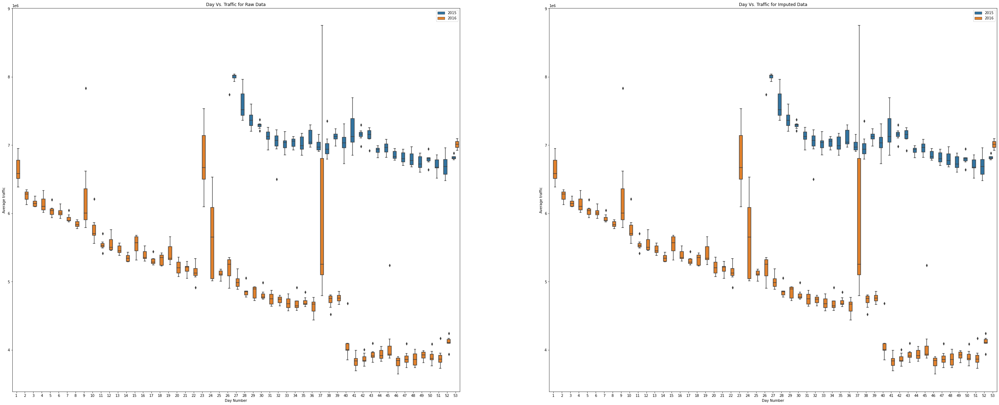

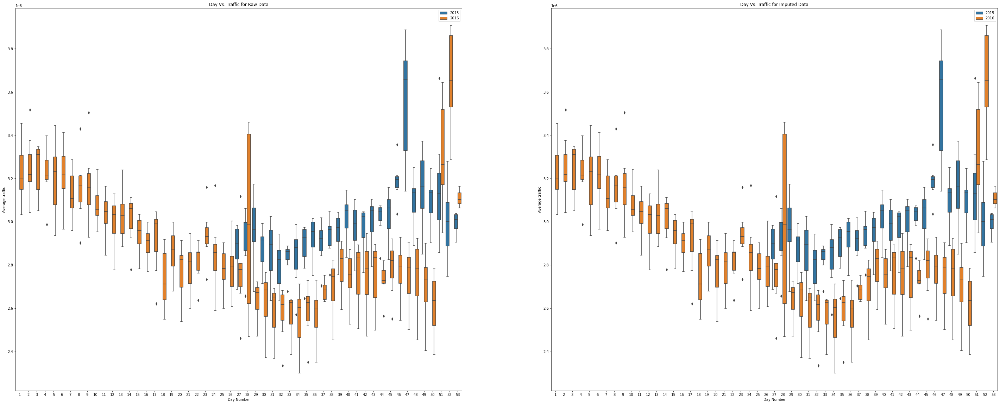

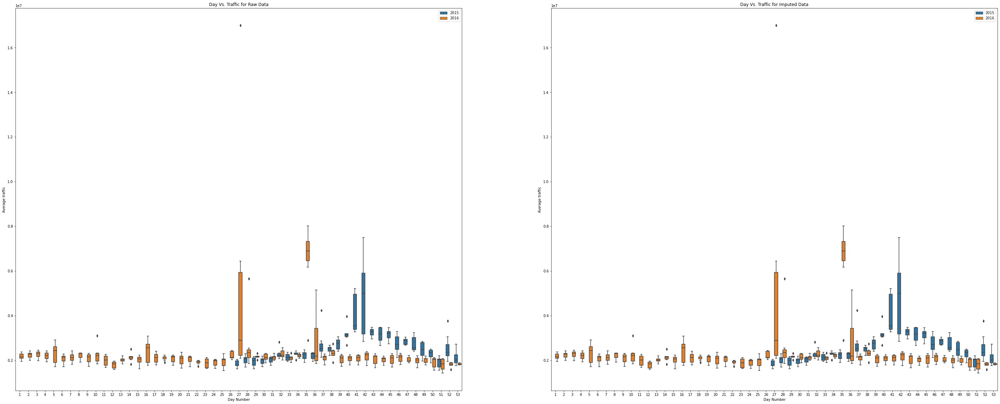

...

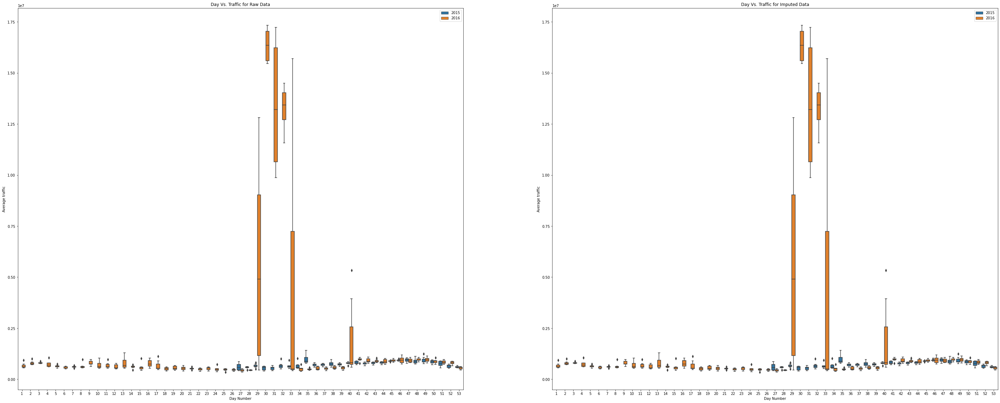

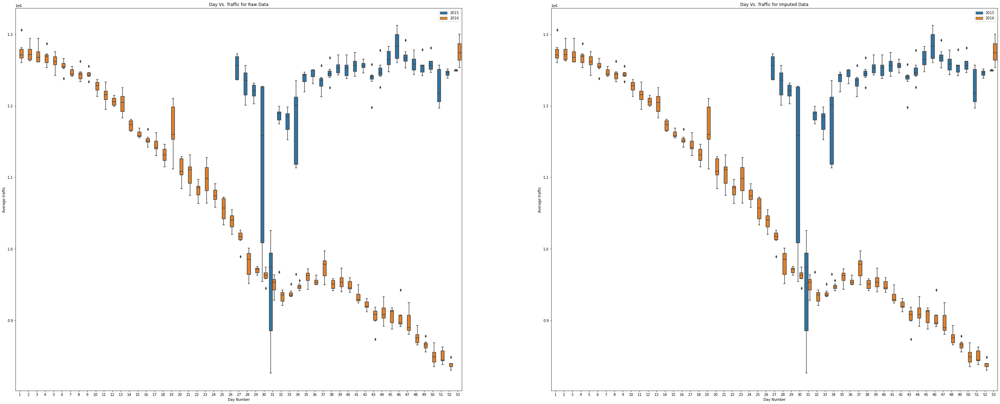

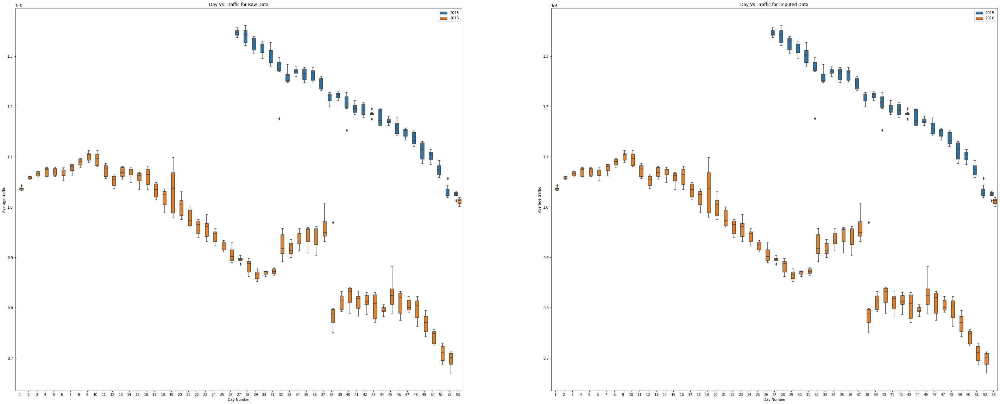

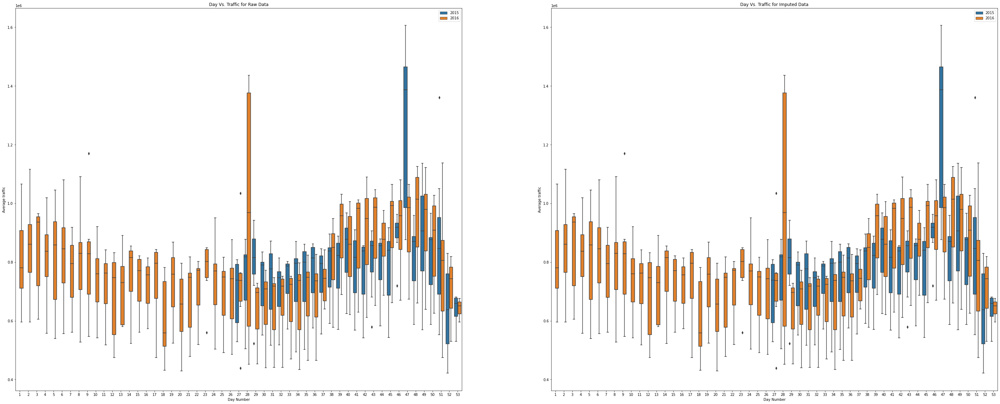

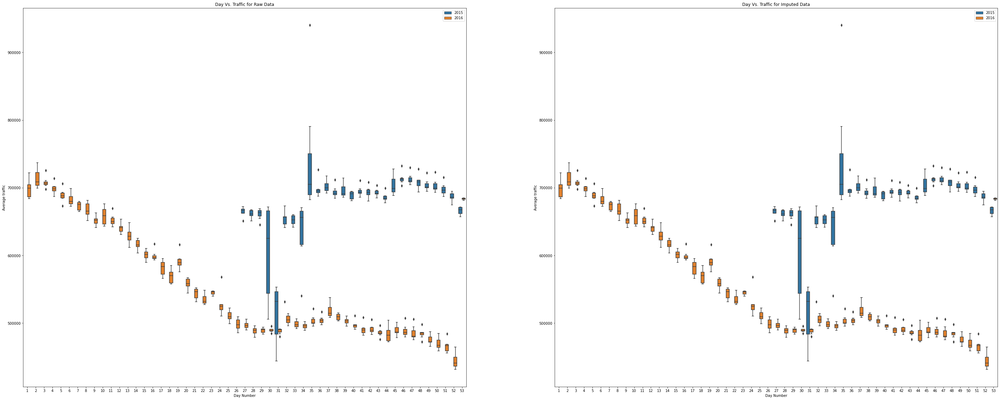

In [44]:
# Boxplots of week vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=week,y=rawhits,hue=year,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=week,y=imphits,hue=year,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


- It is observed in most cases the weeks in 2015 has higher pagehit values.
- Also there is a downward trend in pagehit values for weeks in 2016
- So weeks and year are important features

#### Plotting the pagehits data of top 15 pages based on the language 

Language  fr


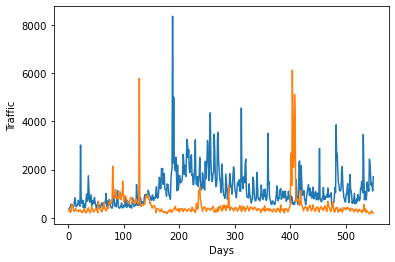

Language  en


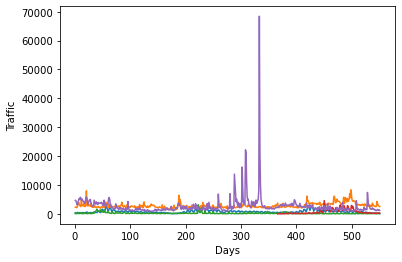

Language  ru


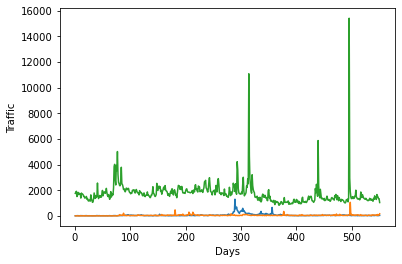

Language  de


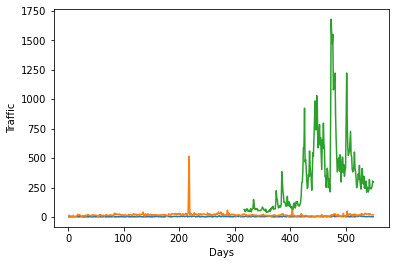

Language  es


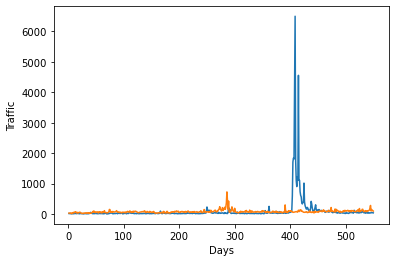

In [45]:

top_15_raw=eda_train_raw.iloc[:15,:]
top_15_imp=eda_train_imp.iloc[:15,:]
# Plotting the pagehits raw data for top 15 pages based on their languages

for key in lang_df:
    index=top_15_raw.loc[top_15_raw['Lang']==key].index
    if len(index)!=0:
        print("Language ",key)
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_raw.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')
        plt.show()
    

Language  fr


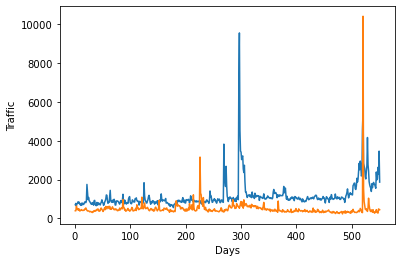

Language  en


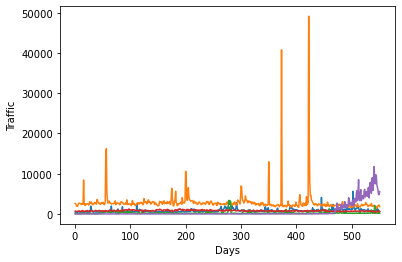

Language  ru


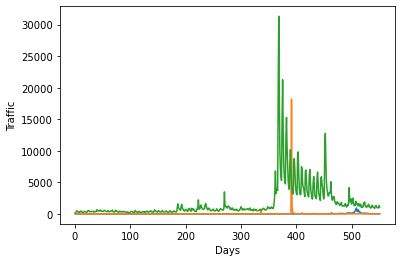

Language  de


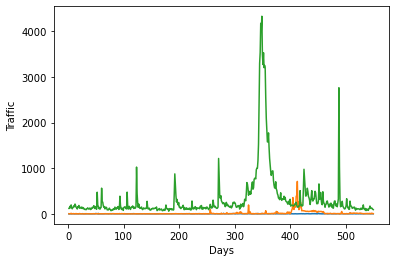

Language  es


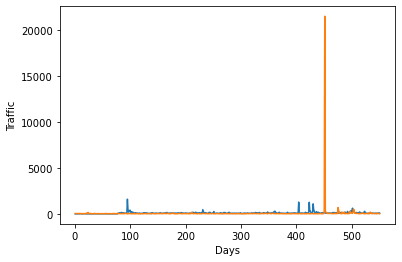

In [46]:
# Plotting the pagehits imputed data for top 15 pages based on their languages

for key in lang_df:
    index=top_15_raw.loc[top_15_imp['Lang']==key].index
    if len(index)!=0:
        print("Language ",key)
    
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_imp.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

For both raw and imputed data the plots are not similar for each language. I couldn't find any pattern for each language . So I won't be including language as a feature.

Language  fr


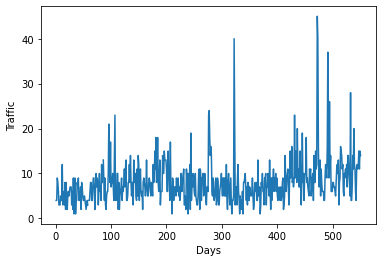

Language  en


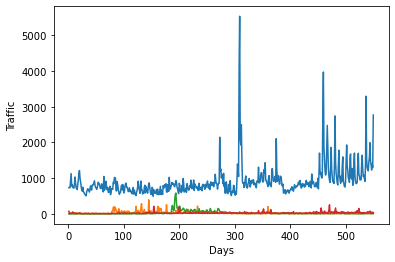

Language  na


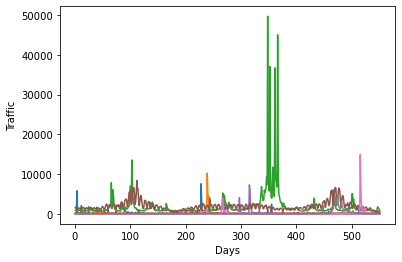

Language  ru


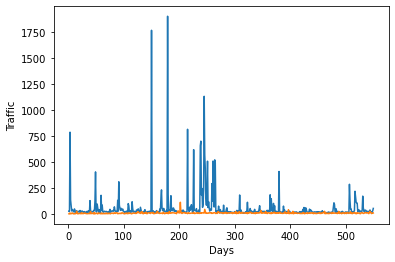

In [47]:
for key in lang_df:
    index=last_15_raw.loc[last_15_raw['Lang']==key].index
    if len(index)!=0:
        print("Language ",key)
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_raw.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')
        plt.show()


Language  fr


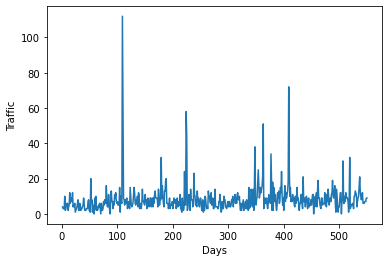

Language  en


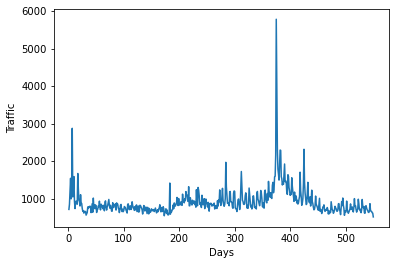

Language  na


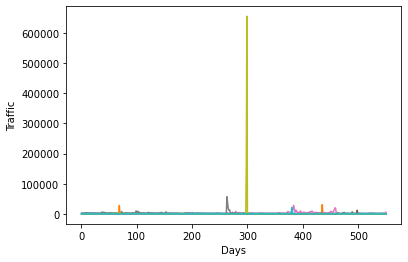

Language  ru


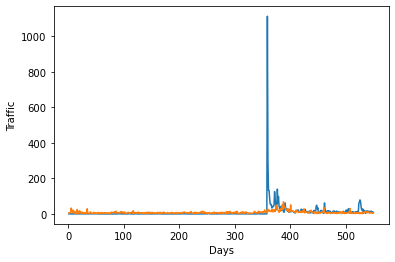

Language  es


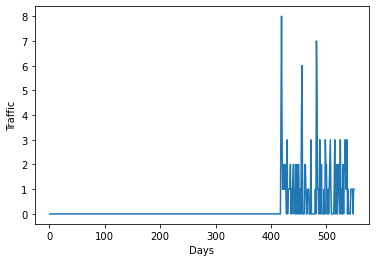

In [48]:
for key in lang_df:
    index=last_15_imp.loc[last_15_imp['Lang']==key].index
    if len(index)!=0:
        print("Language ",key)
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_imp.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')
        plt.show()


#### Plotting the pagehits data of top 15 pages for  each access type

Access  0


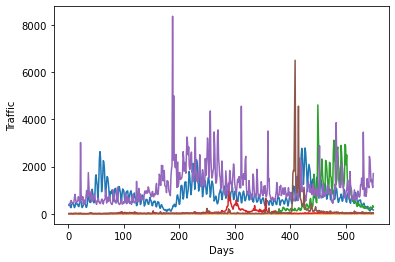

Access  1


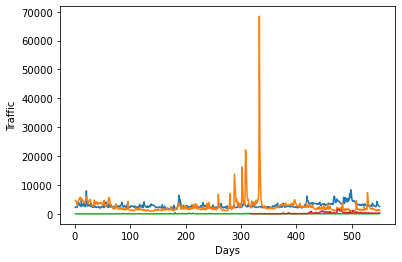

Access  2


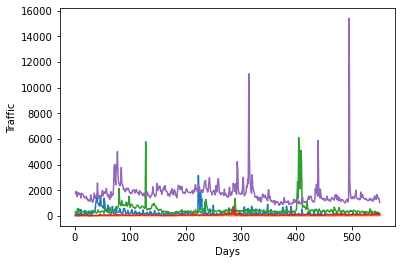

In [49]:
for key in top_15_raw['Access'].unique():
    index=top_15_raw.loc[top_15_raw['Access']==key].index
    if len(index)!=0:
        print("Access ",key)
        
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_raw.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

Access  0


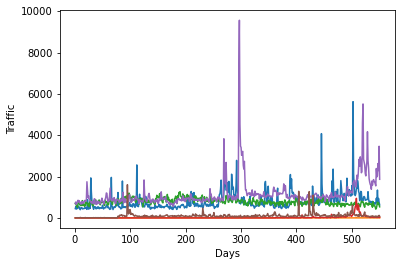

Access  1


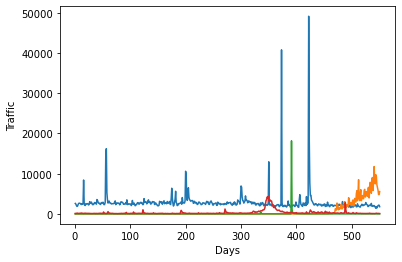

Access  2


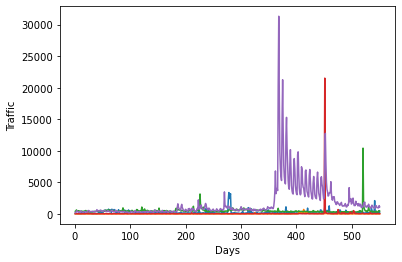

In [50]:
for key in top_15_imp['Access'].unique():
    index=top_15_imp.loc[top_15_imp['Access']==key].index
    if len(index)!=0:
        print("Access ",key)
        
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_imp.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

For Access type also , I could'nt find any pattern in both raw and imputed top 15 pages. So I am not including this as a feature.

Access  2


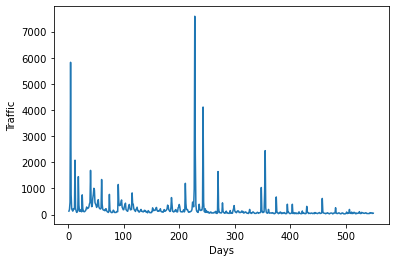

Access  0


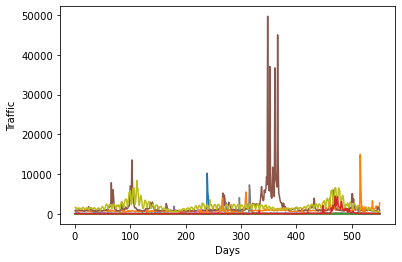

In [51]:
for key in last_15_raw['Access'].unique():
    index=last_15_raw.loc[last_15_raw['Access']==key].index
    if len(index)!=0:
        print("Access ",key)
        
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_raw.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

Access  0


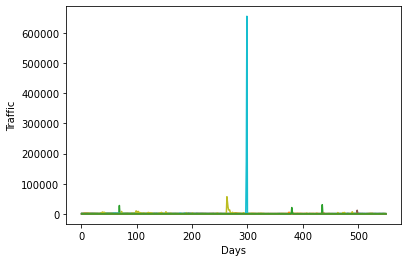

Access  2


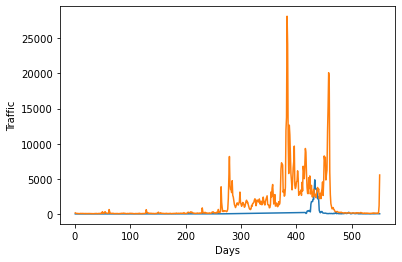

In [52]:
for key in last_15_imp['Access'].unique():
    index=last_15_imp.loc[last_15_imp['Access']==key].index
    if len(index)!=0:
        print("Access ",key)
        
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_imp.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

#### Plotting the pagehits data of top 15 pages for  each agent type

Agent  0


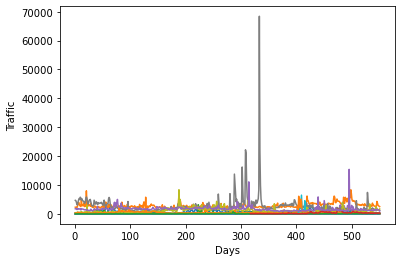

In [53]:
# Raw Data
for key in top_15_raw['Agent'].unique():
    index=top_15_raw.loc[top_15_raw['Agent']==key].index
    if len(index)!=0:
        print("Agent ",key)
        
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_raw.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

Agent  0


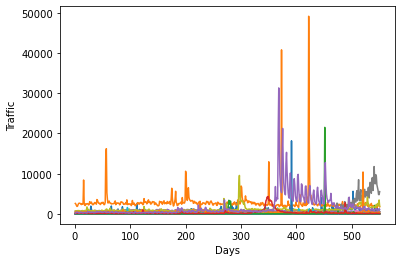

In [54]:
# Imputed Data
for key in top_15_imp['Agent'].unique():
    index=top_15_imp.loc[top_15_imp['Agent']==key].index
    if len(index)!=0:
        print("Agent ",key)
        
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_imp.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

Agent  0


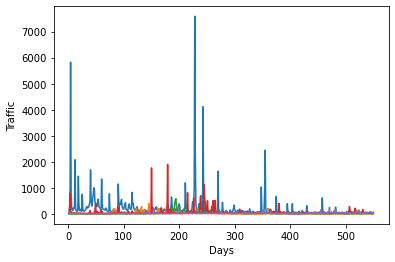

Agent  1


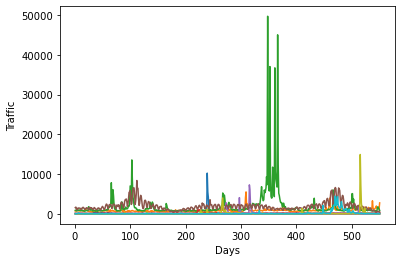

In [55]:
# Raw Data
for key in last_15_raw['Agent'].unique():
    index=last_15_raw.loc[last_15_raw['Agent']==key].index
    if len(index)!=0:
        print("Agent ",key)
        
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_raw.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

All the top pages have the same type of agent , So it is difficult to understand if there is a difference for each agent type

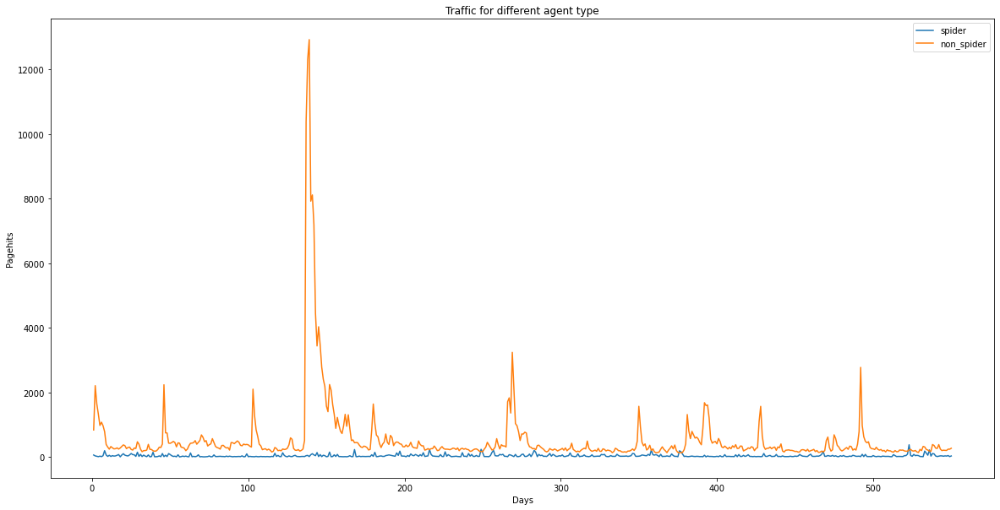

In [56]:
### Plotting the traffic for 2 random pages of each agent type
n=random.randint(0,100)
plt.figure(figsize=(20,10))
for i in agent_df.keys():
    plt.plot(range(1,len(date_list)+1),agent_df[i].iloc[n,1:],label=i)
plt.xlabel("Days")
plt.ylabel("Pagehits")
plt.title("Traffic for different agent type")

plt.legend()
plt.show()

The pagehit values for spider is  less than the pagehit values for non-spider , so this will be used as a feature.

### Autocorrelation Plots for top 15 pages

Language for Raw Data  en        Language for Imputed Data  en


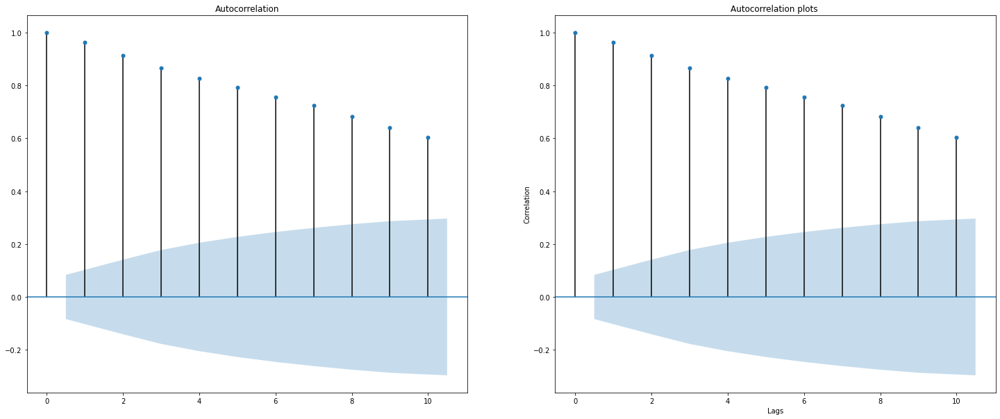

Language for Raw Data  en        Language for Imputed Data  en


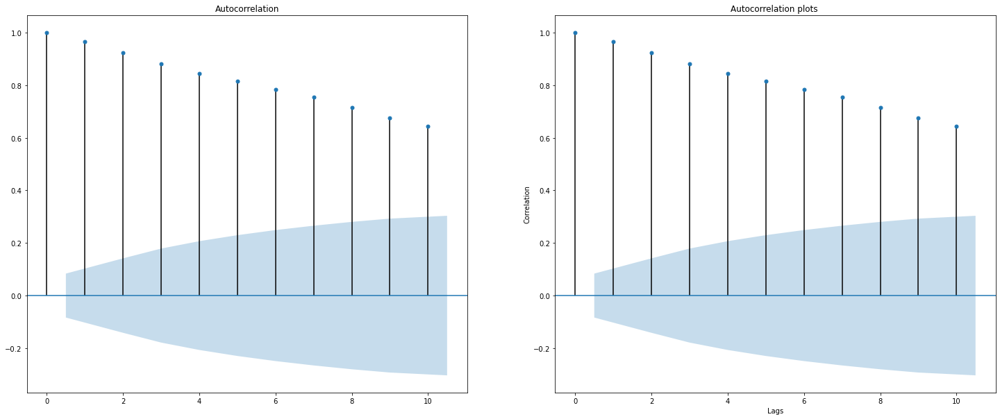

Language for Raw Data  en        Language for Imputed Data  en


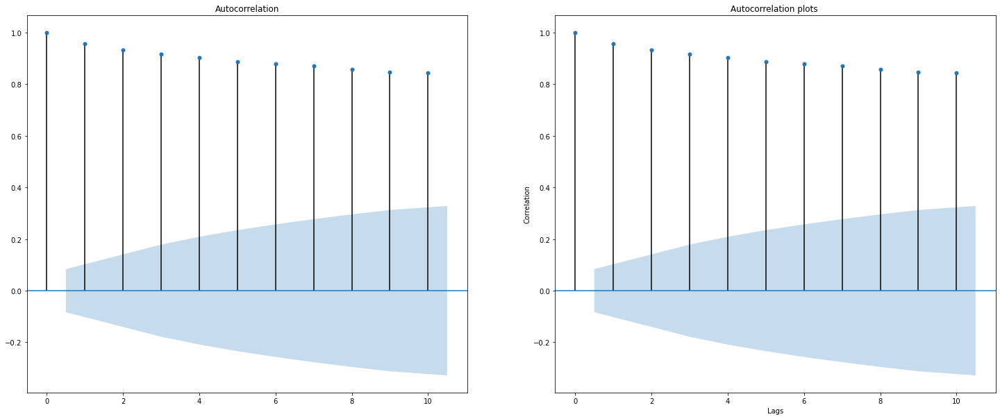

Language for Raw Data  de        Language for Imputed Data  de


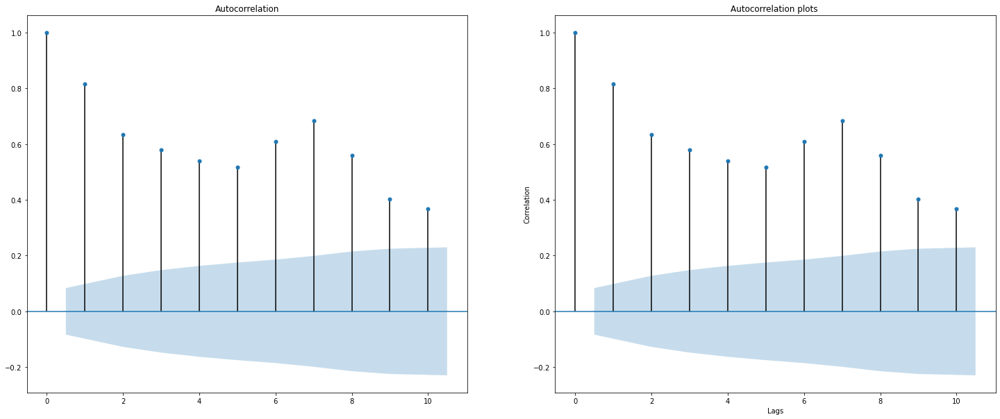

Language for Raw Data  en        Language for Imputed Data  en


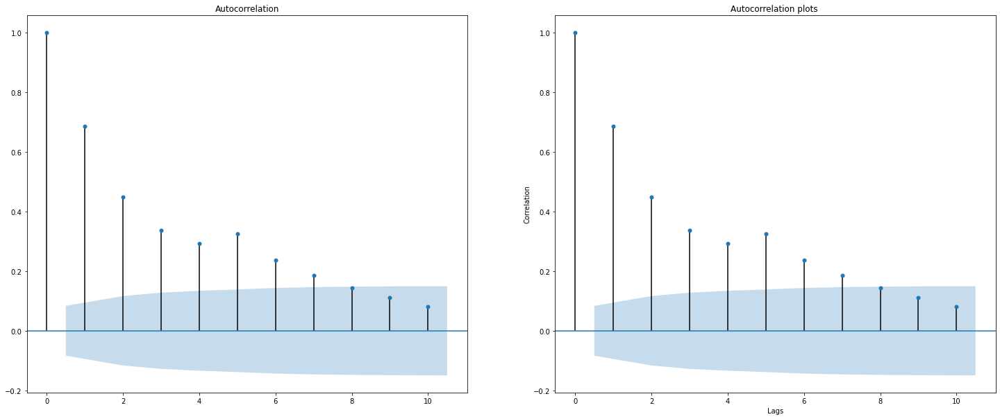

Language for Raw Data  de        Language for Imputed Data  de


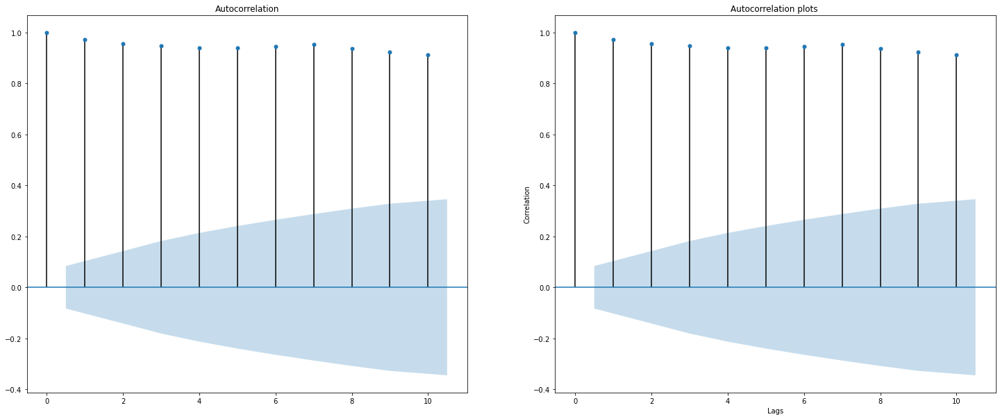

Language for Raw Data  ru        Language for Imputed Data  ru


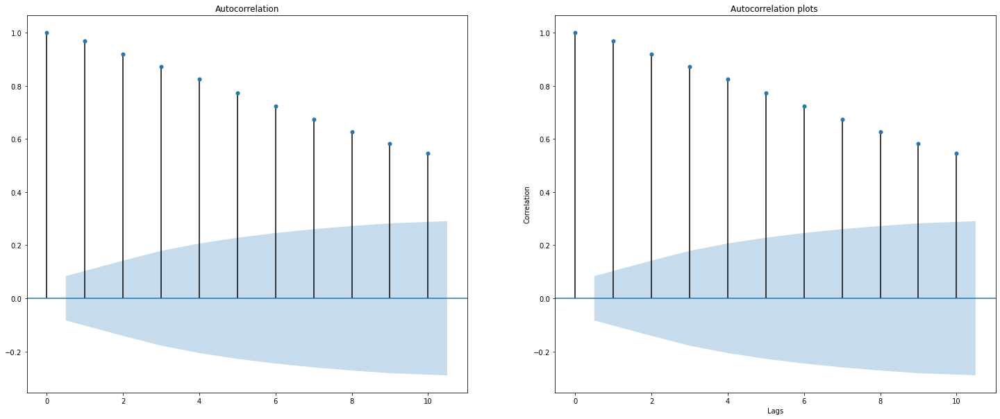

Language for Raw Data  en        Language for Imputed Data  en


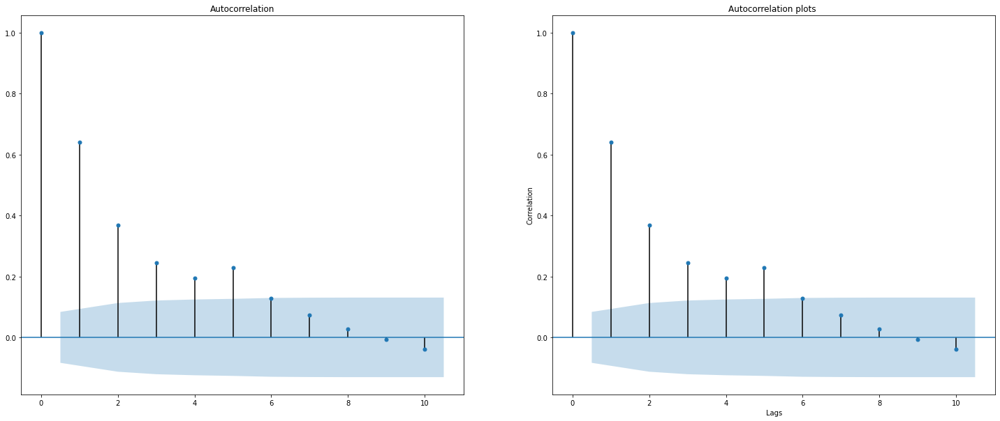

Language for Raw Data  fr        Language for Imputed Data  fr


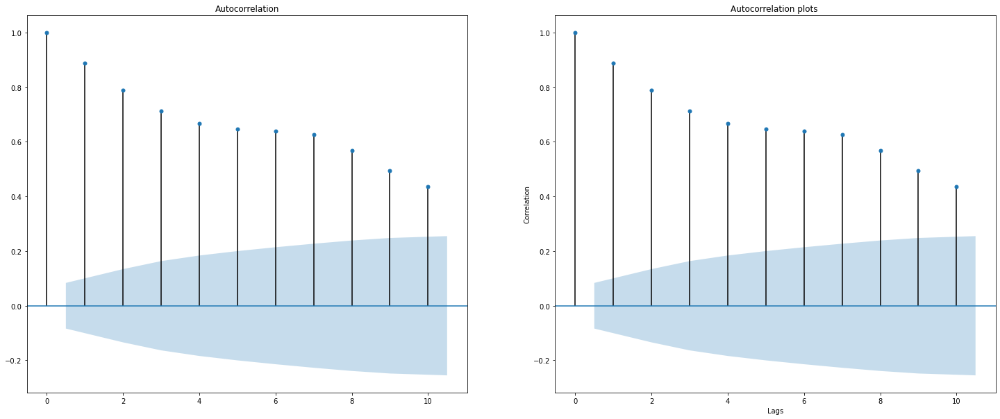

Language for Raw Data  es        Language for Imputed Data  es


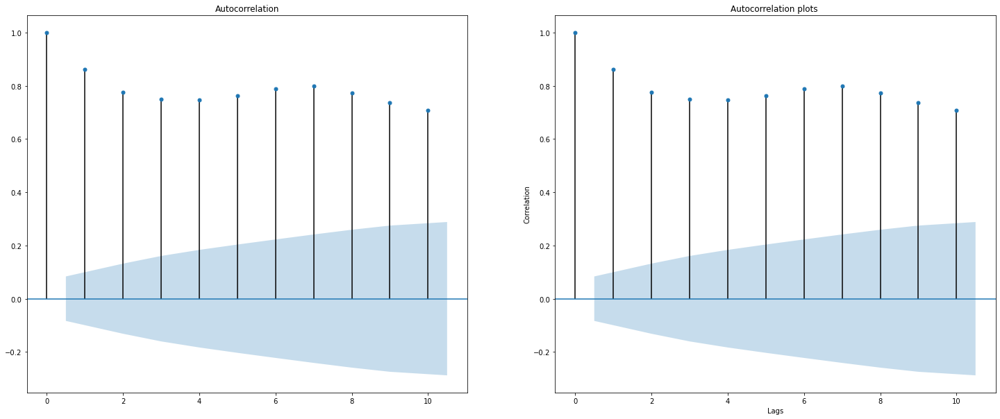

Language for Raw Data  ru        Language for Imputed Data  ru


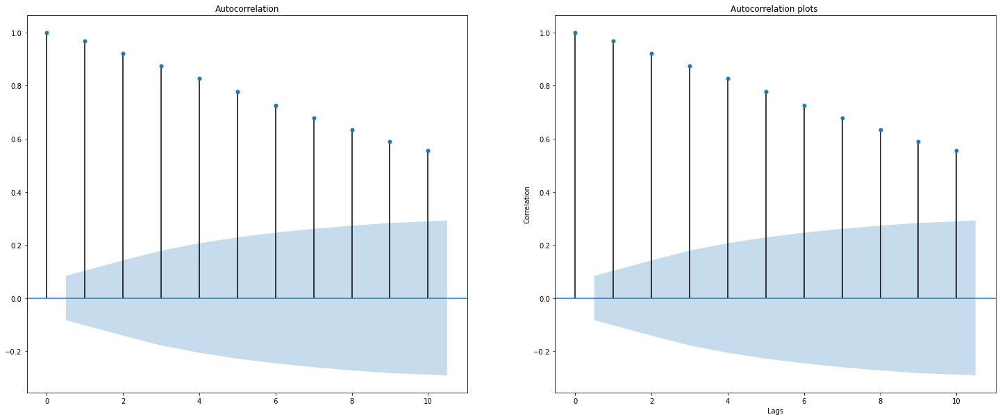

Language for Raw Data  fr        Language for Imputed Data  fr


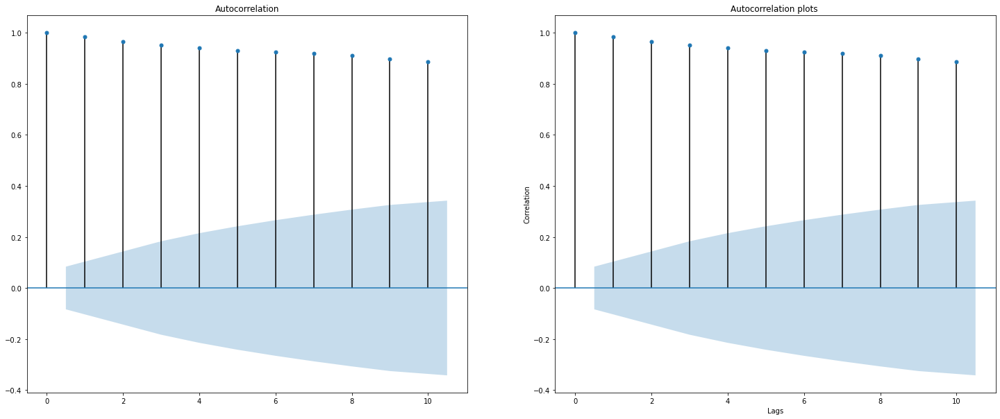

Language for Raw Data  es        Language for Imputed Data  es


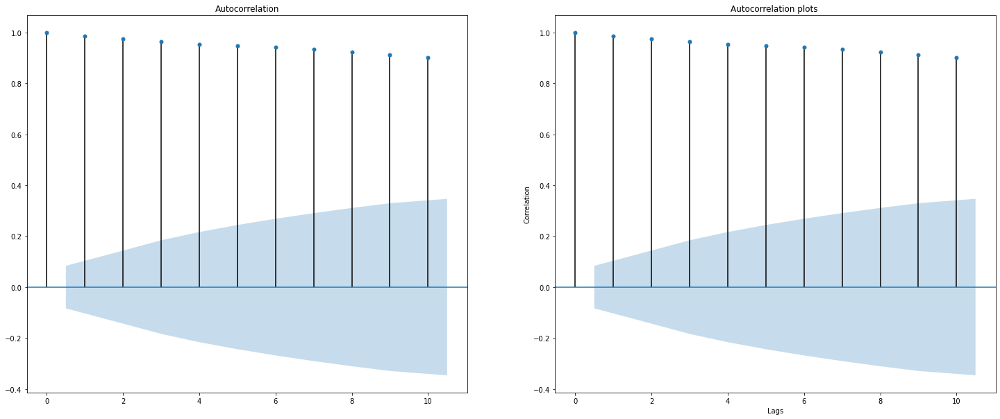

Language for Raw Data  de        Language for Imputed Data  de


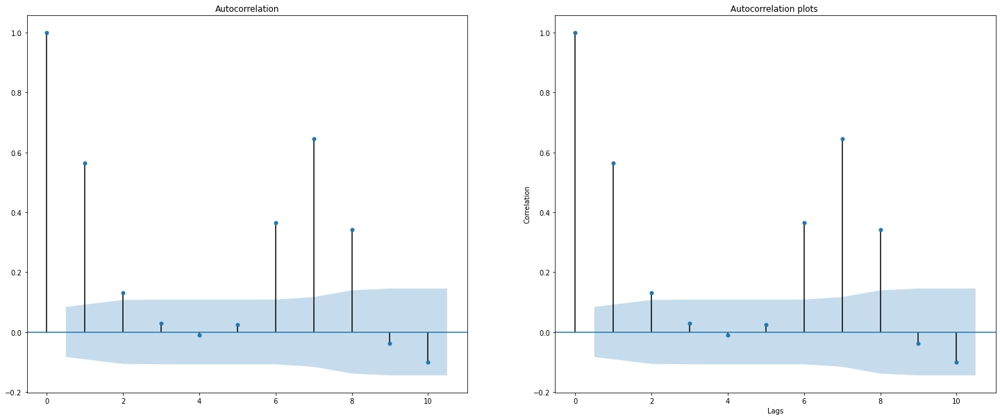

Language for Raw Data  ru        Language for Imputed Data  ru


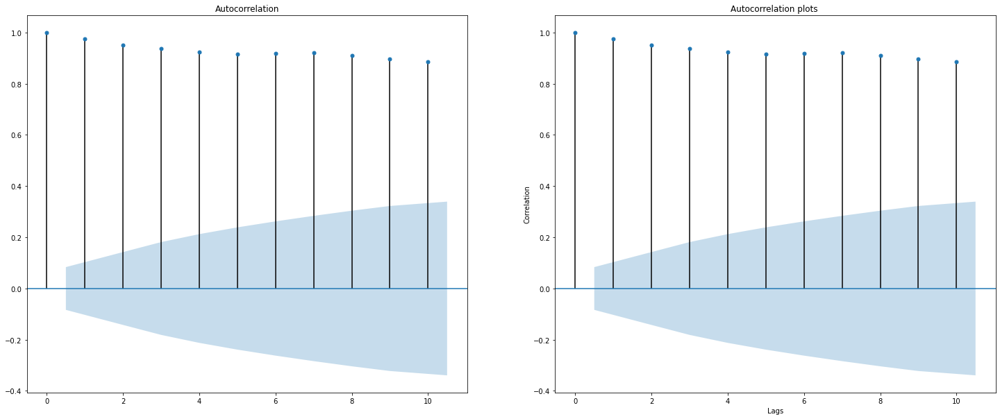

In [57]:
import statsmodels.api as sm
for i in range(15):
    fig,axes=plt.subplots(1,2,figsize=(25,10))
    sm.graphics.tsa.plot_acf(x=top_15_raw.iloc[i,1:train.shape[1]],lags=10,ax=axes[0])
    sm.graphics.tsa.plot_acf(x=top_15_imp.iloc[i,1:train.shape[1]],lags=10,ax=axes[1])

    print("Language for Raw Data " ,top_15_raw.iloc[i]['Lang'],"       Language for Imputed Data ",top_15_imp.iloc[i]['Lang'])
    plt.xlabel('Lags')
    plt.ylabel('Correlation')
    plt.title('Autocorrelation plots ')
    plt.show()

Language for Raw Data  en        Language for Imputed Data  en


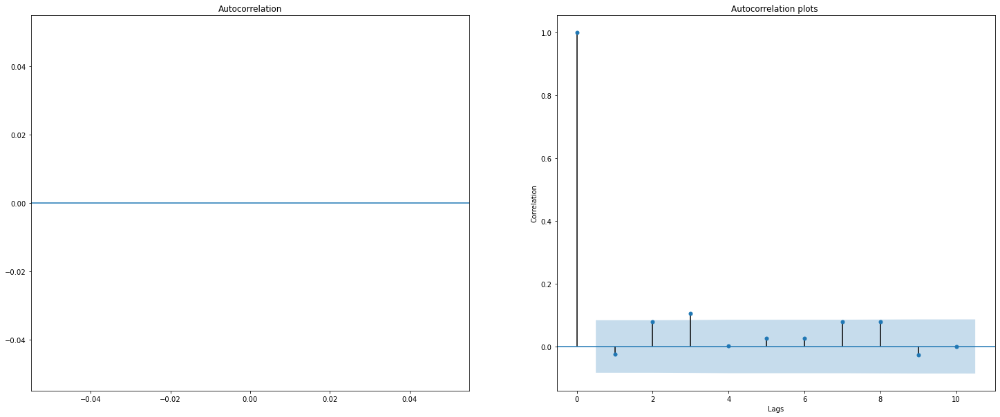

Language for Raw Data  en        Language for Imputed Data  en


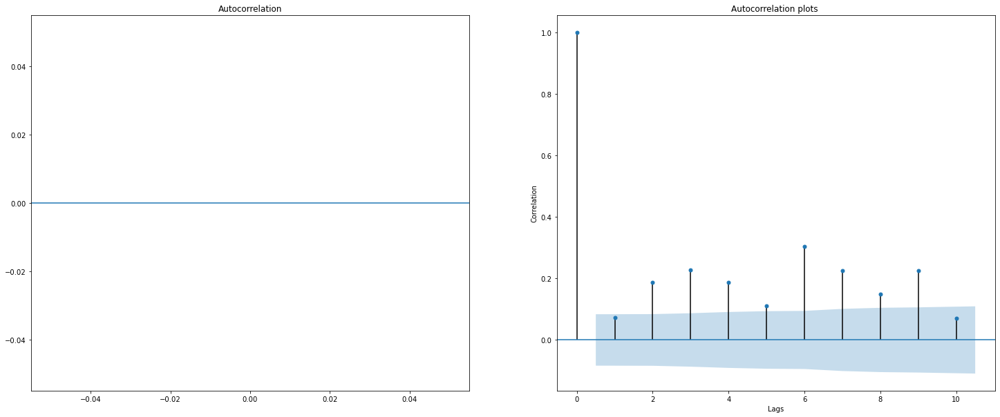

Language for Raw Data  en        Language for Imputed Data  en


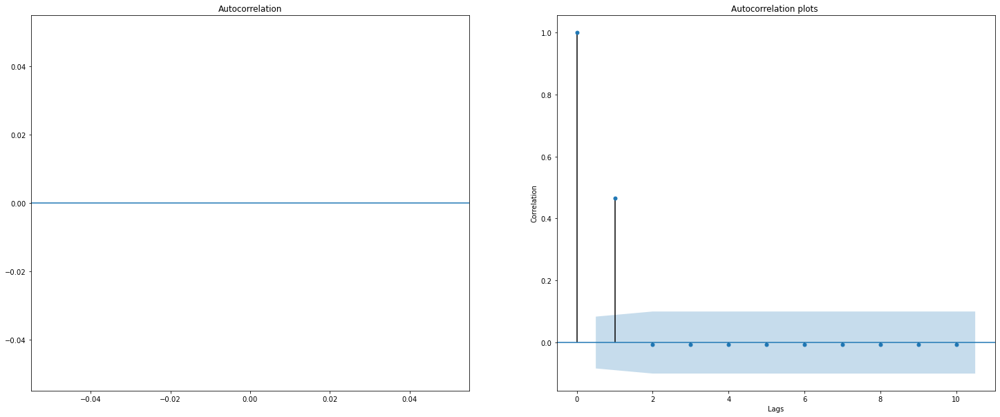

Language for Raw Data  de        Language for Imputed Data  de


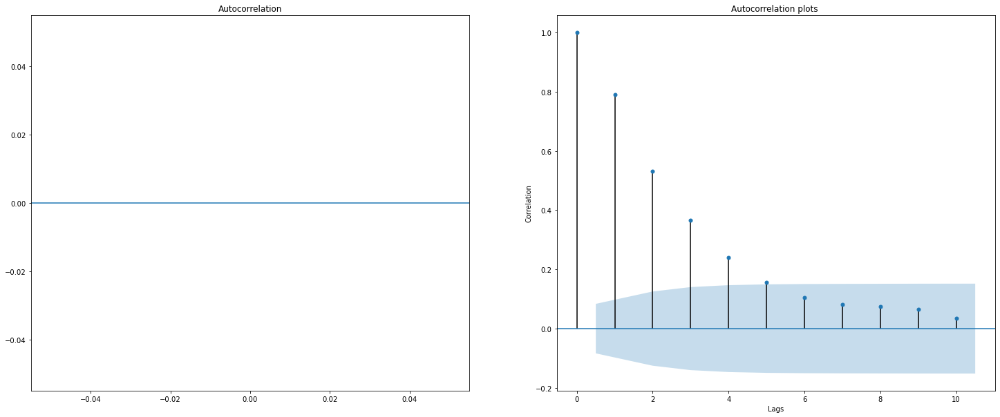

Language for Raw Data  en        Language for Imputed Data  en


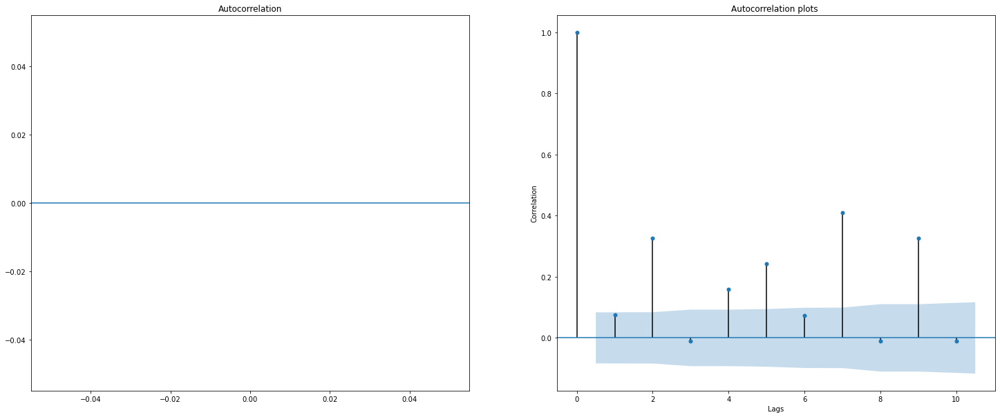

Language for Raw Data  de        Language for Imputed Data  de


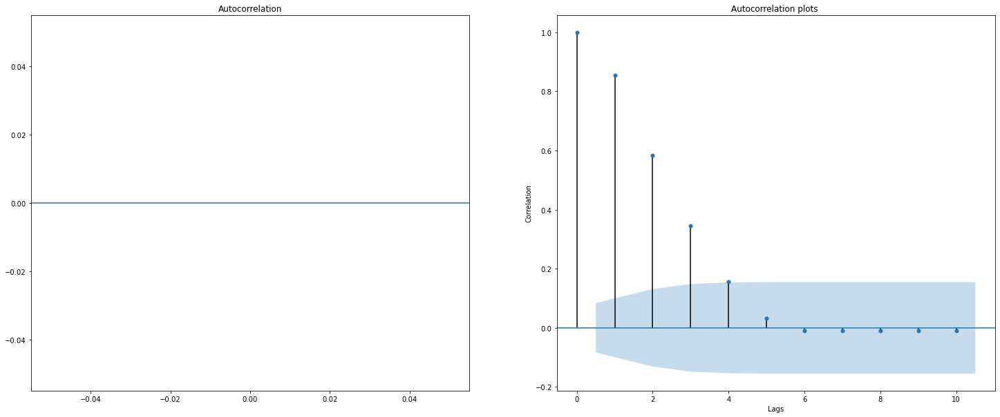

Language for Raw Data  ru        Language for Imputed Data  ru


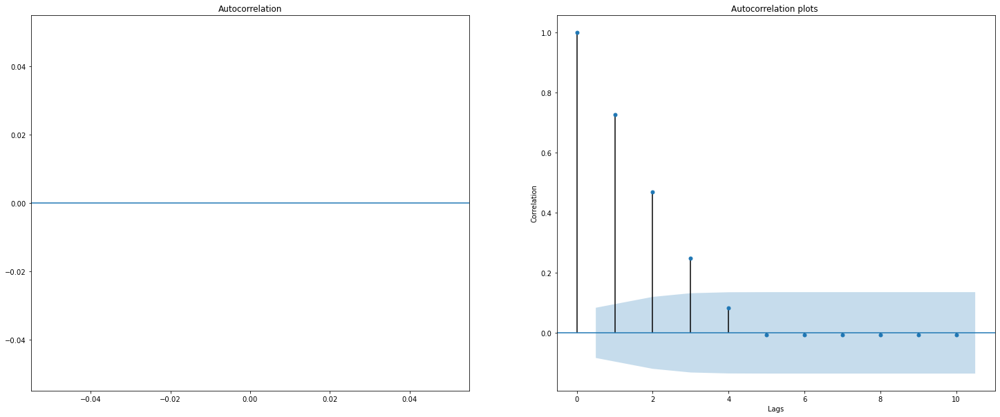

Language for Raw Data  en        Language for Imputed Data  en


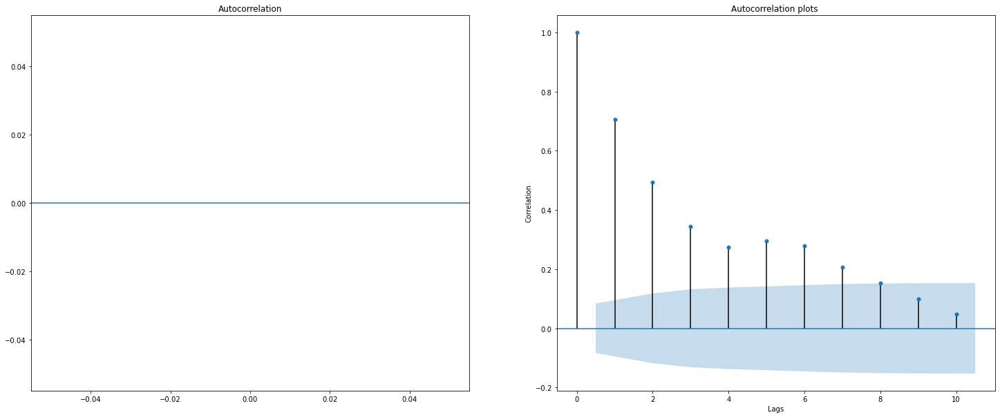

Language for Raw Data  fr        Language for Imputed Data  fr


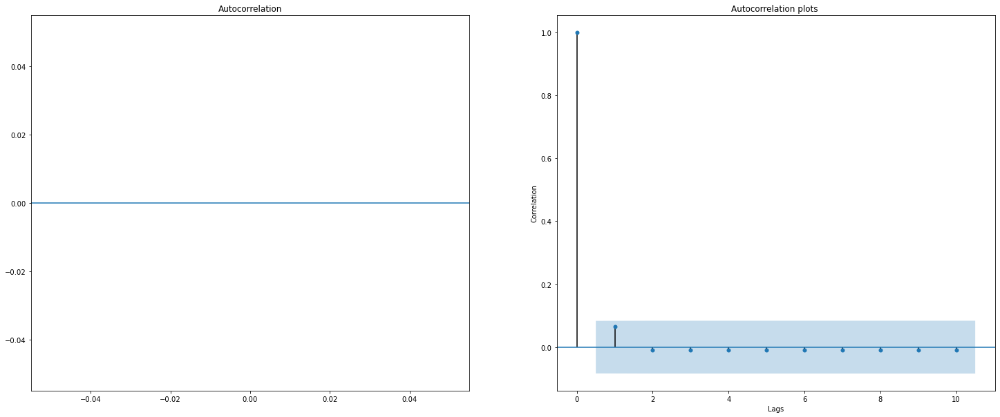

Language for Raw Data  es        Language for Imputed Data  es


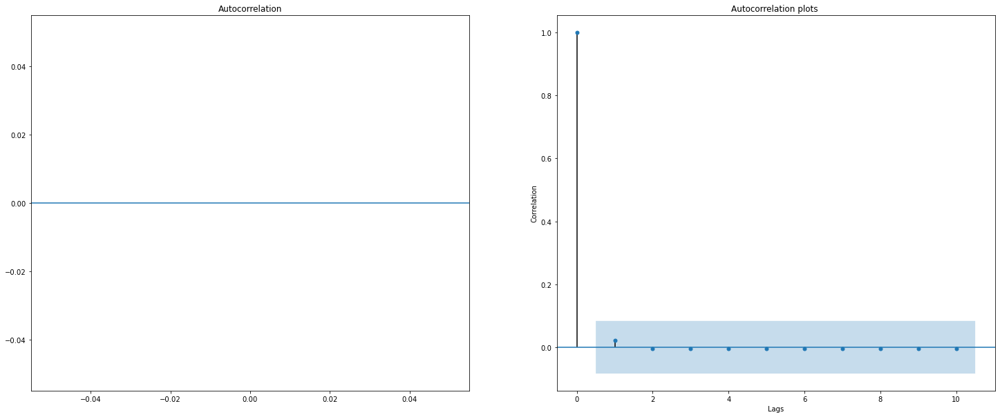

Language for Raw Data  ru        Language for Imputed Data  ru


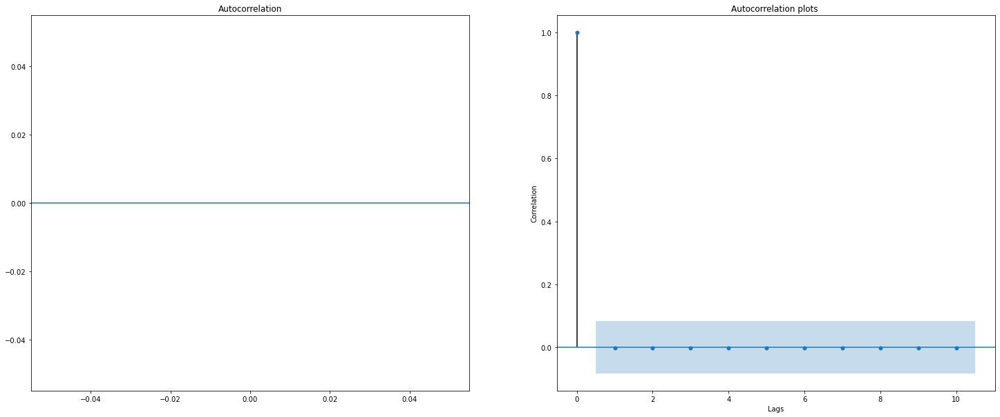

Language for Raw Data  fr        Language for Imputed Data  fr


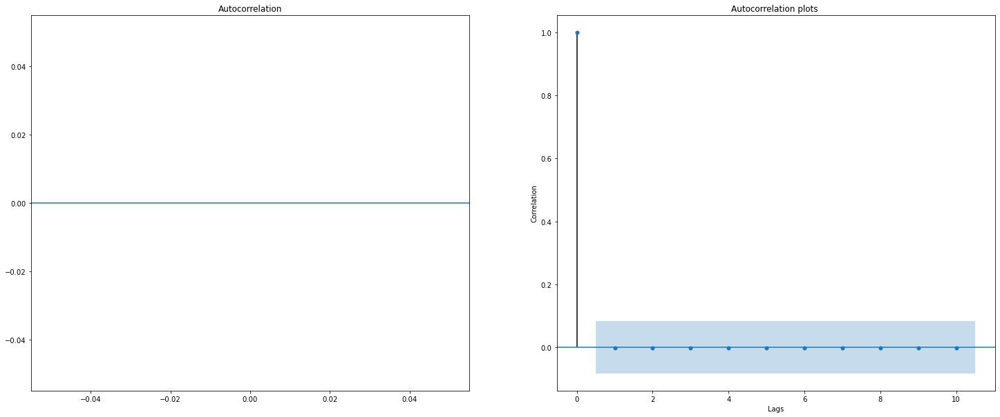

Language for Raw Data  es        Language for Imputed Data  es


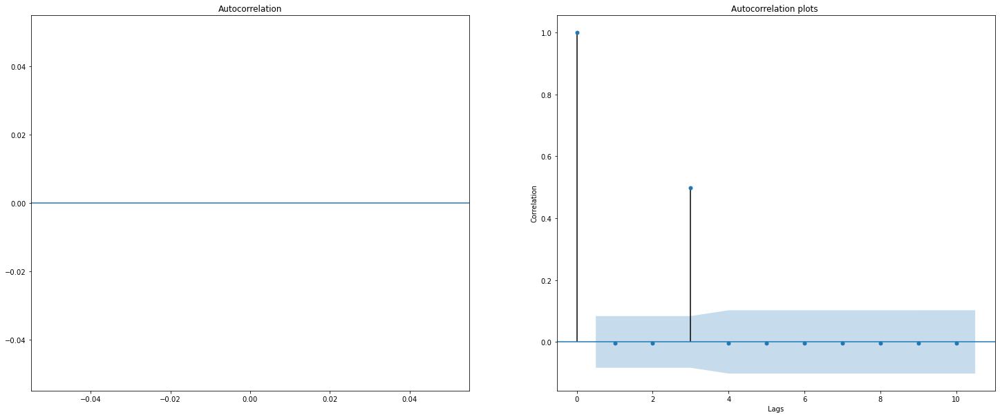

Language for Raw Data  de        Language for Imputed Data  de


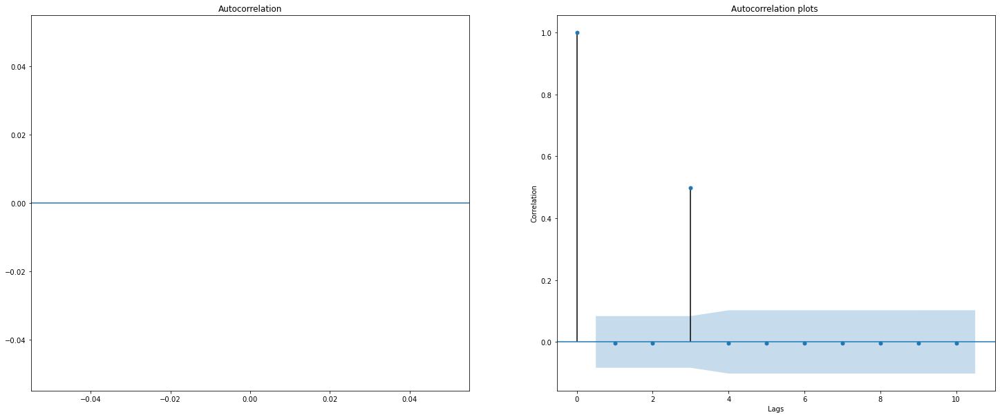

Language for Raw Data  ru        Language for Imputed Data  ru


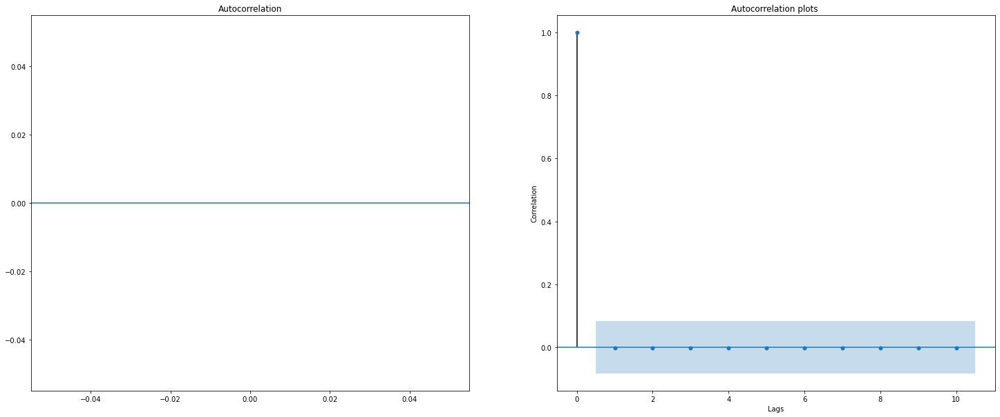

In [58]:
import statsmodels.api as sm
for i in range(15):
    fig,axes=plt.subplots(1,2,figsize=(25,10))
    sm.graphics.tsa.plot_acf(x=last_15_raw.iloc[i,1:train.shape[1]],lags=10,ax=axes[0])
    sm.graphics.tsa.plot_acf(x=last_15_imp.iloc[i,1:train.shape[1]],lags=10,ax=axes[1])

    print("Language for Raw Data " ,top_15_raw.iloc[i]['Lang'],"       Language for Imputed Data ",top_15_imp.iloc[i]['Lang'])
    plt.xlabel('Lags')
    plt.ylabel('Correlation')
    plt.title('Autocorrelation plots ')
    plt.show()

I observe that the lag value depends a bit on the Language of the page so , I will be taking the lag value based on the language of te page in feature development

## Feature Development

In [59]:
'''
weekday has been calculated from the datelist 
is_sunday_or_monday feature is created from weekday feature . if weekday is 0 or 6 then its value will be 1 else 0  
'''
is_sunday_or_monday=[]
for i in weekday:
    if i == 0 or i == 6:
        is_sunday_or_monday.append(1)
    else:
        is_sunday_or_monday.append(0)
is_sunday_or_monday=pd.Series(is_sunday_or_monday)

#### Month , is_august and year_half  feature

In [60]:
'''
month is created from datelist and is_august is created from the month number
year_half feature is created from month number , first 6 months is 1 and second 6 months is 2.
'''
is_august=[]
for i in month:
    if i == 8:
        is_august.append(1)
    else:
        is_august.append(0)
is_august=pd.Series(is_august)

year_half=[]
for i in month:
    if i in [1,2,3,4,5,6] :
        year_half.append(1)
    else :
        year_half.append(2)
year_half=pd.Series(year_half)

In [61]:
### The above features are irrespective of the page , I will call them global features
global_feat=pd.DataFrame()
global_feat=pd.concat([weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week],axis=1)
global_feat.columns=['weekday','is_sunday_or_monday','month','is_august','year_half','quarter','quarter_start','quarter_end','month_start','month_end','days_in_month','week']
global_feat

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week
0,2,0,7,0,2,3,True,False,True,False,31,27
1,3,0,7,0,2,3,False,False,False,False,31,27
2,4,0,7,0,2,3,False,False,False,False,31,27
3,5,0,7,0,2,3,False,False,False,False,31,27
4,6,1,7,0,2,3,False,False,False,False,31,27
...,...,...,...,...,...,...,...,...,...,...,...,...
545,1,0,12,0,2,4,False,False,False,False,31,52
546,2,0,12,0,2,4,False,False,False,False,31,52
547,3,0,12,0,2,4,False,False,False,False,31,52
548,4,0,12,0,2,4,False,False,False,False,31,52


### Page Specific Features 

For page specific features , I am creating different feature sets for different languages . So I am grouping the total data by languages and selecting pages of each language with maximum view percentage.

In [62]:
train_pages=eda_train_imp[['Page','Lang','viewperc']].groupby('Lang').max().reset_index()
train_pages

,Lang,Page,viewperc
0,de,…_denn_zum_Küssen_sind_sie_da_de.wikipedia.org...,2.916244e+06
1,en,Élodie_Yung_en.wikipedia.org_mobile-web_all-ag...,2.193851e+07
2,es,Óxido_es.wikipedia.org_desktop_all-agents,1.366350e+06
3,fr,Œuf_de_Pâques_fr.wikipedia.org_mobile-web_all-...,1.579056e+06
4,ja,［Alexandros］_ja.wikipedia.org_mobile-web_all-a...,3.831887e+05
5,na,대문_commons.wikimedia.org_desktop_all-agents,2.598811e+05
6,ru,Ящур_ru.wikipedia.org_mobile-web_all-agents,1.974581e+06
7,zh,龙生九子_zh.wikipedia.org_mobile-web_all-agents,2.248987e+05


### For each language I am creating a feature set 
### Language 1

#### Agent Feature as Spider and Non_spider

In [63]:
page1=train_pages.iloc[0].loc['Page']
lang1=train_pages.iloc[0].loc['Lang']
agent_index=re.search('spider',page1)
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)

In [64]:
# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']
page_specific_feat

,spider,non_spider
0,0,1
1,0,1
2,0,1
3,0,1
4,0,1
...,...,...
545,0,1
546,0,1
547,0,1
548,0,1


### Total Features for language 1
 

In [65]:
# combining the global and page specific features to get the final feature set
total_feat1=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat1.tail()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider
545,1,0,12,0,2,4,False,False,False,False,31,52,0,1
546,2,0,12,0,2,4,False,False,False,False,31,52,0,1
547,3,0,12,0,2,4,False,False,False,False,31,52,0,1
548,4,0,12,0,2,4,False,False,False,False,31,52,0,1
549,5,0,12,0,2,4,False,True,False,True,31,52,0,1


### Target Values for language 1

In [66]:
### target value as a numpy array
target1 = pd.DataFrame(inp_train.loc[inp_train['Page']== page1].iloc[0,1:].values)
target1.columns = ['Target']
target1['Target']=pd.to_numeric(target1['Target'])
target1

,Target
0,16.0
1,16.0
2,20.0
3,19.0
4,27.0
...,...
545,24.0
546,28.0
547,20.0
548,35.0


### Language 2

In [67]:
page2=train_pages.iloc[1].loc['Page']
lang2=train_pages.iloc[1].loc['Lang']
agent_index=re.search('spider',page2)
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)

# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']

# combining the global and page specific features to get the final feature set
total_feat2=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat2.tail()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider
545,1,0,12,0,2,4,False,False,False,False,31,52,0,1
546,2,0,12,0,2,4,False,False,False,False,31,52,0,1
547,3,0,12,0,2,4,False,False,False,False,31,52,0,1
548,4,0,12,0,2,4,False,False,False,False,31,52,0,1
549,5,0,12,0,2,4,False,True,False,True,31,52,0,1


In [68]:
### target value as a numpy array
target2 = pd.DataFrame(inp_train.loc[inp_train['Page']== page2].iloc[0,1:].values)
target2.columns = ['Target']
target2['Target']=pd.to_numeric(target2['Target'])
target2

,Target
0,67.0
1,65.0
2,97.0
3,275.0
4,190.0
...,...
545,1798.0
546,1557.0
547,1479.0
548,1503.0


### Language 3

In [69]:
page3=train_pages.iloc[2].loc['Page']
lang3=train_pages.iloc[2].loc['Lang']
agent_index=re.search('spider',page3)
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)

# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']

# combining the global and page specific features to get the final feature set
total_feat3=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat3.tail()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider
545,1,0,12,0,2,4,False,False,False,False,31,52,0,1
546,2,0,12,0,2,4,False,False,False,False,31,52,0,1
547,3,0,12,0,2,4,False,False,False,False,31,52,0,1
548,4,0,12,0,2,4,False,False,False,False,31,52,0,1
549,5,0,12,0,2,4,False,True,False,True,31,52,0,1


In [70]:
### target value as a numpy array
target3 = pd.DataFrame(inp_train.loc[inp_train['Page']== page3].iloc[0,1:].values)
target3.columns = ['Target']
target3['Target']=pd.to_numeric(target3['Target'])
target3

,Target
0,395.0
1,476.0
2,371.0
3,258.0
4,283.0
...,...
545,67.0
546,61.0
547,49.0
548,87.0


### Language 4

In [71]:
page4=train_pages.iloc[3].loc['Page']
lang4=train_pages.iloc[3].loc['Lang']
agent_index=re.search('spider',page4)
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)

# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']

# combining the global and page specific features to get the final feature set
total_feat4=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat4.tail()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider
545,1,0,12,0,2,4,False,False,False,False,31,52,0,1
546,2,0,12,0,2,4,False,False,False,False,31,52,0,1
547,3,0,12,0,2,4,False,False,False,False,31,52,0,1
548,4,0,12,0,2,4,False,False,False,False,31,52,0,1
549,5,0,12,0,2,4,False,True,False,True,31,52,0,1


In [72]:
### target value as a numpy array
target4 = pd.DataFrame(inp_train.loc[inp_train['Page']== page4].iloc[0,1:].values)
target4.columns = ['Target']
target4['Target']=pd.to_numeric(target4['Target'])
target4

,Target
0,12.0
1,9.0
2,11.0
3,7.0
4,9.0
...,...
545,11.0
546,12.0
547,19.0
548,27.0


### Language 5

In [73]:
page5=train_pages.iloc[4].loc['Page']
lang5=train_pages.iloc[4].loc['Lang']
agent_index=re.search('spider',page5)
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)

# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']

# combining the global and page specific features to get the final feature set
total_feat5=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat5.tail()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider
545,1,0,12,0,2,4,False,False,False,False,31,52,0,1
546,2,0,12,0,2,4,False,False,False,False,31,52,0,1
547,3,0,12,0,2,4,False,False,False,False,31,52,0,1
548,4,0,12,0,2,4,False,False,False,False,31,52,0,1
549,5,0,12,0,2,4,False,True,False,True,31,52,0,1


In [74]:
### target value as a numpy array
target5 = pd.DataFrame(inp_train.loc[inp_train['Page']== page5].iloc[0,1:].values)
target5.columns = ['Target']
target5['Target']=pd.to_numeric(target5['Target'])
target5

,Target
0,4345.0
1,4737.0
2,4633.0
3,5737.0
4,5765.0
...,...
545,2336.0
546,2455.0
547,3302.0
548,2789.0


### Language 6 

In [75]:
page6=train_pages.iloc[6].loc['Page']
lang6=train_pages.iloc[6].loc['Lang']
agent_index=re.search('spider',page5)
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)

# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']

# combining the global and page specific features to get the final feature set
total_feat6=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat6.tail()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider
545,1,0,12,0,2,4,False,False,False,False,31,52,0,1
546,2,0,12,0,2,4,False,False,False,False,31,52,0,1
547,3,0,12,0,2,4,False,False,False,False,31,52,0,1
548,4,0,12,0,2,4,False,False,False,False,31,52,0,1
549,5,0,12,0,2,4,False,True,False,True,31,52,0,1


In [76]:
### target value as a numpy array
target6 = pd.DataFrame(inp_train.loc[inp_train['Page']== page6].iloc[0,1:].values)
target6.columns = ['Target']
target6['Target']=pd.to_numeric(target6['Target'])
target6

,Target
0,35.0
1,32.0
2,30.0
3,30.0
4,39.0
...,...
545,147.0
546,138.0
547,98.0
548,81.0


### Baseline Model feature development
This is the feature development of the baseline model using any random page.

In [77]:
index=random.randint(0,train.shape[0])
page_base=train.iloc[index].loc['Page']
lang_base=eda_train_imp.loc[eda_train_imp['Page']==page_base]['Lang']
agent_index=re.search('spider',page_base)
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)

# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']

# combining the global and page specific features to get the final feature set
total_feat_base=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat_base.tail()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider
545,1,0,12,0,2,4,False,False,False,False,31,52,0,1
546,2,0,12,0,2,4,False,False,False,False,31,52,0,1
547,3,0,12,0,2,4,False,False,False,False,31,52,0,1
548,4,0,12,0,2,4,False,False,False,False,31,52,0,1
549,5,0,12,0,2,4,False,True,False,True,31,52,0,1


In [78]:
### target value as a numpy array
target_base = pd.DataFrame(inp_train.loc[inp_train['Page']== page_base].iloc[0,1:].values)
target_base.columns = ['Target']
target_base['Target']=pd.to_numeric(target_base['Target'])
target_base

,Target
0,0.0
1,0.0
2,0.0
3,0.0
4,0.0
...,...
545,1.0
546,0.0
547,2.0
548,1.0


In [79]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(total_feat_base, target_base, test_size = 0.3, random_state = 0)
print(X_train.shape)
print(X_test.shape)

(385, 14)
(165, 14)


## Model Development

### Data Processing for Baseline Model
The categorical data is label-encoded

In [80]:
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])

C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try us

## Standardization of data
Most scalars like StandardScaler or MinMaxScaler are affected by the presence of outliers . RobustScaler is a scaler that standardizes using percentile values so they are not affected by outliers . So here I have used RobustScaler for standardization.

In [82]:
from sklearn.preprocessing import RobustScaler
for i in X_train.columns:
    
    sc=RobustScaler()
    X_train[i] = sc.fit_transform(pd.DataFrame(X_train[i]))
    X_test[i]=sc.transform(pd.DataFrame(X_test[i]))
    '''
    y_train[i] = sc.transform(pd.DataFrame(y_train[i]))
    y_test[i]=sc.transform(pd.DataFrame(y_test[i]))
    '''

C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.or

## Baseline Model

In [83]:
##Taking the mean of the target values as the predicted value
mean_forcast = np.mean(y_train.values)
y_pred=[[mean_forcast]]*X_test.shape[0]
y_pred= pd.DataFrame(sc.inverse_transform(y_pred))
y_test_base= pd.DataFrame(y_test)


### Metric for evaluation and score

In [84]:
# SMAPE is the metric for evaluating.
def smape(A, F):
    return 100/len(A) * np.sum(2 * np.abs(F - A) / (np.abs(A) + np.abs(F)))
print("Score for Baseline Model ",smape(y_test_base.values,y_pred.values))

Score for Baseline Model  150.47008853927971


## LSTM Models for different languages.
Here I will be using Bidirectional LSTMS . These LSTMS preserve information both from the past and the future . As the pagehit values depends both on the past and future days so I am using Bidirectional LSTMs here. 
- From the autocorrelation plots we find that different languages have different lag values .
- We know in LSTM models the input_data is of the format [samples,timestep,features].
- Timestep means the number of past or future data that is used for predicting the values.
- So different timestep is set for each language depending of lag values.

### Training for language 6

#### Splitting the data to train and test

In [115]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(total_feat6, target6, test_size = 0.3, random_state = 0)
print(X_train.shape)
print(X_test.shape)

(385, 14)
(165, 14)


#### Label Encoding the categorical values

In [116]:
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])

C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try us

In [117]:
#Function for reshaping the data with timestep
def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

#### Data Standardization

In [118]:

from sklearn.preprocessing import RobustScaler
for i in X_train.columns:
    
    sc=RobustScaler()
    X_train[i] = sc.fit_transform(pd.DataFrame(X_train[i]))
    X_test[i]=sc.transform(pd.DataFrame(X_test[i]))
for i in y_train.columns:
    sc_lang6=RobustScaler()
    y_train[i] = sc_lang6.fit_transform(pd.DataFrame(y_train[i]))
    y_test[i]=sc_lang6.transform(pd.DataFrame(y_test[i]))



C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.or

In [119]:
eda_train_imp.groupby('Agent')['Page','viewperc'].max()

C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


,Page,viewperc
Agent,,
0,［Alexandros］_ja.wikipedia.org_mobile-web_all-a...,2.193851e+07
1,［Alexandros］_ja.wikipedia.org_all-access_spider,2.345826e+05


#### Setting timestep for the data depending on the language

In [120]:
lang=lang6
if lang=='en':
    timestep =5
elif lang=='de':
    timestep =7
elif lang=='ru':
    timestep =1
elif lang=='fr':
    timestep =6
elif lang=='es':
    timestep =7
else:
    timestep =1
train_x,train_y=create_dataset(X_train.values,y_train.values,timestep)
test_x,test_y=create_dataset(X_test.values,y_test.values,timestep)


In [121]:
train_x.shape

(384, 1, 14)

In [122]:
train_x

array([[[-0.25      ,  0.        , -1.2       , ..., -1.125     ,
          0.        ,  0.        ]],

       [[-0.75      ,  1.        , -1.4       , ..., -1.20833333,
          0.        ,  0.        ]],

       [[ 0.5       ,  0.        ,  0.        , ..., -0.04166667,
          0.        ,  0.        ]],

       ...,

       [[ 0.75      ,  1.        , -0.8       , ..., -0.83333333,
          0.        ,  0.        ]],

       [[ 0.25      ,  0.        , -0.2       , ..., -0.20833333,
          0.        ,  0.        ]],

       [[ 0.25      ,  0.        , -0.4       , ..., -0.33333333,
          0.        ,  0.        ]]])

#### Developing the LSTM Model

In [123]:
from keras import Sequential
import keras
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Bidirectional
from keras.layers import Dense
from keras.optimizers import Adam
model6=Sequential()
model6.add(Bidirectional(
            LSTM(units=200,
                 activation='relu',
                 input_shape=(train_x.shape[0],train_x.shape[1],),
                 return_sequences=True
                )
        )
         )
         
model6.add(Dropout(0.5))
model6.add(Bidirectional(
            LSTM(units=64,
                 activation='relu',
                 
                )
        )
         )
         
#model.add(Dropout(0.8))
model6.add(Dense(1))
opt=Adam(learning_rate=0.001)
model6.compile(loss="mean_squared_error",optimizer=opt)
#print(model.summary())

#### Running the LSTM Model

In [124]:
history=model6.fit(train_x,train_y,epochs=30,batch_size=64,verbose=1,validation_split=0.2,shuffle=False)


Epoch 1/30

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

5/5 [==============================] - 1s 201ms/step - loss: 49.6834 - val_loss: 2155.8364
Epoch 2/30
5/5 [==============================] - 0s 25ms/step - loss: 49.6143 - val_loss: 2155.3428
Epoch 3/30
5/5 [==============================] - 0s 23ms/step - loss: 49.5481 - val_loss: 2154.7600
Epoch 4/30
5/5 [==============================] - 0s 39ms/step - loss: 49.4474 - val_loss: 2154.0422
Epoch 5/30
5/5 [==============================] - 0s 40ms/step - loss: 49.3641 - val_loss: 2153.1707
Ep

#### Predicting and inverse transforming the data

In [126]:
y_pred_lstm=model6.predict(test_x)

test_y_lstm=sc_lang6.inverse_transform(test_y)
y_pred_lstm=sc_lang6.inverse_transform(y_pred_lstm)


#### Plotting the true and forcasted values.

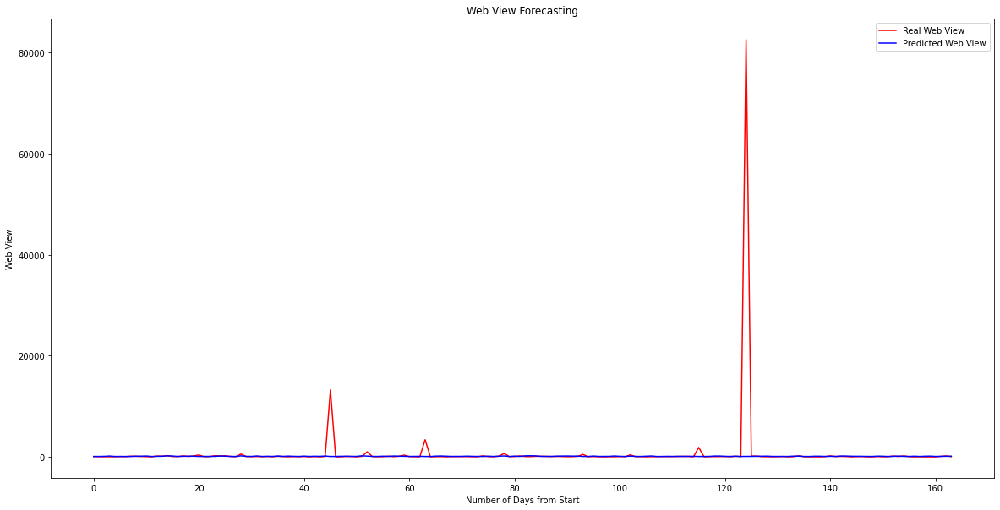

In [127]:
plt.figure(figsize=(20,10))
plt.plot(test_y_lstm,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.legend()
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.show()

#### Score for the model

In [128]:
print("Score",smape(test_y,y_pred_lstm))

Score 195.5243567895011


Now we will the above steps from splitting the data to getting scores for the remaining languages.

## Language 1

(385, 14)
(165, 14)


C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.p

Epoch 1/30

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

5/5 [==============================] - 2s 358ms/step - loss: 393.2643 - val_loss: 58.2792
Epoch 2/30
5/5 [==============================] - 1s 115ms/step - loss: 392.2444 - val_loss: 57.7577
Epoch 3/30
5/5 [==============================] - 1s 112ms/step - loss: 391.3200 - val_loss: 57.7152
Epoch 4/30
5/5 [==============================] - 1s 128ms/step - loss: 390.6013 - val_loss: 57.7399
Epoch 5/30
5/5 [==============================] - 1s 124ms/step - loss: 390.0684 - val_loss: 57.6945
Epo

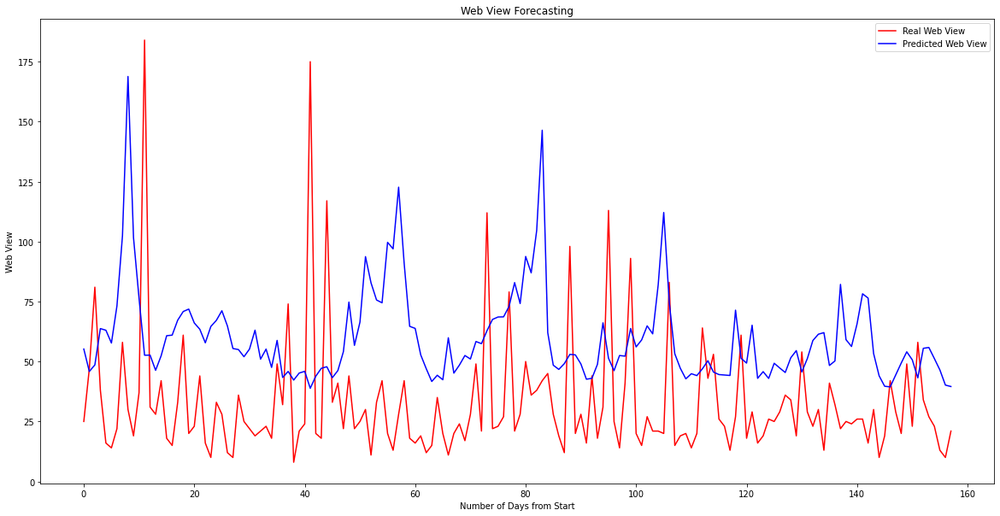

Score for the model  77.75397442563816


In [129]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(total_feat1, target1, test_size = 0.3, random_state = 0)
print(X_train.shape)
print(X_test.shape)
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])


def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

from sklearn.preprocessing import RobustScaler

for i in X_train.columns:
    
    sc=RobustScaler()
    X_train[i] = sc.fit_transform(pd.DataFrame(X_train[i]))
    X_test[i]=sc.transform(pd.DataFrame(X_test[i]))
for i in y_train.columns:
    
    sc_lang1=RobustScaler()
    y_train[i] = sc_lang1.fit_transform(pd.DataFrame(y_train[i]))
    y_test[i]=sc_lang1.transform(pd.DataFrame(y_test[i]))

    
lang=lang1
if lang=='en':
    timestep =5
elif lang=='de':
    timestep =7
elif lang=='ru':
    timestep =1
elif lang=='fr':
    timestep =6
elif lang=='es':
    timestep =7
else:
    timestep =1
train_x,train_y=create_dataset(X_train.values,y_train.values,timestep)
test_x,test_y=create_dataset(X_test.values,y_test.values,timestep)


from keras import Sequential
import keras
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Bidirectional
from keras.layers import Dense
from keras.optimizers import Adam
model1=Sequential()
model1.add(Bidirectional(
            LSTM(units=300,
                 activation='relu',
                 input_shape=(train_x.shape[0],train_x.shape[1],),
                 return_sequences=True
                )
        )
         )
         
model1.add(Dropout(0.5))
model1.add(Bidirectional(
            LSTM(units=32,
                 activation='relu',
                 
                )
        )
         )
         
#model.add(Dropout(0.8))
model1.add(Dense(1))
opt=Adam(learning_rate=0.001)
model1.compile(loss="mean_squared_error",optimizer=opt)
#print(model.summary())

history=model1.fit(train_x,train_y,epochs=30,batch_size=64,verbose=1,validation_split=0.2,shuffle=False)
y_pred_lstm=model1.predict(test_x)
test_y_lstm=sc_lang1.inverse_transform(test_y)
y_pred_lstm=sc_lang1.inverse_transform(y_pred_lstm)

plt.figure(figsize=(20,10))
plt.plot(test_y_lstm,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.legend()
plt.show()

print("Score for the model " ,smape(test_y_lstm,y_pred_lstm))

## Language 2

(385, 14)
(165, 14)


C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.p

C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pand

Epoch 1/30

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

5/5 [==============================] - 2s 391ms/step - loss: 4.2292 - val_loss: 12.6952
Epoch 2/30
5/5 [==============================] - 0s 48ms/step - loss: 4.0987 - val_loss: 12.3711
Epoch 3/30
5/5 [==============================] - ETA: 0s - loss: 4.024 - 0s 63ms/step - loss: 4.0242 - val_loss: 12.1544
Epoch 4/30
5/5 [==============================] - 0s 86ms/step - loss: 4.0075 - val_loss: 12.4513
Epoch 5/30
5/5 [==============================] - 0s 87ms/step - loss: 3.8388 - val_loss: 1

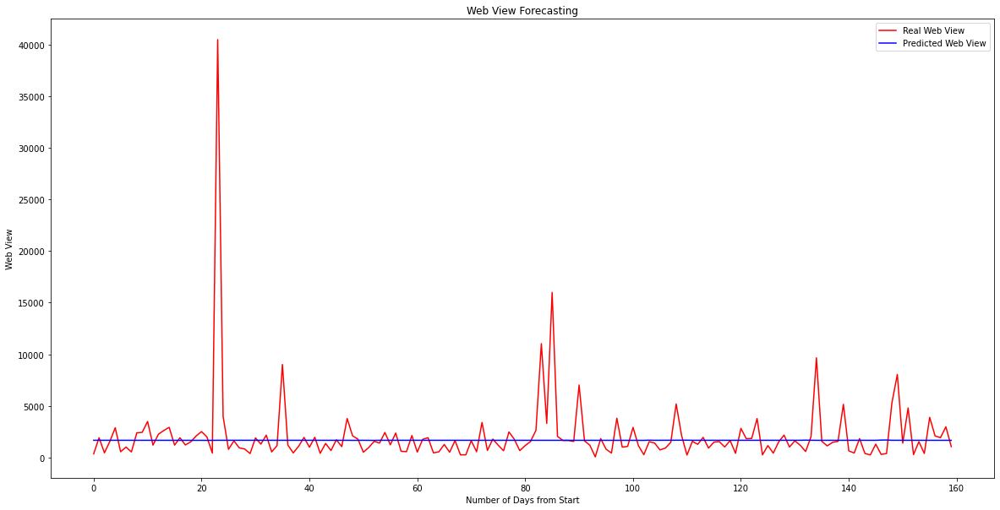

Score for the model  58.12467084125235


In [130]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(total_feat2, target2, test_size = 0.3, random_state = 0)
print(X_train.shape)
print(X_test.shape)
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])


def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

from sklearn.preprocessing import RobustScaler
for i in X_train.columns:
    
    sc=RobustScaler()
    X_train[i] = sc.fit_transform(pd.DataFrame(X_train[i]))
    X_test[i]=sc.transform(pd.DataFrame(X_test[i]))
    
for i in y_train.columns:
    sc_lang2=RobustScaler()
    y_train[i] = sc_lang2.fit_transform(pd.DataFrame(y_train[i]))
    y_test[i]=sc_lang2.transform(pd.DataFrame(y_test[i]))

lang=lang2
if lang=='en':
    timestep =5
elif lang=='de':
    timestep =7
elif lang=='ru':
    timestep =1
elif lang=='fr':
    timestep =6
elif lang=='es':
    timestep =7
else:
    timestep =1
train_x,train_y=create_dataset(X_train.values,y_train.values,timestep)
test_x,test_y=create_dataset(X_test.values,y_test.values,timestep)


from keras import Sequential
import keras
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Bidirectional
from keras.layers import Dense
from keras.optimizers import Adam
model2=Sequential()
model2.add(Bidirectional(
            LSTM(units=200,
                 activation='relu',
                 input_shape=(train_x.shape[0],train_x.shape[1],),
                 return_sequences=True
                )
        )
         )
         
model2.add(Dropout(0.8))

model2.add(Bidirectional(
            LSTM(units=32,
                 activation='relu',
                 
                )
        )
         )
         
#model.add(Dropout(0.8))
model2.add(Dense(1))
opt=Adam(learning_rate=0.01)
model2.compile(loss="mean_squared_error",optimizer=opt)
#print(model.summary())

history=model2.fit(train_x,train_y,epochs=30,batch_size=64,verbose=1,validation_split=0.2,shuffle=False)
y_pred_lstm=model2.predict(test_x)
test_y_lstm=sc_lang2.inverse_transform(test_y)
y_pred_lstm=sc_lang2.inverse_transform(y_pred_lstm)
plt.figure(figsize=(20,10))
plt.plot(test_y_lstm,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.legend()
plt.show()

print("Score for the model ",smape(test_y_lstm,y_pred_lstm))

## Language 3

(385, 14)
(165, 14)


C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.p

C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pand

Epoch 1/30

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

5/5 [==============================] - 2s 307ms/step - loss: 0.9223 - val_loss: 0.9352
Epoch 2/30
5/5 [==============================] - 0s 71ms/step - loss: 0.7059 - val_loss: 0.8905
Epoch 3/30
5/5 [==============================] - 0s 69ms/step - loss: 0.6854 - val_loss: 0.8807
Epoch 4/30
5/5 [==============================] - 0s 72ms/step - loss: 0.6705 - val_loss: 0.8662
Epoch 5/30
5/5 [==============================] - 0s 74ms/step - loss: 0.6545 - val_loss: 0.8787
Epoch 6/30
5/5 [======

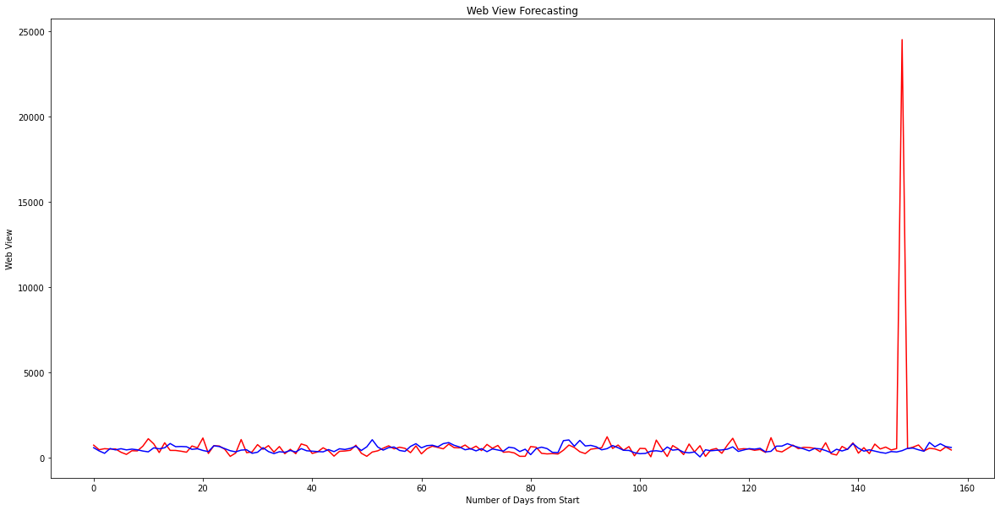

49.324367558791394


In [131]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(total_feat3, target3, test_size = 0.3, random_state = 0)
print(X_train.shape)
print(X_test.shape)
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])


def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

from sklearn.preprocessing import RobustScaler
for i in X_train.columns:
    
    sc=RobustScaler()
    X_train[i] = sc.fit_transform(pd.DataFrame(X_train[i]))
    X_test[i]=sc.transform(pd.DataFrame(X_test[i]))
    
for i in y_train.columns:
    sc_lang3=RobustScaler()
    y_train[i] = sc_lang3.fit_transform(pd.DataFrame(y_train[i]))
    y_test[i]=sc_lang3.transform(pd.DataFrame(y_test[i]))

lang=lang3
if lang=='en':
    timestep =5
elif lang=='de':
    timestep =7
elif lang=='ru':
    timestep =1
elif lang=='fr':
    timestep =6
elif lang=='es':
    timestep =7
else:
    timestep =1
train_x,train_y=create_dataset(X_train.values,y_train.values,timestep)
test_x,test_y=create_dataset(X_test.values,y_test.values,timestep)


from keras import Sequential
import keras
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Bidirectional
from keras.layers import Dense
from keras.optimizers import Adam
model3=Sequential()
model3.add(Bidirectional(
            LSTM(units=200,
                 activation='relu',
                 input_shape=(train_x.shape[0],train_x.shape[1],),
                 return_sequences=True
                )
        )
         )
         
model3.add(Dropout(0.2))

model3.add(Bidirectional(
            LSTM(units=64,
                 activation='relu',
                 
                )
        )
         )
         
#model.add(Dropout(0.8))
model3.add(Dense(1))
opt=Adam(learning_rate=0.01)
model3.compile(loss="mean_squared_error",optimizer=opt)
#print(model.summary())

history=model3.fit(train_x,train_y,epochs=30,batch_size=64,verbose=1,validation_split=0.2,shuffle=False)
'''
if lang=='en':
    model=model2
elif lang=='de':
    model =model1
elif lang=='ru':
    model=model6
elif lang=='fr':
    model = model4
elif lang=='es':
    model =model3
else:
    model=model5
'''
y_pred_lstm=model3.predict(test_x)
test_y_lstm=sc_lang3.inverse_transform(test_y)
y_pred_lstm=sc_lang3.inverse_transform(y_pred_lstm)
plt.figure(figsize=(20,10))
plt.plot(test_y_lstm,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.show()

print(smape(test_y_lstm,y_pred_lstm))

## Language 4

(385, 14)
(165, 14)


C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.p

C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pand

Epoch 1/30

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

5/5 [==============================] - 2s 303ms/step - loss: 7699.4639 - val_loss: 392.8361
Epoch 2/30
5/5 [==============================] - 1s 131ms/step - loss: 7684.9751 - val_loss: 384.9754
Epoch 3/30
5/5 [==============================] - 1s 127ms/step - loss: 7655.1543 - val_loss: 379.4663
Epoch 4/30
5/5 [==============================] - 1s 132ms/step - loss: 7613.9160 - val_loss: 392.4513
Epoch 5/30
5/5 [==============================] - 1s 158ms/step - loss: 7622.1924 - val_loss: 39

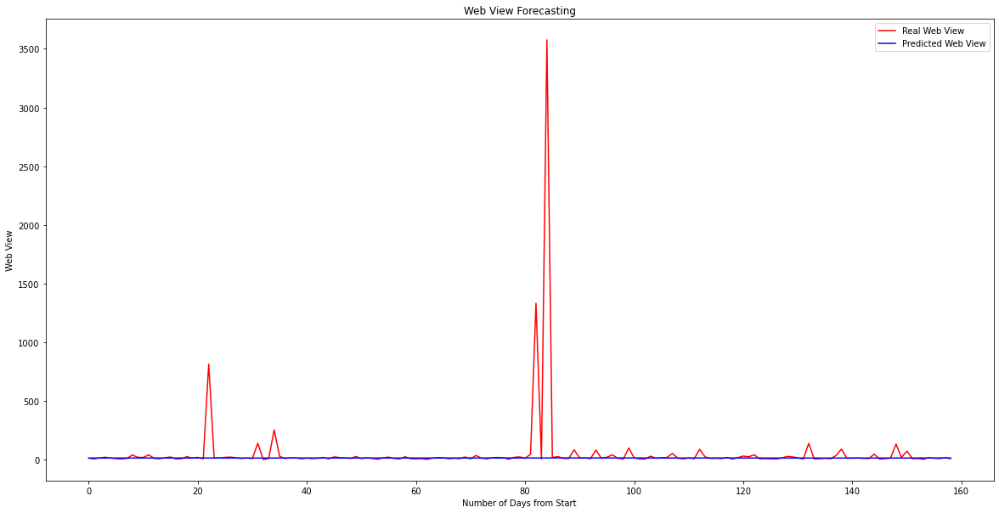

Score for the model  55.00264679429391


In [132]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(total_feat4, target4, test_size = 0.3, random_state = 0)
print(X_train.shape)
print(X_test.shape)
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])


def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

from sklearn.preprocessing import RobustScaler
for i in X_train.columns:
    
    sc=RobustScaler()
    X_train[i] = sc.fit_transform(pd.DataFrame(X_train[i]))
    X_test[i]=sc.transform(pd.DataFrame(X_test[i]))
    
for i in y_train.columns:
    sc_lang4=RobustScaler()
    y_train[i] = sc_lang4.fit_transform(pd.DataFrame(y_train[i]))
    y_test[i]=sc_lang4.transform(pd.DataFrame(y_test[i]))

lang=lang4
if lang=='en':
    timestep =5
elif lang=='de':
    timestep =7
elif lang=='ru':
    timestep =1
elif lang=='fr':
    timestep =6
elif lang=='es':
    timestep =7
else:
    timestep =1
train_x,train_y=create_dataset(X_train.values,y_train.values,timestep)
test_x,test_y=create_dataset(X_test.values,y_test.values,timestep)


from keras import Sequential
import keras
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Bidirectional
from keras.layers import Dense
from keras.optimizers import Adam
model4=Sequential()
model4.add(Bidirectional(
            LSTM(units=256,
                 activation='relu',
                 input_shape=(train_x.shape[0],train_x.shape[1],),
                 return_sequences=True
                )
        )
         )
         
model4.add(Dropout(0.8))

model4.add(Bidirectional(
            LSTM(units=128,
                 activation='relu',
                 
                )
        )
         )
         
#model.add(Dropout(0.8))
model4.add(Dense(1))
opt=Adam(learning_rate=0.001)
model4.compile(loss="mean_squared_error",optimizer=opt)
#print(model.summary())

history=model4.fit(train_x,train_y,epochs=30,batch_size=64,verbose=1,validation_split=0.2,shuffle=False)
y_pred_lstm=model4.predict(test_x)
test_y_lstm=sc_lang4.inverse_transform(test_y)
y_pred_lstm=sc_lang4.inverse_transform(y_pred_lstm)
plt.figure(figsize=(20,10))
plt.plot(test_y_lstm,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.legend()
plt.show()

print("Score for the model ",smape(test_y_lstm,y_pred_lstm))

## Language 5

(385, 14)
(165, 14)


C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.p

C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pand

Epoch 1/30

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

5/5 [==============================] - 1s 234ms/step - loss: 3.1742 - val_loss: 1.8628
Epoch 2/30
5/5 [==============================] - 0s 41ms/step - loss: 3.0063 - val_loss: 1.8214
Epoch 3/30
5/5 [==============================] - 0s 41ms/step - loss: 3.0067 - val_loss: 1.8473
Epoch 4/30
5/5 [==============================] - 0s 41ms/step - loss: 2.9941 - val_loss: 1.8097
Epoch 5/30
5/5 [==============================] - 0s 38ms/step - loss: 2.9515 - val_loss: 1.8206
Epoch 6/30
5/5 [======

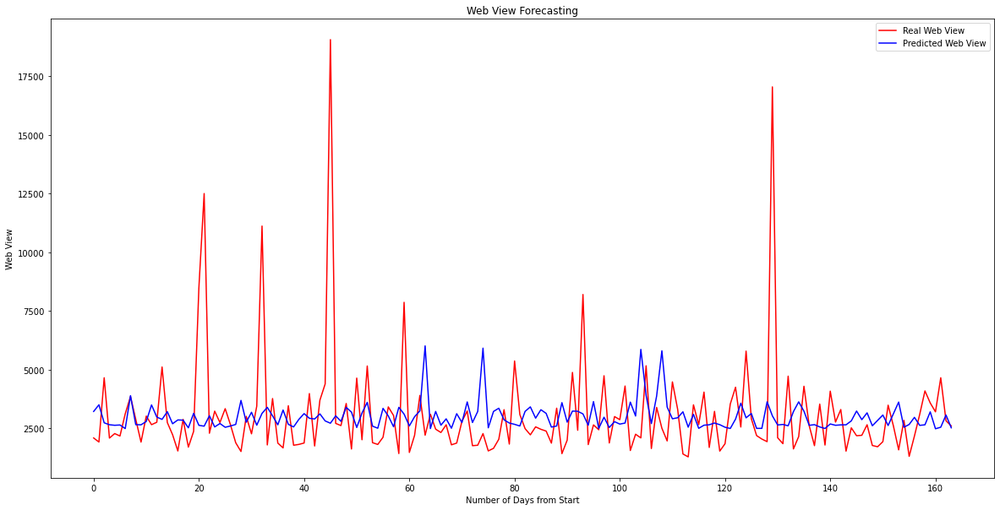

Score for the model  37.94015187794429


In [133]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(total_feat5, target5, test_size = 0.3, random_state = 0)
print(X_train.shape)
print(X_test.shape)
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])


def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

from sklearn.preprocessing import RobustScaler
for i in X_train.columns:
    
    sc=RobustScaler()
    X_train[i] = sc.fit_transform(pd.DataFrame(X_train[i]))
    X_test[i]=sc.transform(pd.DataFrame(X_test[i]))
    
for i in y_train.columns:
    sc_lang5=RobustScaler()
    y_train[i] = sc_lang5.fit_transform(pd.DataFrame(y_train[i]))
    y_test[i]=sc_lang5.transform(pd.DataFrame(y_test[i]))

lang=lang5
if lang=='en':
    timestep =5
elif lang=='de':
    timestep =7
elif lang=='ru':
    timestep =1
elif lang=='fr':
    timestep =6
elif lang=='es':
    timestep =7
else:
    timestep =1
train_x,train_y=create_dataset(X_train.values,y_train.values,timestep)
test_x,test_y=create_dataset(X_test.values,y_test.values,timestep)


from keras import Sequential
import keras
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Bidirectional
from keras.layers import Dense
from keras.optimizers import Adam
model5=Sequential()
model5.add(Bidirectional(
            LSTM(units=256,
                 activation='relu',
                 input_shape=(train_x.shape[0],train_x.shape[1],),
                 return_sequences=True
                )
        )
         )
         
model5.add(Dropout(0.2))

model5.add(Bidirectional(
            LSTM(units=128,
                 activation='relu',
                 
                )
        )
         )
         
#model.add(Dropout(0.8))
model5.add(Dense(1))
opt=Adam(learning_rate=0.01)
model5.compile(loss="mean_squared_error",optimizer=opt)
#print(model.summary())

history=model5.fit(train_x,train_y,epochs=30,batch_size=64,verbose=1,validation_split=0.2,shuffle=False)
y_pred_lstm=model5.predict(test_x)
test_y_lstm=sc_lang5.inverse_transform(test_y)
y_pred_lstm=sc_lang5.inverse_transform(y_pred_lstm)
plt.figure(figsize=(20,10))
plt.plot(test_y_lstm,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.legend()
plt.show()

print("Score for the model ",smape(test_y_lstm,y_pred_lstm))

## Testing on some Random Page 

In [134]:
# Selecting a random page to create page specific features
index=random.randint(0,train.shape[0])
print("Index No ",index )
page=train.loc[index]['Page']
# Selecting a set of dates for which we will predict
dates=train.iloc[0,450:500].index
target = pd.DataFrame(inp_train.loc[inp_train['Page']== page].iloc[0,450:500].values)
target.columns = ['Target']
target['Target']=pd.to_numeric(target6['Target'])
target

Index No  24945


,Target
0,35.0
1,32.0
2,30.0
3,30.0
4,39.0
5,37.0
6,20.0
7,19.0
8,26.0
9,41.0


#### Feature Development for test data

In [135]:
datelist=[]
for i in dates:
    datelist.append(datetime.strptime(i, '%Y-%m-%d'))


In [136]:
'''
Weekday is calculated using datelist ,weekend is calculated as 1 for weekend days and 0 
for weekdays.
Month is also calculated from datelist .Other features like month_start, month_end , quarter_start , quarter_end etc 
are created using this datelist.
'''
weekday_test=[]
for i in datelist:
    weekday_test.append(i.weekday())
weekday_test=pd.Series(weekday_test)

month_test=[]
for i in datelist:
    month_test.append(i.month)
month_test=pd.Series(month_test)

month_start_test=[]
month_start_test=pd.Series(datelist).dt.is_month_start

month_end_test=[]
month_end_test=pd.Series(datelist).dt.is_month_end

quarter_start_test=[]
quarter_start_test=pd.Series(datelist).dt.is_quarter_start

quarter_end_test=[]
quarter_end_test=pd.Series(datelist).dt.is_quarter_end

week_test=[]
week_test=pd.Series(datelist).dt.week


quarter_test=[]
quarter_test=pd.Series(datelist).dt.quarter


days_in_month_test=[]
days_in_month_test =pd.Series(datelist).dt.days_in_month

year_test=[]
year_test=pd.Series(datelist).dt.year


'''
weekday has been calculated from the datelist 
is_sunday_or_monday feature is created from weekday feature . if weekday is 0 or 6 then its value will be 1 else 0  
'''
is_sunday_or_monday_test=[]
for i in weekday_test:
    if i == 0 or i == 6:
        is_sunday_or_monday_test.append(1)
    else:
        is_sunday_or_monday_test.append(0)
is_sunday_or_monday_test=pd.Series(is_sunday_or_monday_test)


'''
month is created from datelist and is_august is created from the month number
year_half feature is created from month number , first 6 months is 1 and second 6 months is 2.
'''
is_august_test=[]
for i in month_test:
    if i == 8:
        is_august_test.append(1)
    else:
        is_august_test.append(0)
is_august_test=pd.Series(is_august_test)

year_half_test=[]
for i in month_test:
    if i in [1,2,3,4,5,6] :
        year_half_test.append(1)
    else :
        year_half_test.append(2)
year_half_test=pd.Series(year_half_test)

### The above features are irrespective of the page , I will call them global features
global_feat=pd.DataFrame()
global_feat=pd.concat([weekday_test,is_sunday_or_monday_test,month_test,is_august_test,year_half_test,quarter_test,quarter_start_test,quarter_end_test,month_start_test,month_end_test,days_in_month_test,week_test],axis=1)
global_feat.columns=['weekday','is_sunday_or_monday','month','is_august','year_half','quarter','quarter_start','quarter_end','month_start','month_end','days_in_month','week']
global_feat.shape

(50, 12)

In [137]:
lang=eda_train_imp.loc[eda_train_imp['Page']==page]['Lang'].values
agent_index=re.search('spider',page)
if agent_index == 1:
    spider=[1]*(target.shape[0])
    non_spider=[0]*(target.shape[0])
else:
    spider=[0]*(target.shape[0])
    non_spider=[1]*(target.shape[0])
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)

In [138]:
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']
page_specific_feat

,spider,non_spider
0,0,1
1,0,1
2,0,1
3,0,1
4,0,1
5,0,1
6,0,1
7,0,1
8,0,1
9,0,1


In [139]:
total_feat=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat.head()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider
0,3,0,9,0,2,3,False,False,False,False,30,38,0,1
1,4,0,9,0,2,3,False,False,False,False,30,38,0,1
2,5,0,9,0,2,3,False,False,False,False,30,38,0,1
3,6,1,9,0,2,3,False,False,False,False,30,38,0,1
4,0,1,9,0,2,3,False,False,False,False,30,39,0,1


#### Encoding of categorical values ,standarization and data creation with timestep

In [140]:
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
total_feat['month_start']=le1.fit_transform(total_feat['month_start'])


le2=LabelEncoder()
total_feat['month_end']=le2.fit_transform(total_feat['month_end'])


le3=LabelEncoder()
total_feat['quarter_start']=le3.fit_transform(total_feat['quarter_start'])


le4=LabelEncoder()
total_feat['quarter_end']=le4.fit_transform(total_feat['quarter_end'])



def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

from sklearn.preprocessing import RobustScaler
for i in total_feat.columns:
    
    sc=RobustScaler()
    total_feat[i] = sc.fit_transform(pd.DataFrame(total_feat[i]))
    
for i in target.columns:
    sc_y=RobustScaler()
    target[i] = sc_y.fit_transform(pd.DataFrame(target[i]))

if lang=='en':
    timestep =5
elif lang=='de':
    timestep =7
elif lang=='ru':
    timestep =1
elif lang=='fr':
    timestep =6
elif lang=='es':
    timestep =7
else:
    timestep =1
test_x,test_y=create_dataset(total_feat.values,target.values,timestep)



#### Testing with desired model 

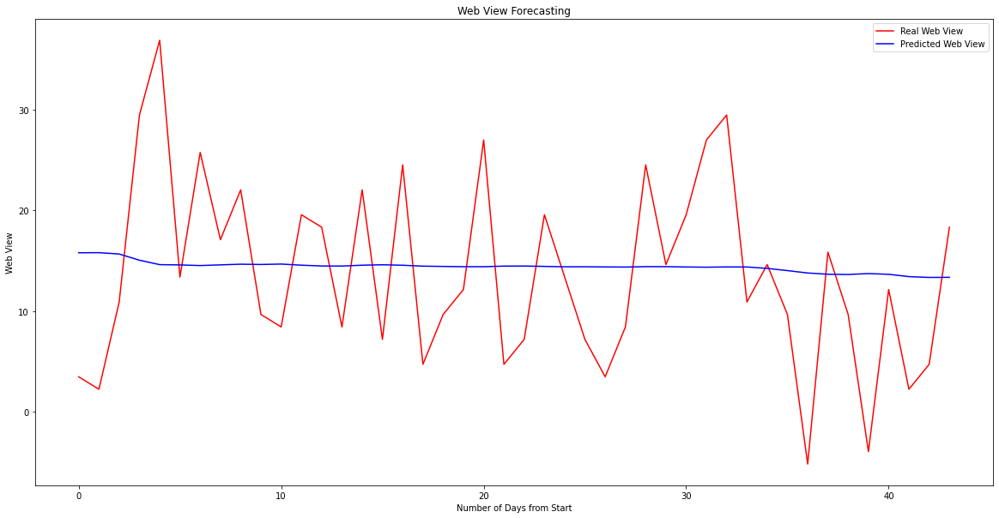

Score  59.64357479978056


In [141]:
if lang=='en':
    model=model2
    sc_y=sc_lang2
elif lang=='de':
    model =model1
    sc_y=sc_lang1
elif lang=='ru':
    model=model6
    sc_y=sc_lang6
elif lang=='fr':
    model = model4
    sc_y=sc_lang4
elif lang=='es':
    model =model3
    sc_y=sc_lang3
else:
    model=model5
    sc_y=sc_lang5

y_pred_lstm=model.predict(test_x)
test_y_lstm=sc_y.inverse_transform(test_y)
y_pred_lstm=sc_y.inverse_transform(y_pred_lstm)
plt.figure(figsize=(20,10))
plt.plot(test_y_lstm,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.legend()
plt.show()

print("Score ",smape(test_y_lstm,y_pred_lstm))

In [142]:
from datetime import date , timedelta
sdate = date(2017,1,1)   # start date
edate = date(2017,3,10)   # end date
actual_edate=date(2017,3,1)
delta = actual_edate-sdate
days= delta.days
test_date=pd.date_range(sdate,edate-timedelta(days=1),freq='d')
print(days)

59


In [143]:
def global_feat(datelist):
   
    weekday_test=[]
    for i in datelist:
        weekday_test.append(i.weekday())
    weekday_test=pd.Series(weekday_test)

    month_test=[]
    for i in datelist:
        month_test.append(i.month)
    month_test=pd.Series(month_test)

    month_start_test=[]
    month_start_test=pd.Series(datelist).dt.is_month_start

    month_end_test=[]
    month_end_test=pd.Series(datelist).dt.is_month_end

    quarter_start_test=[]
    quarter_start_test=pd.Series(datelist).dt.is_quarter_start

    quarter_end_test=[]
    quarter_end_test=pd.Series(datelist).dt.is_quarter_end

    week_test=[]
    week_test=pd.Series(datelist).dt.week


    quarter_test=[]
    quarter_test=pd.Series(datelist).dt.quarter


    days_in_month_test=[]
    days_in_month_test =pd.Series(datelist).dt.days_in_month

    year_test=[]
    year_test=pd.Series(datelist).dt.year


    is_sunday_or_monday_test=[]
    for i in weekday_test:
        if i == 0 or i == 6:
            is_sunday_or_monday_test.append(1)
        else:
            is_sunday_or_monday_test.append(0)
    is_sunday_or_monday_test=pd.Series(is_sunday_or_monday_test)


    is_august_test=[]
    for i in month_test:
        if i == 8:
            is_august_test.append(1)
        else:
            is_august_test.append(0)
    is_august_test=pd.Series(is_august_test)

    year_half_test=[]
    for i in month_test:
        if i in [1,2,3,4,5,6] :
            year_half_test.append(1)
        else :
            year_half_test.append(2)
    year_half_test=pd.Series(year_half_test)

### The above features are irrespective of the page , I will call them global features
    global_feat=pd.DataFrame()
    global_feat=pd.concat([weekday_test,is_sunday_or_monday_test,month_test,is_august_test,year_half_test,quarter_test,quarter_start_test,quarter_end_test,month_start_test,month_end_test,days_in_month_test,week_test],axis=1)
    global_feat.columns=['weekday','is_sunday_or_monday','month','is_august','year_half','quarter','quarter_start','quarter_end','month_start','month_end','days_in_month','week']
    return global_feat

In [144]:
global_feat_test=global_feat(test_date)
global_feat_test

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week
0,6,1,1,0,1,1,True,False,True,False,31,52
1,0,1,1,0,1,1,False,False,False,False,31,1
2,1,0,1,0,1,1,False,False,False,False,31,1
3,2,0,1,0,1,1,False,False,False,False,31,1
4,3,0,1,0,1,1,False,False,False,False,31,1
...,...,...,...,...,...,...,...,...,...,...,...,...
63,6,1,3,0,1,1,False,False,False,False,31,9
64,0,1,3,0,1,1,False,False,False,False,31,10
65,1,0,3,0,1,1,False,False,False,False,31,10
66,2,0,3,0,1,1,False,False,False,False,31,10


In [145]:
key_data=pd.read_csv('key_1.csv')
key_data.head()

,Page,Id
0,!vote_en.wikipedia.org_all-access_all-agents_2...,bf4edcf969af
1,!vote_en.wikipedia.org_all-access_all-agents_2...,929ed2bf52b9
2,!vote_en.wikipedia.org_all-access_all-agents_2...,ff29d0f51d5c
3,!vote_en.wikipedia.org_all-access_all-agents_2...,e98873359be6
4,!vote_en.wikipedia.org_all-access_all-agents_2...,fa012434263a


In [146]:
key_data['Page_name']=key_data.apply(lambda x : x['Page'][0:-11],axis=1 )
key_data

,Page,Id,Page_name
0,!vote_en.wikipedia.org_all-access_all-agents_2...,bf4edcf969af,!vote_en.wikipedia.org_all-access_all-agents
1,!vote_en.wikipedia.org_all-access_all-agents_2...,929ed2bf52b9,!vote_en.wikipedia.org_all-access_all-agents
2,!vote_en.wikipedia.org_all-access_all-agents_2...,ff29d0f51d5c,!vote_en.wikipedia.org_all-access_all-agents
3,!vote_en.wikipedia.org_all-access_all-agents_2...,e98873359be6,!vote_en.wikipedia.org_all-access_all-agents
4,!vote_en.wikipedia.org_all-access_all-agents_2...,fa012434263a,!vote_en.wikipedia.org_all-access_all-agents
...,...,...,...
8703775,龙生九子_zh.wikipedia.org_mobile-web_all-agents_20...,f69747f5ee68,龙生九子_zh.wikipedia.org_mobile-web_all-agents
8703776,龙生九子_zh.wikipedia.org_mobile-web_all-agents_20...,2489963dc503,龙生九子_zh.wikipedia.org_mobile-web_all-agents
8703777,龙生九子_zh.wikipedia.org_mobile-web_all-agents_20...,b0624c909f4c,龙生九子_zh.wikipedia.org_mobile-web_all-agents
8703778,龙生九子_zh.wikipedia.org_mobile-web_all-agents_20...,24a1dfb06c10,龙生九子_zh.wikipedia.org_mobile-web_all-agents


In [147]:
key_data['Date']=key_data.apply(lambda x : x['Page'][-10:],axis=1 )
key_data

,Page,Id,Page_name,Date
0,!vote_en.wikipedia.org_all-access_all-agents_2...,bf4edcf969af,!vote_en.wikipedia.org_all-access_all-agents,2017-01-01
1,!vote_en.wikipedia.org_all-access_all-agents_2...,929ed2bf52b9,!vote_en.wikipedia.org_all-access_all-agents,2017-01-02
2,!vote_en.wikipedia.org_all-access_all-agents_2...,ff29d0f51d5c,!vote_en.wikipedia.org_all-access_all-agents,2017-01-03
3,!vote_en.wikipedia.org_all-access_all-agents_2...,e98873359be6,!vote_en.wikipedia.org_all-access_all-agents,2017-01-04
4,!vote_en.wikipedia.org_all-access_all-agents_2...,fa012434263a,!vote_en.wikipedia.org_all-access_all-agents,2017-01-05
...,...,...,...,...
8703775,龙生九子_zh.wikipedia.org_mobile-web_all-agents_20...,f69747f5ee68,龙生九子_zh.wikipedia.org_mobile-web_all-agents,2017-02-25
8703776,龙生九子_zh.wikipedia.org_mobile-web_all-agents_20...,2489963dc503,龙生九子_zh.wikipedia.org_mobile-web_all-agents,2017-02-26
8703777,龙生九子_zh.wikipedia.org_mobile-web_all-agents_20...,b0624c909f4c,龙生九子_zh.wikipedia.org_mobile-web_all-agents,2017-02-27
8703778,龙生九子_zh.wikipedia.org_mobile-web_all-agents_20...,24a1dfb06c10,龙生九子_zh.wikipedia.org_mobile-web_all-agents,2017-02-28


In [148]:
key_data_new=key_data.drop(['Page'],axis=1)

In [149]:
pagelist=key_data_new['Page_name'].unique()

In [150]:
def total_feat_create(page,global_feat):
    agent_index=re.search('spider',page)
    if agent_index == 1:
        spider=[1]*(global_feat.shape[0])
        non_spider=[0]*(global_feat.shape[0])
    else:
        spider=[0]*(global_feat.shape[0])
        non_spider=[1]*(global_feat.shape[0])
    spider=pd.Series(spider)
    non_spider=pd.Series(non_spider)
    page_specific_feat=pd.DataFrame()
    page_specific_feat=pd.concat([spider,non_spider],axis=1)
    page_specific_feat.columns=['spider','non_spider']
    total_feat=pd.concat([global_feat,page_specific_feat],axis=1)
    return total_feat 

In [151]:
def testing(page,global_feat,days):
    total_feat=pd.DataFrame()
    total_feat=total_feat_create(page,global_feat)
    index=re.search('[a-z][a-z].wikipedia.org',page)
   
    if(index):
        lang=index[0][0:2]
    else:
        lang='na'
        
    from sklearn.preprocessing import LabelEncoder
    le1=LabelEncoder()
    total_feat['month_start']=le1.fit_transform(total_feat['month_start'])


    le2=LabelEncoder()
    total_feat['month_end']=le2.fit_transform(total_feat['month_end'])


    le3=LabelEncoder()
    total_feat['quarter_start']=le3.fit_transform(total_feat['quarter_start'])


    le4=LabelEncoder()
    total_feat['quarter_end']=le4.fit_transform(total_feat['quarter_end'])



    def create_test_dataset(X,timestep=1):
        Xs=[]
        for i in range(len(X)):
            end_ix=i+timestep
            if end_ix > X.shape[0]:
                break
            
            v=X[i:end_ix]
            Xs.append(v)
            
        return np.array(Xs)

    from sklearn.preprocessing import RobustScaler
    for i in total_feat.columns:
    
        sc=RobustScaler()
        total_feat[i] = sc.fit_transform(pd.DataFrame(total_feat[i]))
        
    
    if lang=='en':
        timestep =5
    elif lang=='de':
        timestep =7
    elif lang=='ru':
        timestep =1
    elif lang=='fr':
        timestep =6
    elif lang=='es':
        timestep =7
    else:
        timestep =1
    test_x=create_test_dataset(total_feat.values,timestep)
    print(test_x.shape)
    if lang=='en':
        model=model2
        sc_y=sc_lang2
    elif lang=='de':
        model =model1
        sc_y=sc_lang1
    elif lang=='ru':
        model=model6
        sc_y=sc_lang6
    elif lang=='fr':
        model = model4
        sc_y=sc_lang4
    elif lang=='es':
        model =model3
        sc_y=sc_lang3
    else:
        model=model5
        sc_y=sc_lang5

    y_pred_lstm=model.predict(test_x)
    y_pred_lstm=y_pred_lstm[0:days]
    y_pred_lstm=sc_y.inverse_transform(y_pred_lstm)
    y_pred_lstm=pd.DataFrame(y_pred_lstm)
    print(y_pred_lstm.shape)
    y_pred_lstm['Page']=page
    return y_pred_lstm

In [152]:
final_df=pd.DataFrame()
#for i in pagelist[0]:
preddf=testing(pagelist[0],global_feat_test,days)
final_df=pd.concat([final_df,preddf],ignore_index=True)
final_df

(64, 5, 14)
(59, 1)


,0,Page
0,1636.367188,!vote_en.wikipedia.org_all-access_all-agents
1,1673.351318,!vote_en.wikipedia.org_all-access_all-agents
2,1674.613892,!vote_en.wikipedia.org_all-access_all-agents
3,1672.778564,!vote_en.wikipedia.org_all-access_all-agents
4,1672.976685,!vote_en.wikipedia.org_all-access_all-agents
5,1673.827026,!vote_en.wikipedia.org_all-access_all-agents
6,1673.532227,!vote_en.wikipedia.org_all-access_all-agents
7,1669.437988,!vote_en.wikipedia.org_all-access_all-agents
8,1673.319092,!vote_en.wikipedia.org_all-access_all-agents
9,1674.571655,!vote_en.wikipedia.org_all-access_all-agents


In [155]:
len(pagelist)

145063

In [154]:
[page]*(global_feat_test.shape[0]-1)

['One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-agents',
 'One_Piece_fr.wikipedia.org_all-access_all-ag